In [13]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn import model_selection, preprocessing, compose, pipeline, \
linear_model, impute, metrics, svm, tree, neighbors, ensemble, dummy
import scipy.stats  as stats
from IPython.display import display, Markdown
plt.style.use('default')
pd.options.display.max_columns = None

In [14]:
def HyperP(Nom, Pipe): # sort les graphiques pour évaluer les hyper paramètres et le temps de traitement
    if Nom!='Linear Regression':
        Param=pd.DataFrame.from_dict(Pipe[1].cv_results_['params']) #DF avec les paramètres
        Score=pd.DataFrame.from_dict(Pipe[1].cv_results_['mean_test_score']) # DF avec les mean test score
        Duree=pd.DataFrame.from_dict(Pipe[1].cv_results_['mean_fit_time']) # DF avec les temps de traitement
        CvRes=[]
        NCol=[]
        for m in range(CrVa):  # récupère les résultats des tests de chaque CV
            NomSp='split{}_test_score'.format(m)
            CvRes.append(Pipe[1].cv_results_[NomSp])
            NCol.append(NomSp)
        DfCv=pd.DataFrame(CvRes).T
        DfCv.columns=NCol
        Score.columns=['MeanTestScore']
        Duree.columns=['MeanFitTime']
        DfRes=Param.join(Score)
        DfRes=DfRes.join(Duree)
        DfRes=DfRes.join(DfCv)
        if len(Param.columns)==1:             # pour les modèles avec un seul hyperparamètre
            DfRes2=DfRes.set_index(DfRes.columns[0])
            plt.subplots(2,1,figsize=[9,6])  
            plt.suptitle('Label : {}  Estimateur : {} Hyper-paramètre : {} '.format(label, Nom, Param.columns[0]), y=1.1)
            plt.subplot(2,1,1)         # le boxplot avec les R2 de chaque CV par hyper parametre
            sns.boxplot(data=DfRes2.iloc[:,-5:].T, fliersize=0)
            sns.stripplot(data=DfRes2.iloc[:,-5:].T, linewidth=1)
            plt.title("{} : Distribution du R2 sur {} CV \nen fonction de l'hyper-paramètre {}".\
                      format(Nom,CrVa,Param.columns[0]))
            plt.ylabel('R2')
            plt.subplot(2,1,2)     # le barplot avec le temps de traitement moyen 
            plt.bar(np.arange(0,len(DfRes),1),DfRes['MeanFitTime'])
            plt.xticks(np.arange(0,len(DfRes),1),DfRes[DfRes.columns[0]])
            plt.ylabel('Sec')
            plt.xlabel(DfRes.columns[0])
            plt.title('{} : Temps de traitement'.format(Nom))
            plt.ylabel('Mean Fit Time (sec)')      
            plt.tight_layout()
            plt.show()
        if len(Param.columns)==2:             # pour les modèles à 2 hyper paramètres
            plt.subplots(2,1, sharex=True, figsize=[9,6])  #15-8
            plt.suptitle('Label : {} Estimateur : {} Hyper-paramètres : {} ,{} '.format(label,Nom,\
            Param.columns[0],Param.columns[1]),y=1.1)
            plt.subplot(211)            # le boxplot avec les R2 de chaque CV par hyper parametre
            DfM=pd.melt(DfRes, id_vars=[DfRes.columns[0],DfRes.columns[1],'MeanTestScore','MeanFitTime'])
            sns.boxplot(data=DfM, x=DfM.columns[1], y='value', hue=DfM.columns[0], fliersize=0)
            sns.stripplot(data=DfM, x=DfM.columns[1], y='value', hue=DfM.columns[0], dodge=True, linewidth=1)
            plt.title("{} : Performance du modèle (R2) en fonction des hyper-paramètres {} et {}".\
                          format(Nom,Param.columns[0],Param.columns[1] ))
            plt.subplot(212)      # le barplot avec le temps de traitement moyen 
            DfM=DfRes.copy()
            DfM[DfM.columns[0]+" / "+DfM.columns[1]]=\
            DfM[DfM.columns[0]].astype('str')+" / "+DfM[DfM.columns[1]].astype('str')
            plt.bar(np.arange(0,len(DfM),1),DfM['MeanFitTime'])
            plt.xticks(np.arange(0,len(DfM),1),DfM[DfM.columns[-1]], rotation=90)
            plt.xlabel(DfM.columns[-1])    
            plt.ylabel("sec")
            plt.title('{} : Temps de traitement'.format(Nom))
            plt.tight_layout()
            plt.show()
        print('Meilleur(s) hyper-parametre(s) : {}'.format(Pipe[1].best_params_))            

In [15]:
def evaluation (y_test,y_pred, titre,co):  #pour les 4 graphs d'analyse des résidus
    fig, (ax1,ax2, ax3, ax4)=plt.subplots(nrows=1,ncols=4,figsize=[12,3])
    fig.suptitle('{} : Erreurs de prédiction vs valeurs réelles'.format(titre), y=1.1)
    ax1.scatter(y_test,y_pred, alpha=0.2, color=co)
    ax1.plot(y_test,y_test, color='k')
    ax1.set_xlabel('valeurs réelles')
    ax1.set_ylabel('valeurs prédites')
    ax2.scatter(y_test,(y_pred-y_test), alpha=0.2, color=co)
    ax2.plot([min(y_test),max(y_test)],[0,0], color='k')
    ax2.set_xlabel('valeurs réelles')
    ax2.set_ylabel('erreurs de prédiction')
    sns.distplot(y_pred-y_test,kde=True, ax=ax3)
    ax3.set_xlabel('erreurs de prédiction')
    ax3.set_ylabel('fréquence')
    stats.probplot(y_pred-y_test, dist='norm', plot=ax4)
    ax4.set_xlabel('quantiles théoriques')
    ax4.set_ylabel('erreurs de prédiction')
    ax4.set_title('')
    plt.tight_layout()
    plt.show()

In [16]:
data2016=pd.read_csv('C://Users//hp//Documents//openclassrooms//projet4//2016final.csv', index_col=0)
# il s'agit du fichier enregistré à la fin du notebook d'analyse exploratoire

_______

In [17]:
datafinal=data2016.copy()

In [18]:
CPrUsTy=datafinal.columns[datafinal.columns.str.contains('PrUsTy')]
CPrUsTy #Colonnes PropertyUseTypes créées manuellement

Index([], dtype='object')

In [19]:
datafinalCat=datafinal.select_dtypes(exclude='number').\
columns[np.isin(datafinal.select_dtypes(exclude='number').columns,CPrUsTy, invert=True)]
datafinalCat #colonnes catégories hors CPrUsTy

Index(['BuildingType', 'PrimaryPropertyType', 'LargestPropertyUseType',
       'SecondLargestPropertyUseType', 'ThirdLargestPropertyUseType',
       'Outlier', 'IndicSteamUse', 'IndicNaturalGas', 'IndicParking',
       'typeThi', 'PrimEqualLarg'],
      dtype='object')

In [20]:
datafinalNum=datafinal.select_dtypes('number').\
columns[~datafinal.select_dtypes('number').columns.str.contains('SiteE|TotalGHG')]
datafinalNum #selection de toutes les colonnes numériques à l'exception des labels
datafinalNum

Index(['OSEBuildingID', 'YearBuilt', 'NumberofBuildings', 'NumberofFloors',
       'PropertyGFATotal', 'PropertyGFAParking', 'PropertyGFABuilding(s)',
       'LargestPropertyUseTypeGFA', 'SecondLargestPropertyUseTypeGFA',
       'ThirdLargestPropertyUseTypeGFA', 'ENERGYSTARScore',
       'NumberofMainUseType', 'NumberofAllUseType', 'SurfEtaMoy', 'SurfBatMoy',
       'SumLarSecThiGFA', 'PropBuildingsGFA'],
      dtype='object')

### Machine learning

### création des modèles

In [21]:
CrVa=5 # nombre de CV
NbTests=10 # nombre d'itérations

In [22]:
# instanciation des modèles
KNN=model_selection.GridSearchCV(neighbors.KNeighborsRegressor(), \
                                 param_grid={'n_neighbors':[3,4,5,6,7,8,9,10,11]},cv=CrVa, scoring='r2')
alphasLas = np.logspace(-4,-2,3)
alphasRid =np.logspace(-1,2,4)
Ridge= model_selection.GridSearchCV(linear_model.Ridge(), param_grid={'alpha':alphasRid},cv=CrVa, scoring='r2')
Lasso= model_selection.GridSearchCV(linear_model.Lasso(tol=0.01,max_iter=100000),\
                                    param_grid={'alpha':alphasLas},cv=CrVa,scoring='r2')
RForest= model_selection.GridSearchCV(ensemble.RandomForestRegressor(),\
param_grid={'n_estimators':[10,100,1000]},cv=CrVa, scoring='r2')
SVR= model_selection.GridSearchCV(svm.SVR(), param_grid={'C':[100,1000,10000],\
                                                         'gamma':[0.00001,0.0001,0.001]},cv=CrVa, scoring='r2')
Lin=linear_model.LinearRegression()
Modeles=[Ridge,Lasso,KNN,SVR,RForest] # utilisé pour les boucles
NomMod=['Ridge','Lasso','KNN','SVR','RForest'] # "
Couleur=['orange','blue', 'gold', 'purple','red','green'] # "
labels= ['SiteEnergyUse(kBtu)','TotalGHGEmissions'] # "
label=labels[1] # choix du label
plt.style.use('bmh')

### Selection des variables

In [23]:
#récupération des variables par type pour préparer les pipelines
ColNum=[]
ColCat=[]
ColTot=[]
ColOrd=[]
if label=='SiteEnergyUse(kBtu)':  
    CNum=datafinalNum.to_list()
    CCat=datafinalCat.to_list()+CPrUsTy.to_list()
    ColTot=CCat+CNum
elif label=='TotalGHGEmissions':
    CNum=datafinalNum.to_list()
    CCat=datafinalCat.to_list()+CPrUsTy.to_list()
    ColTot=CCat+CNum
print('Label : {}\n'.format(label))
print('Variables sélectionnées : \n\n{}'.format(ColTot))

Label : TotalGHGEmissions

Variables sélectionnées : 

['BuildingType', 'PrimaryPropertyType', 'LargestPropertyUseType', 'SecondLargestPropertyUseType', 'ThirdLargestPropertyUseType', 'Outlier', 'IndicSteamUse', 'IndicNaturalGas', 'IndicParking', 'typeThi', 'PrimEqualLarg', 'OSEBuildingID', 'YearBuilt', 'NumberofBuildings', 'NumberofFloors', 'PropertyGFATotal', 'PropertyGFAParking', 'PropertyGFABuilding(s)', 'LargestPropertyUseTypeGFA', 'SecondLargestPropertyUseTypeGFA', 'ThirdLargestPropertyUseTypeGFA', 'ENERGYSTARScore', 'NumberofMainUseType', 'NumberofAllUseType', 'SurfEtaMoy', 'SurfBatMoy', 'SumLarSecThiGFA', 'PropBuildingsGFA']


### Pipelines et boucles de tests

## TotalGHGEmissions Modèle Ridge itération n 1  



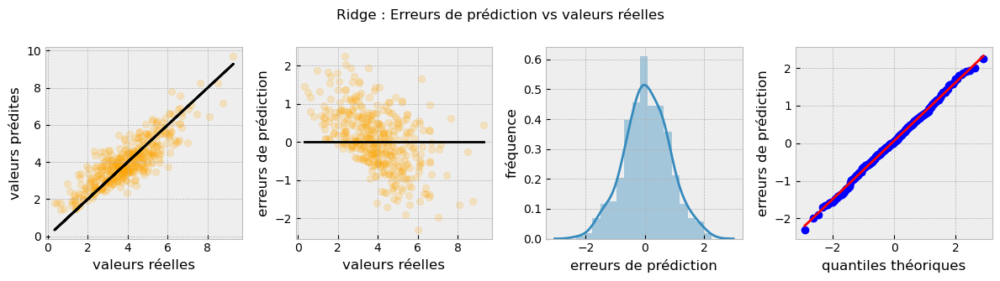

R2 : 0.723
Median absolute error : 0.51
Root mean squarred error : 0.78
Shapiro-Wilk test : 1.0  p-value : 0.87


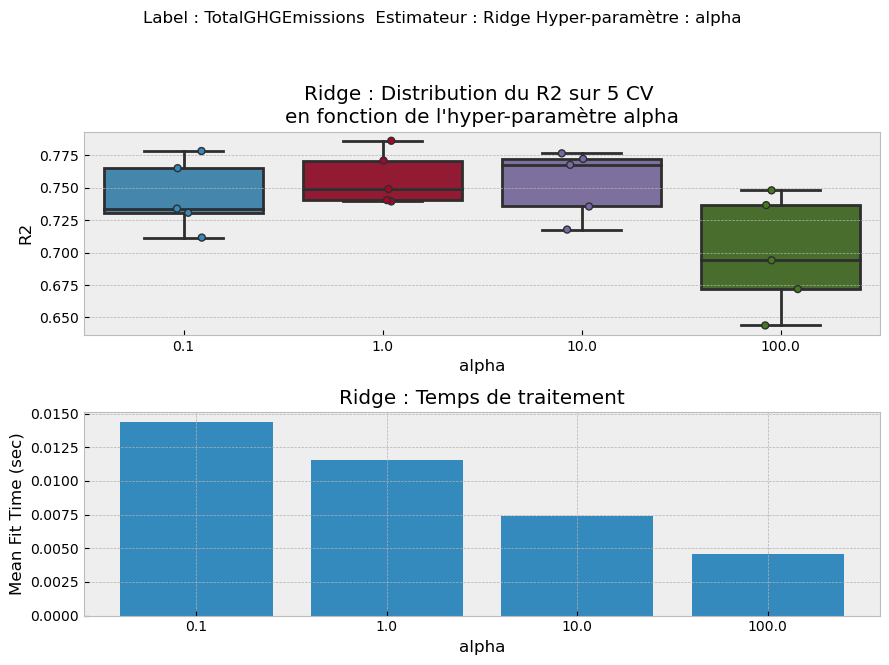

Meilleur(s) hyper-parametre(s) : {'alpha': 1.0}


## TotalGHGEmissions Modèle Lasso itération n 1  



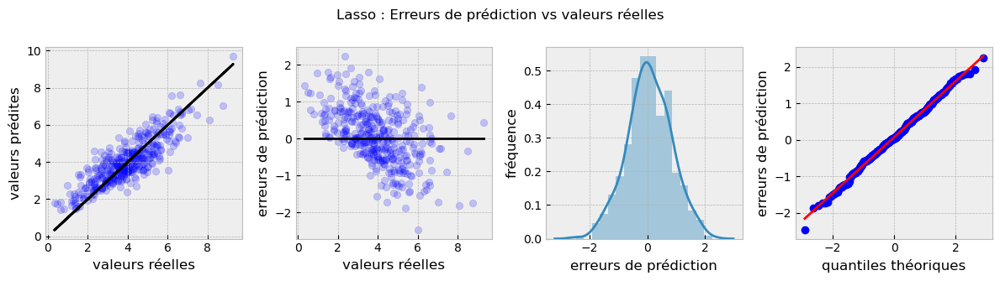

R2 : 0.73
Median absolute error : 0.5
Root mean squarred error : 0.77
Shapiro-Wilk test : 1.0  p-value : 0.8


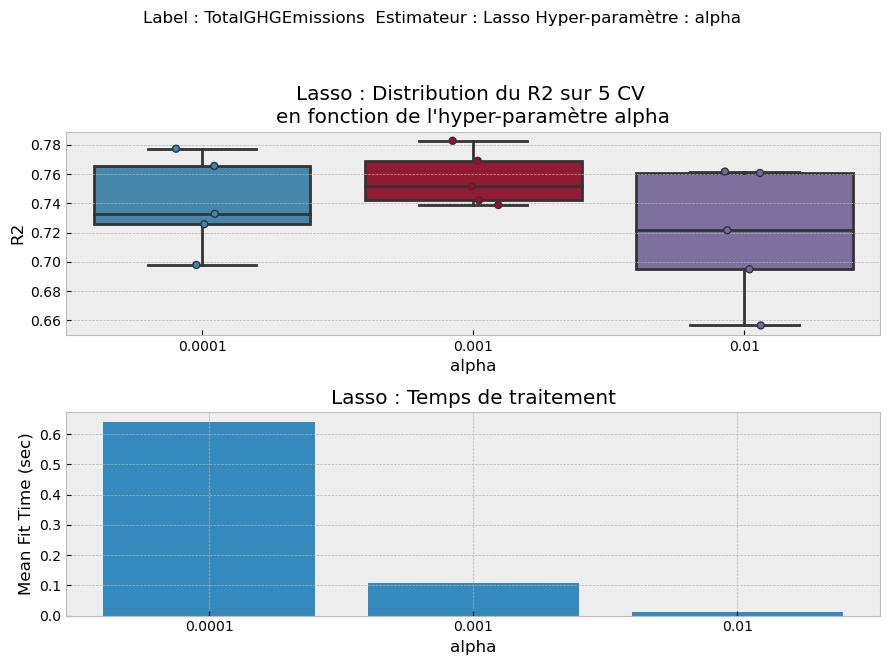

Meilleur(s) hyper-parametre(s) : {'alpha': 0.001}


## TotalGHGEmissions Modèle KNN itération n 1  



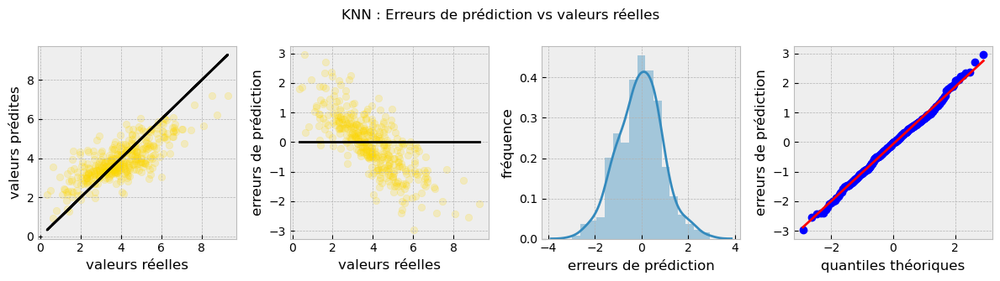

R2 : 0.572
Median absolute error : 0.59
Root mean squarred error : 0.96
Shapiro-Wilk test : 1.0  p-value : 0.54


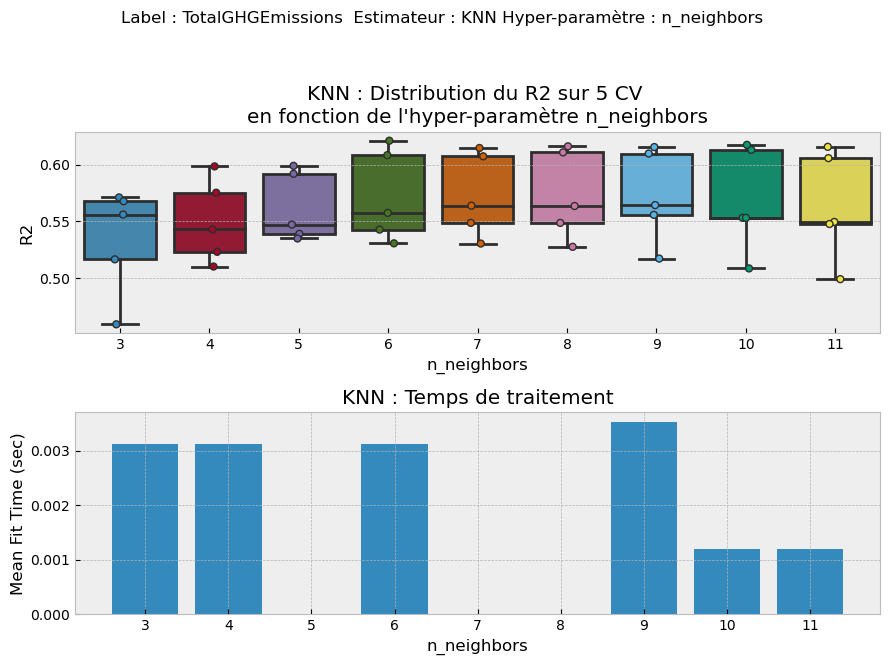

Meilleur(s) hyper-parametre(s) : {'n_neighbors': 8}


## TotalGHGEmissions Modèle SVR itération n 1  



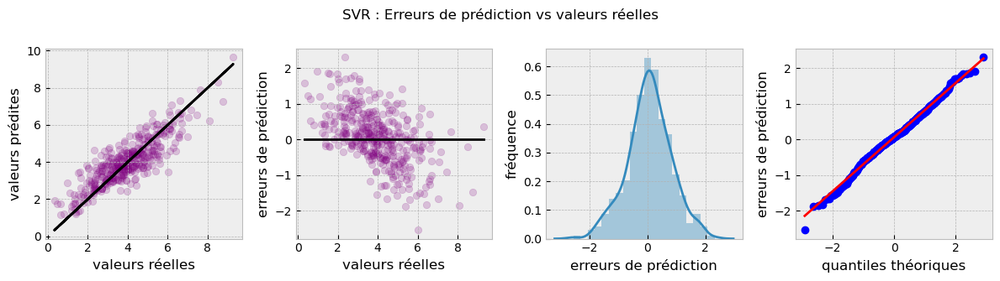

R2 : 0.734
Median absolute error : 0.46
Root mean squarred error : 0.76
Shapiro-Wilk test : 0.99  p-value : 0.18


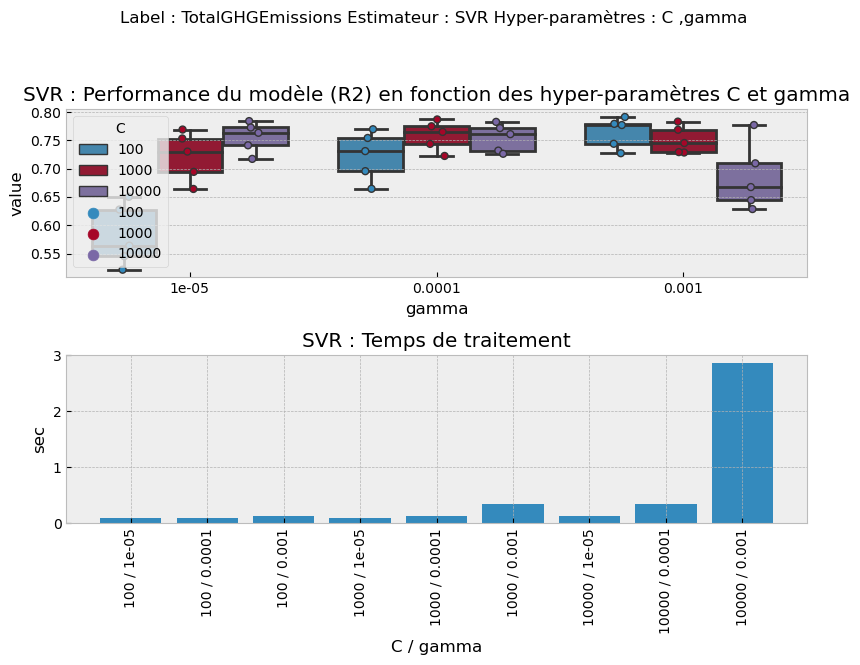

Meilleur(s) hyper-parametre(s) : {'C': 100, 'gamma': 0.001}


## TotalGHGEmissions Modèle RForest itération n 1  



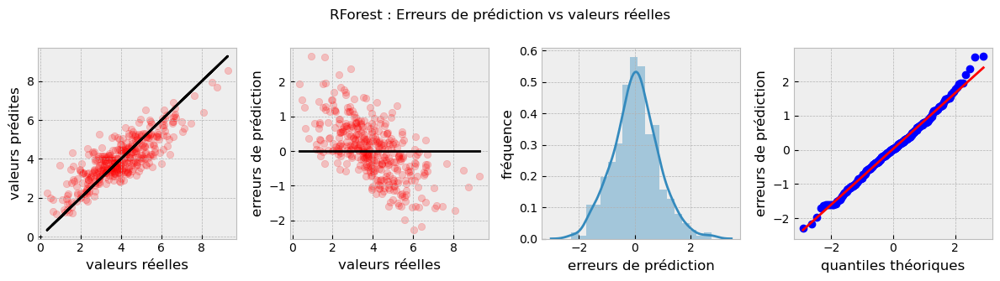

R2 : 0.695
Median absolute error : 0.5
Root mean squarred error : 0.81
Shapiro-Wilk test : 0.99  p-value : 0.18


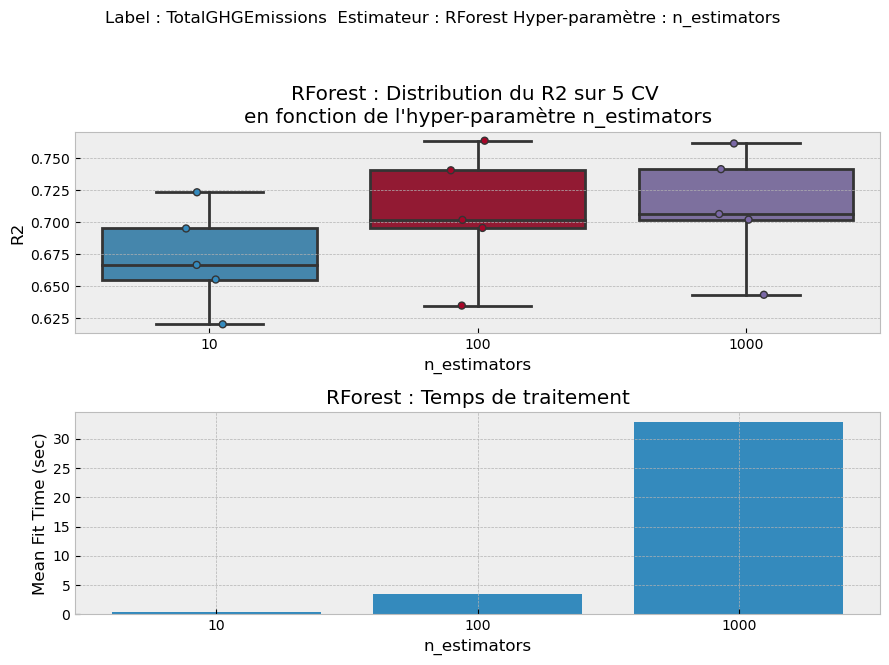

Meilleur(s) hyper-parametre(s) : {'n_estimators': 1000}


## TotalGHGEmissions Modèle Linear Regression itération n 1  



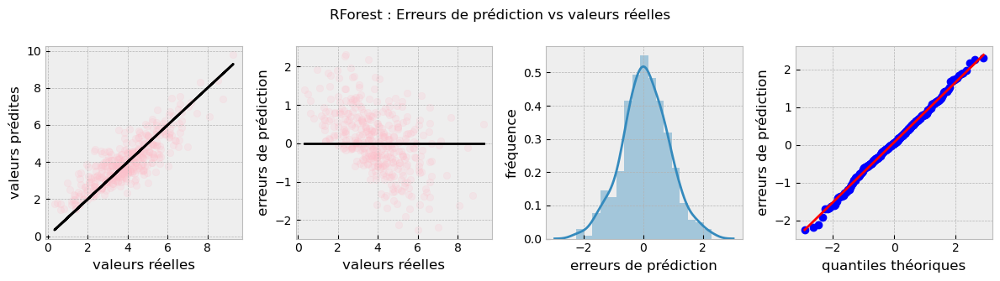

R2 : 0.708
Median absolute error : 0.51
Root mean squarred error : 0.8
Shapiro-Wilk test : 1.0  p-value : 0.58


## TotalGHGEmissions Modèle Ridge itération n 2  



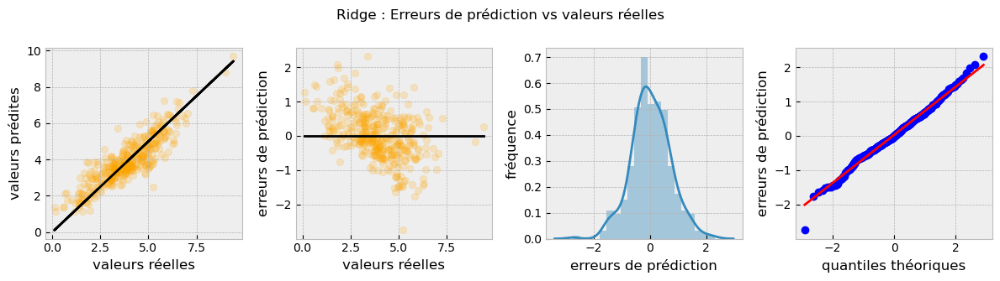

R2 : 0.766
Median absolute error : 0.43
Root mean squarred error : 0.7
Shapiro-Wilk test : 0.99  p-value : 0.09


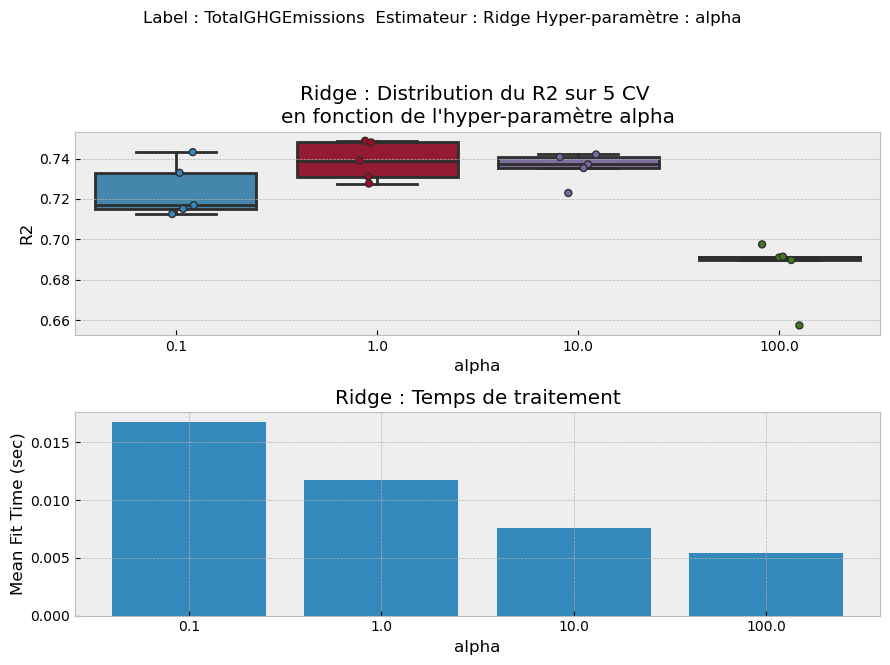

Meilleur(s) hyper-parametre(s) : {'alpha': 1.0}


## TotalGHGEmissions Modèle Lasso itération n 2  



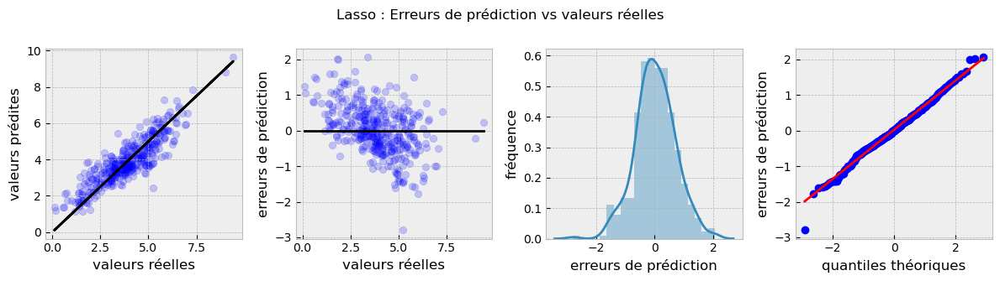

R2 : 0.771
Median absolute error : 0.44
Root mean squarred error : 0.69
Shapiro-Wilk test : 0.99  p-value : 0.12


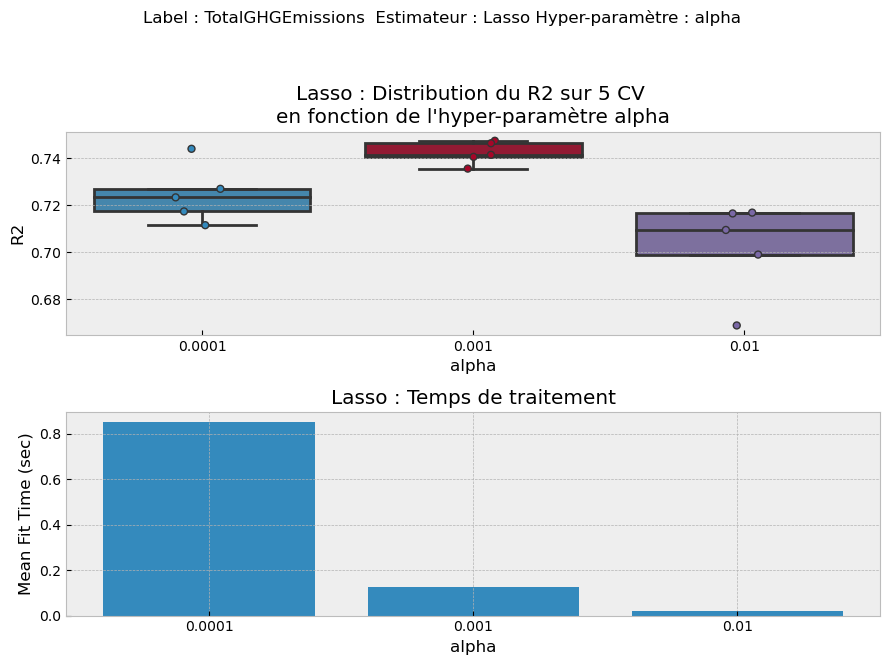

Meilleur(s) hyper-parametre(s) : {'alpha': 0.001}


## TotalGHGEmissions Modèle KNN itération n 2  



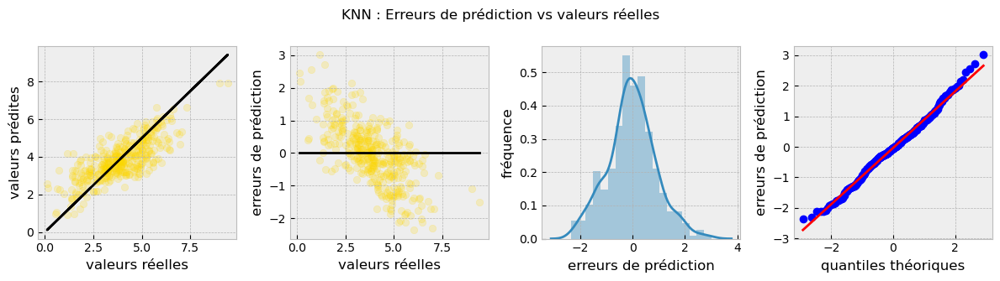

R2 : 0.591
Median absolute error : 0.54
Root mean squarred error : 0.92
Shapiro-Wilk test : 0.99  p-value : 0.05


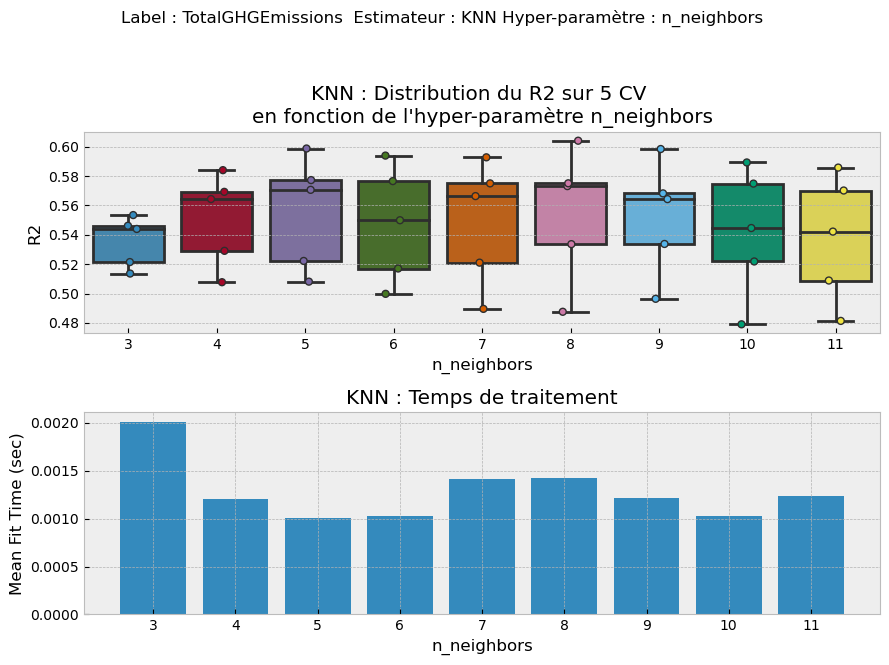

Meilleur(s) hyper-parametre(s) : {'n_neighbors': 5}


## TotalGHGEmissions Modèle SVR itération n 2  



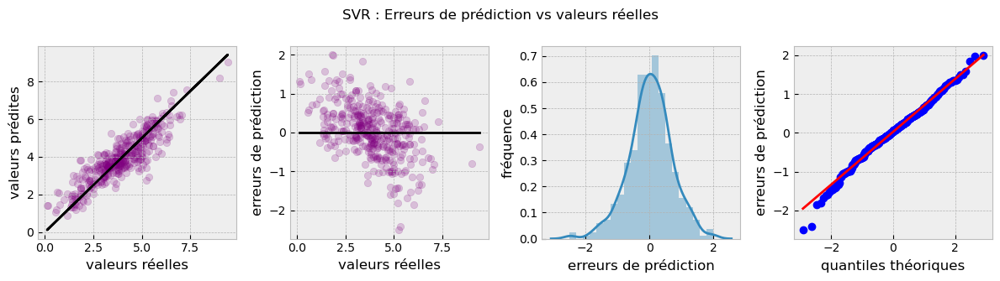

R2 : 0.777
Median absolute error : 0.4
Root mean squarred error : 0.68
Shapiro-Wilk test : 0.99  p-value : 0.01


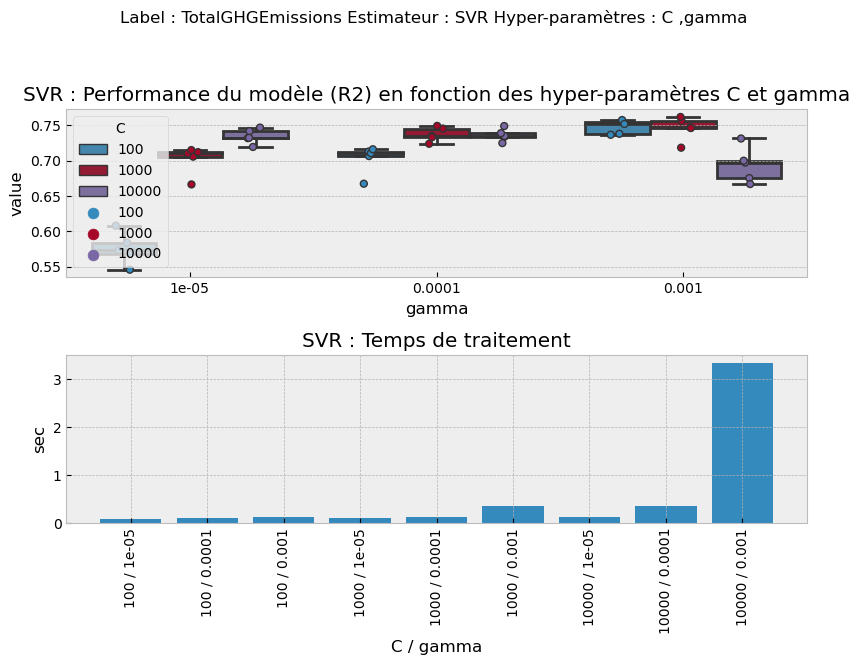

Meilleur(s) hyper-parametre(s) : {'C': 100, 'gamma': 0.001}


## TotalGHGEmissions Modèle RForest itération n 2  



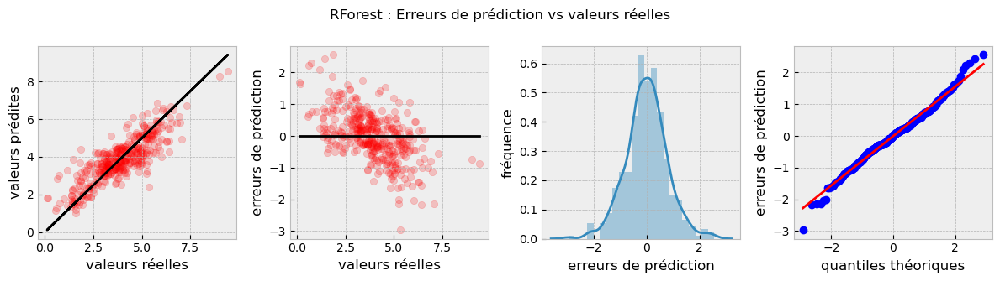

R2 : 0.708
Median absolute error : 0.46
Root mean squarred error : 0.78
Shapiro-Wilk test : 0.99  p-value : 0.01


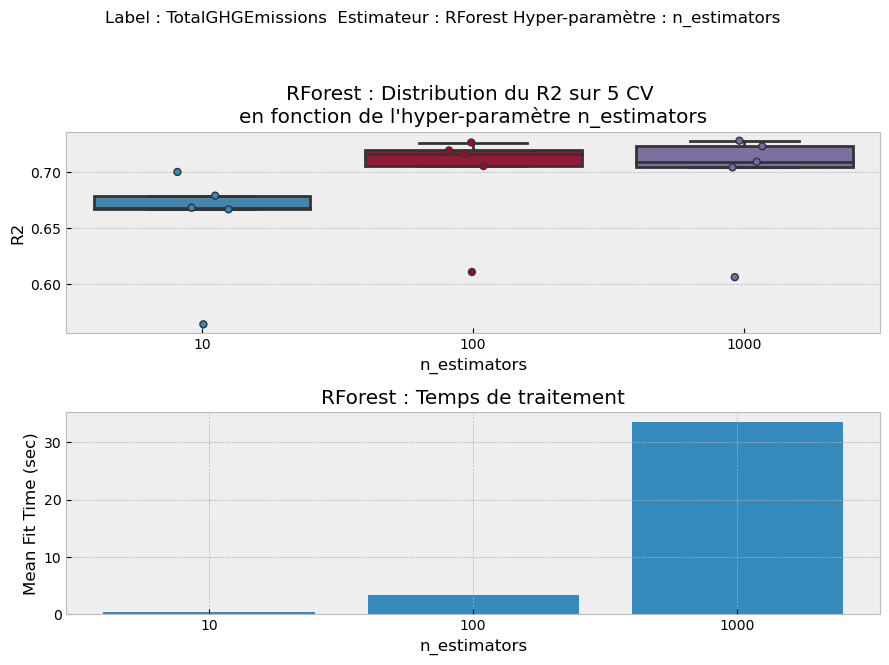

Meilleur(s) hyper-parametre(s) : {'n_estimators': 100}


## TotalGHGEmissions Modèle Linear Regression itération n 2  



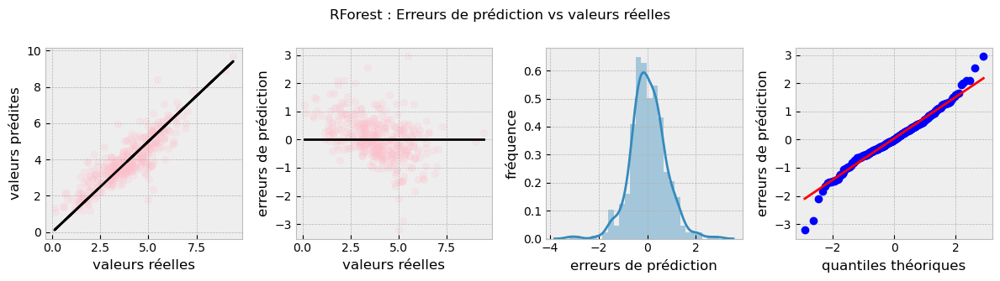

R2 : 0.737
Median absolute error : 0.43
Root mean squarred error : 0.74
Shapiro-Wilk test : 0.98  p-value : 0.0


## TotalGHGEmissions Modèle Ridge itération n 3  



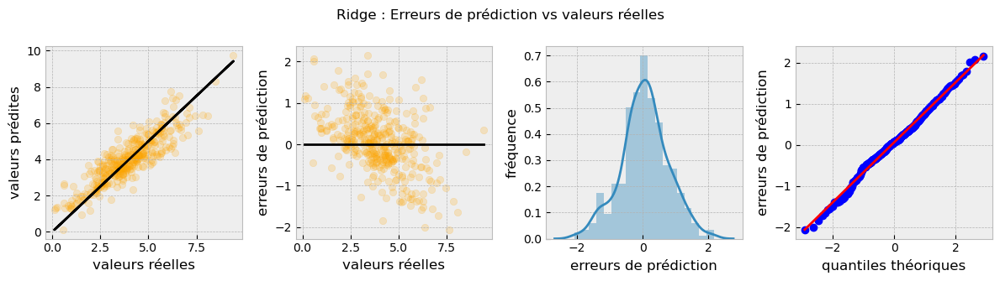

R2 : 0.771
Median absolute error : 0.42
Root mean squarred error : 0.73
Shapiro-Wilk test : 0.99  p-value : 0.12


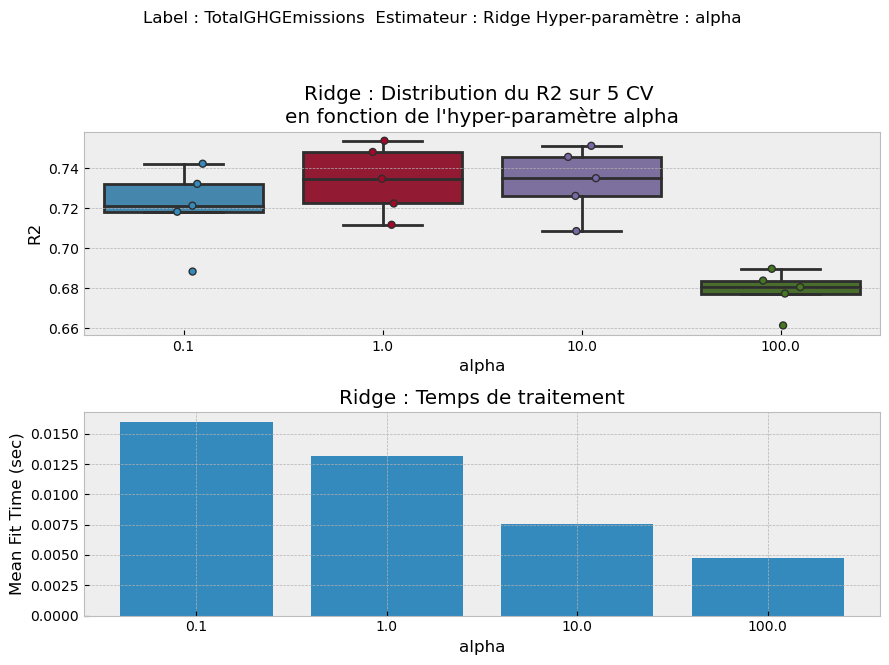

Meilleur(s) hyper-parametre(s) : {'alpha': 1.0}


## TotalGHGEmissions Modèle Lasso itération n 3  



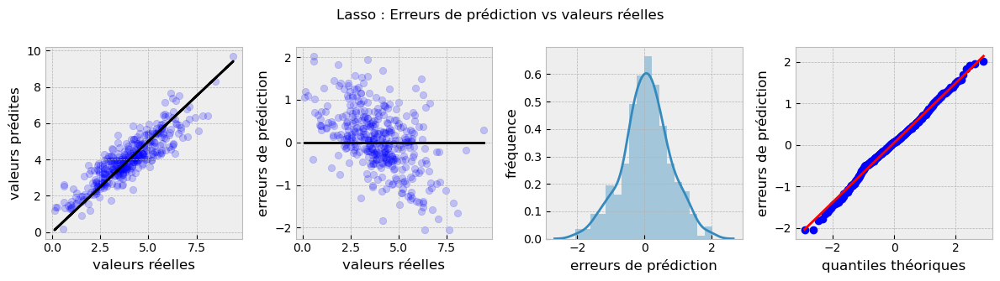

R2 : 0.779
Median absolute error : 0.43
Root mean squarred error : 0.72
Shapiro-Wilk test : 0.99  p-value : 0.17


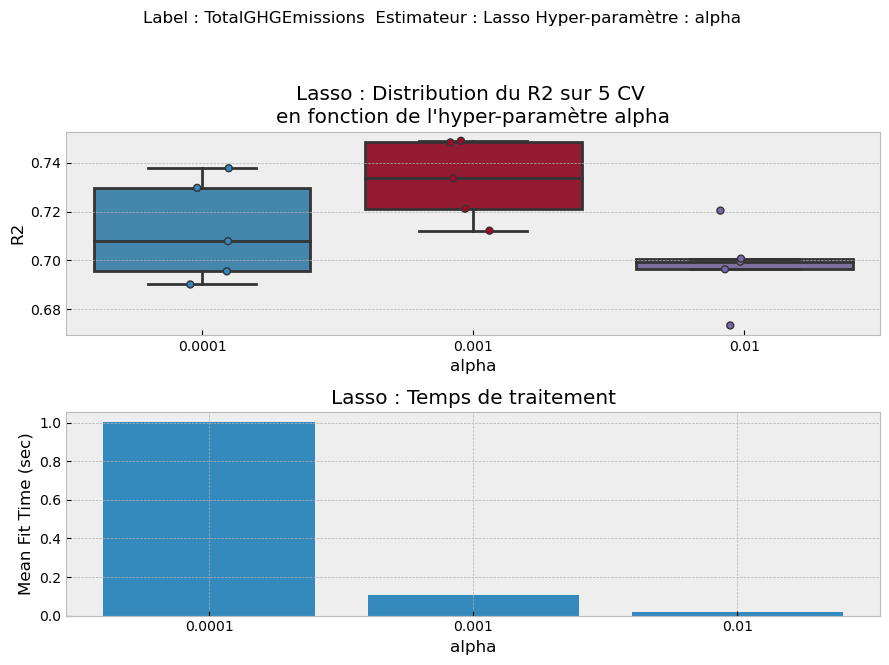

Meilleur(s) hyper-parametre(s) : {'alpha': 0.001}


## TotalGHGEmissions Modèle KNN itération n 3  



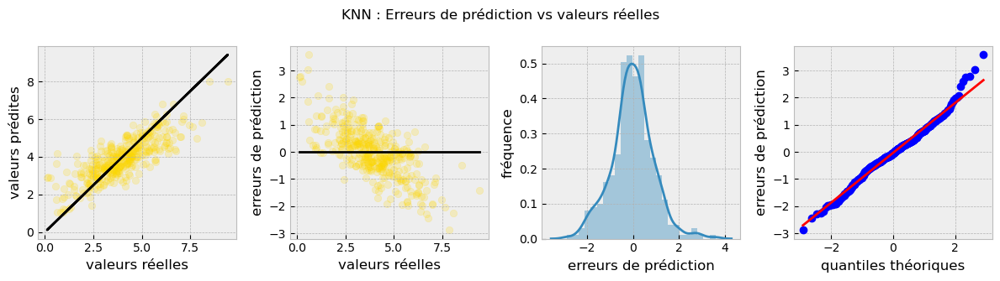

R2 : 0.635
Median absolute error : 0.51
Root mean squarred error : 0.92
Shapiro-Wilk test : 0.99  p-value : 0.0


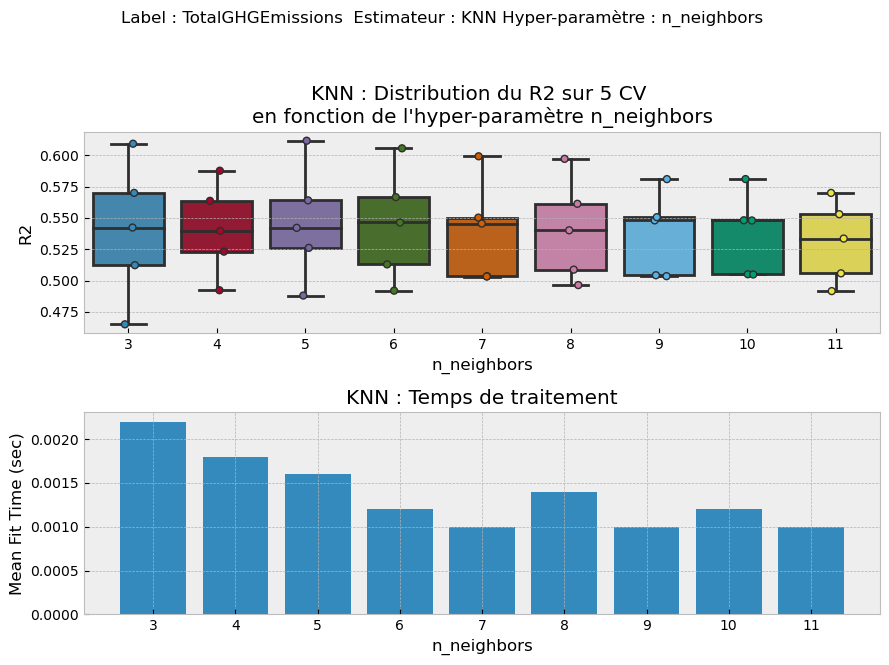

Meilleur(s) hyper-parametre(s) : {'n_neighbors': 5}


## TotalGHGEmissions Modèle SVR itération n 3  



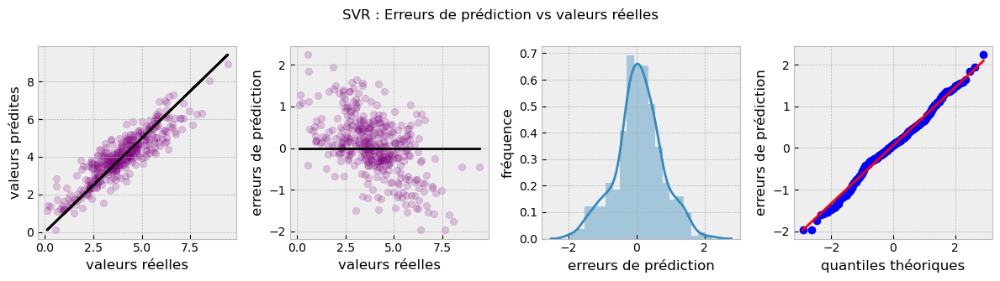

R2 : 0.789
Median absolute error : 0.4
Root mean squarred error : 0.7
Shapiro-Wilk test : 0.99  p-value : 0.01


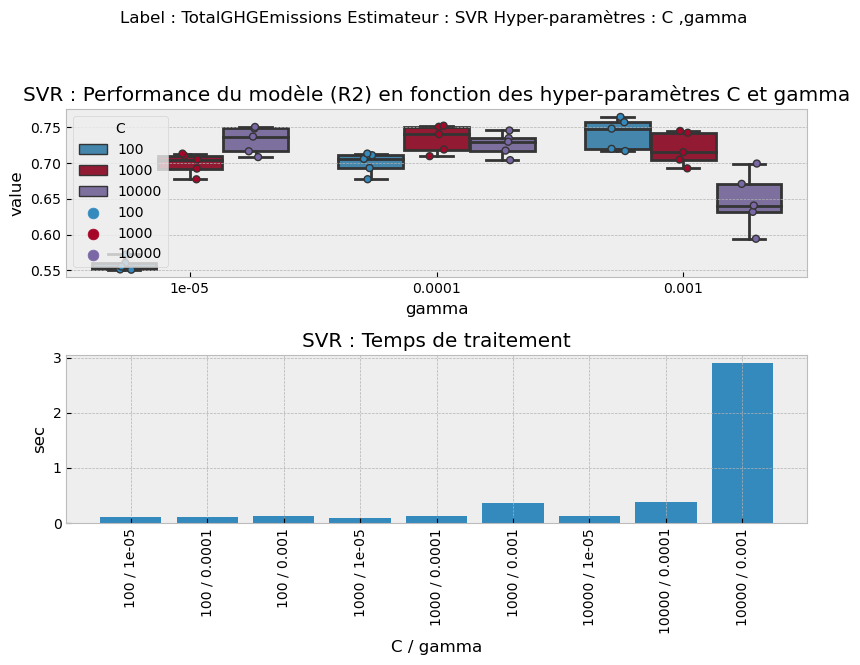

Meilleur(s) hyper-parametre(s) : {'C': 100, 'gamma': 0.001}


## TotalGHGEmissions Modèle RForest itération n 3  



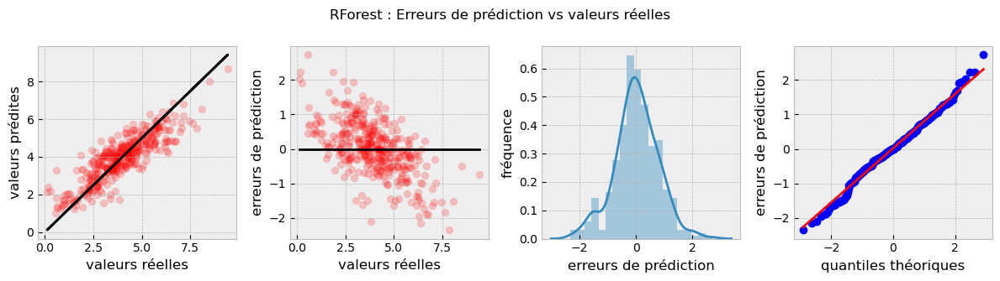

R2 : 0.736
Median absolute error : 0.47
Root mean squarred error : 0.78
Shapiro-Wilk test : 0.99  p-value : 0.01


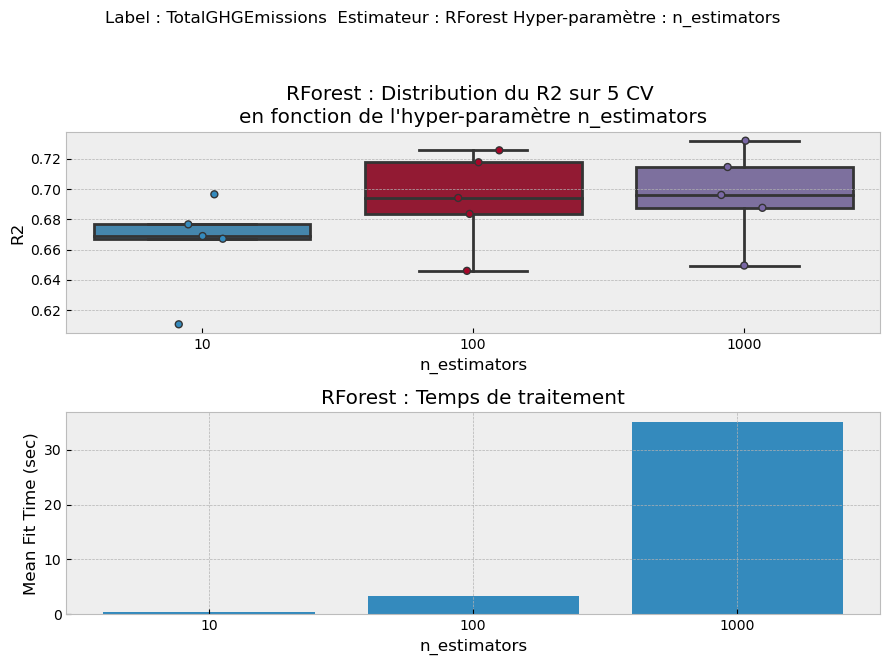

Meilleur(s) hyper-parametre(s) : {'n_estimators': 1000}


## TotalGHGEmissions Modèle Linear Regression itération n 3  



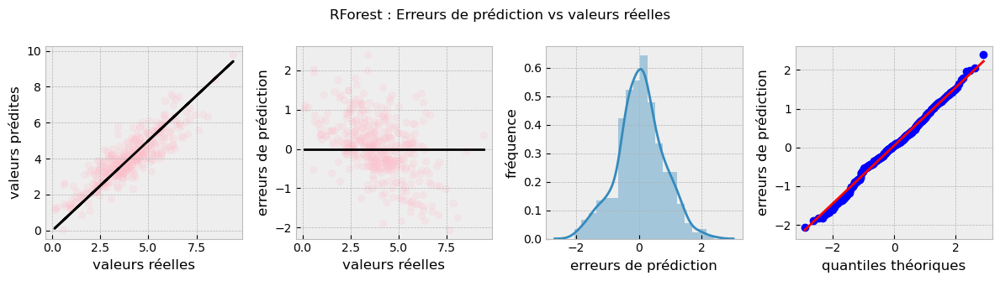

R2 : 0.76
Median absolute error : 0.44
Root mean squarred error : 0.75
Shapiro-Wilk test : 0.99  p-value : 0.1


## TotalGHGEmissions Modèle Ridge itération n 4  



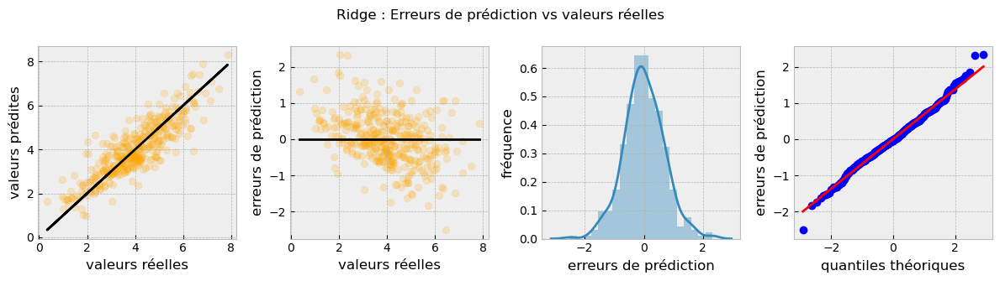

R2 : 0.738
Median absolute error : 0.44
Root mean squarred error : 0.69
Shapiro-Wilk test : 0.99  p-value : 0.11


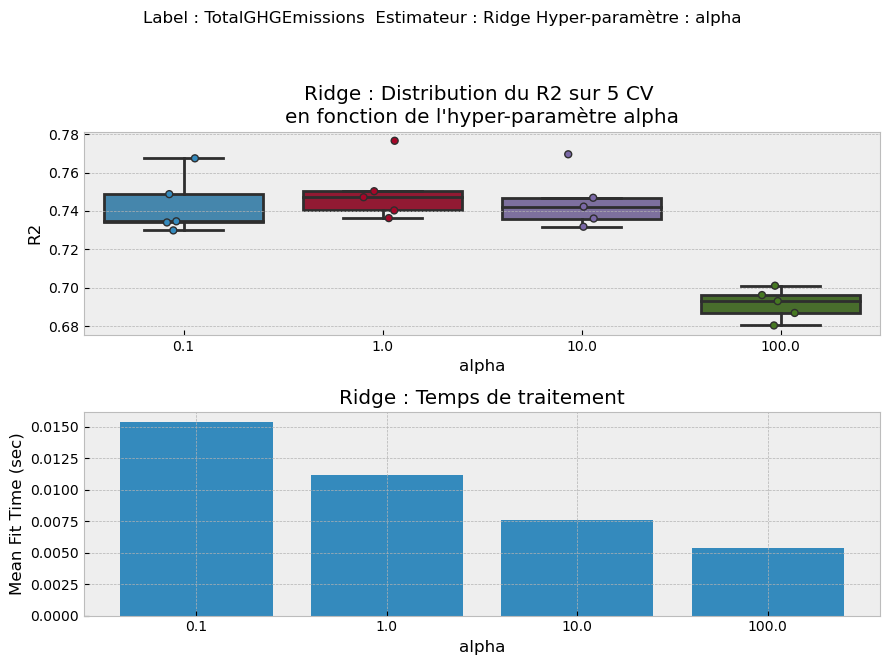

Meilleur(s) hyper-parametre(s) : {'alpha': 1.0}


## TotalGHGEmissions Modèle Lasso itération n 4  



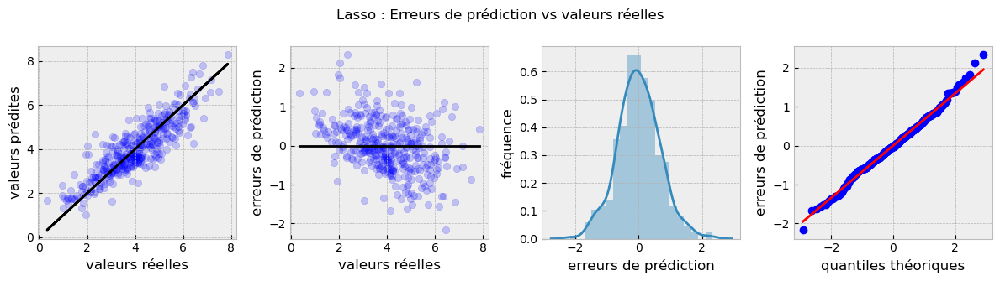

R2 : 0.751
Median absolute error : 0.42
Root mean squarred error : 0.67
Shapiro-Wilk test : 0.99  p-value : 0.24


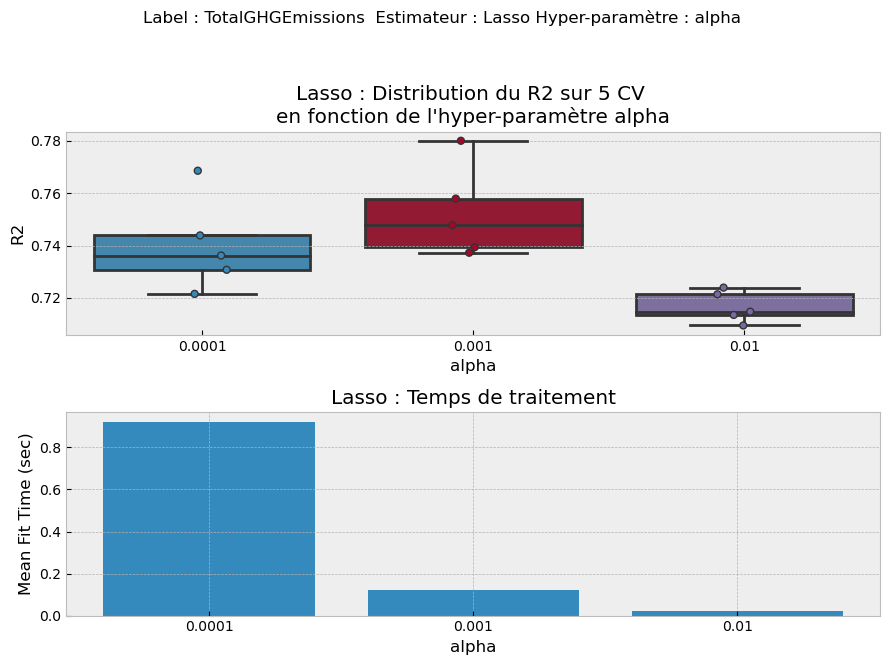

Meilleur(s) hyper-parametre(s) : {'alpha': 0.001}


## TotalGHGEmissions Modèle KNN itération n 4  



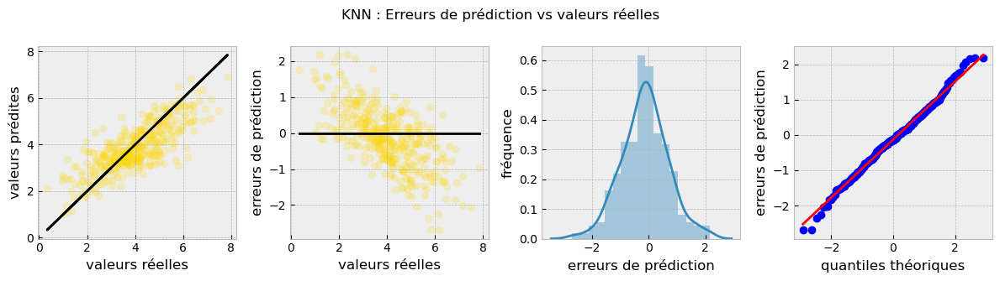

R2 : 0.614
Median absolute error : 0.5
Root mean squarred error : 0.83
Shapiro-Wilk test : 0.99  p-value : 0.17


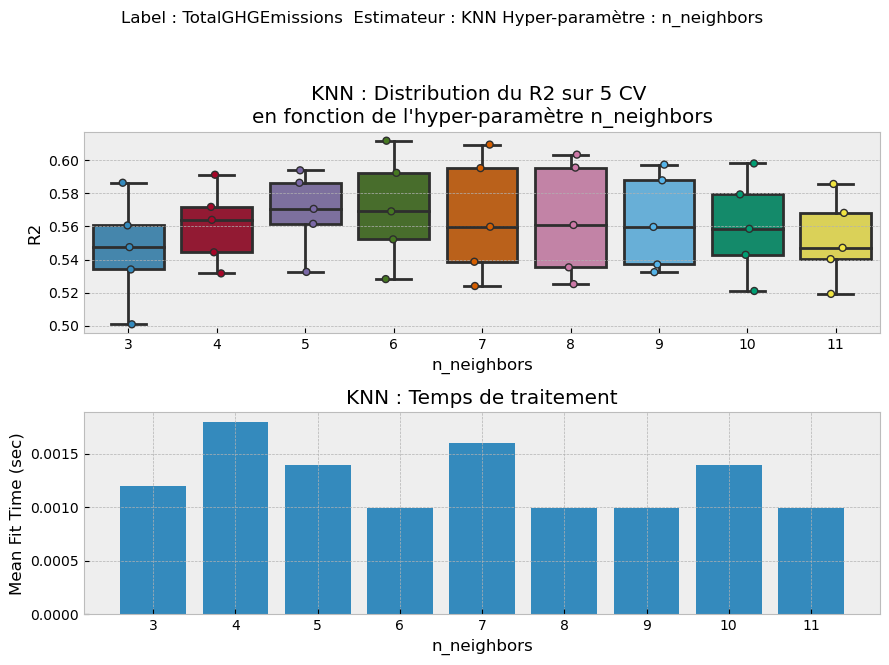

Meilleur(s) hyper-parametre(s) : {'n_neighbors': 6}


## TotalGHGEmissions Modèle SVR itération n 4  



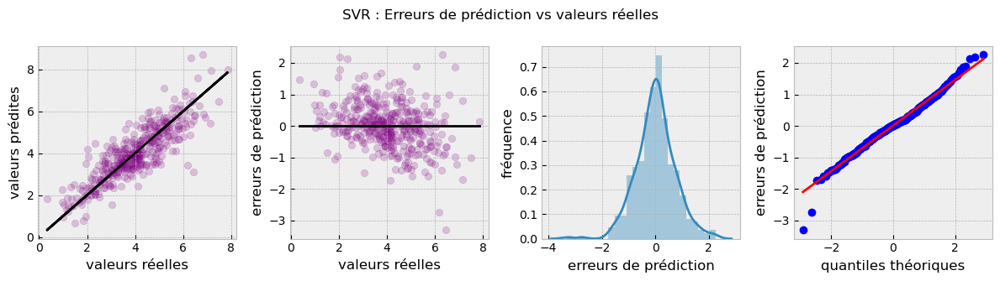

R2 : 0.704
Median absolute error : 0.42
Root mean squarred error : 0.73
Shapiro-Wilk test : 0.98  p-value : 0.0


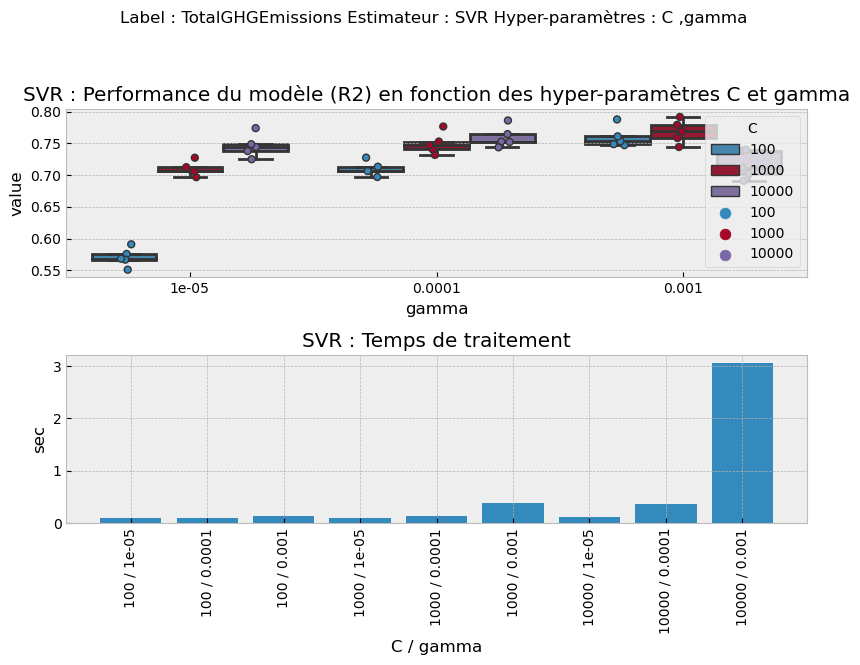

Meilleur(s) hyper-parametre(s) : {'C': 1000, 'gamma': 0.001}


## TotalGHGEmissions Modèle RForest itération n 4  



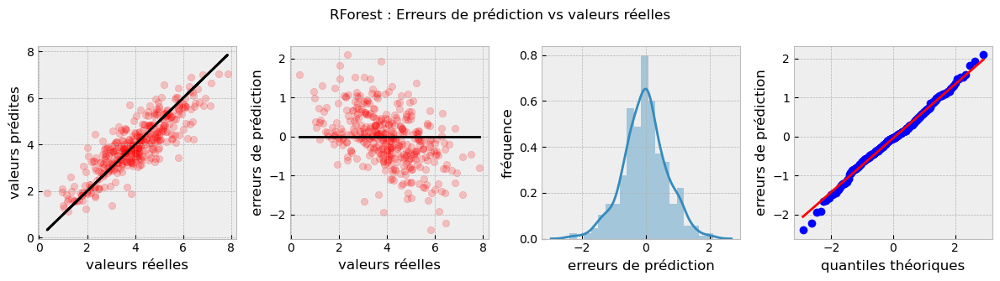

R2 : 0.733
Median absolute error : 0.43
Root mean squarred error : 0.69
Shapiro-Wilk test : 0.99  p-value : 0.08


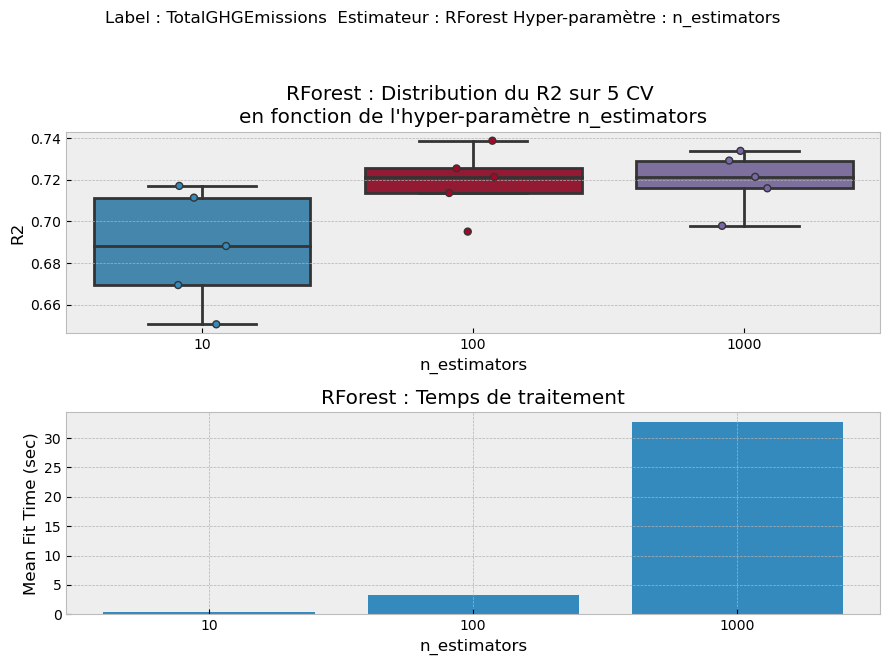

Meilleur(s) hyper-parametre(s) : {'n_estimators': 1000}


## TotalGHGEmissions Modèle Linear Regression itération n 4  



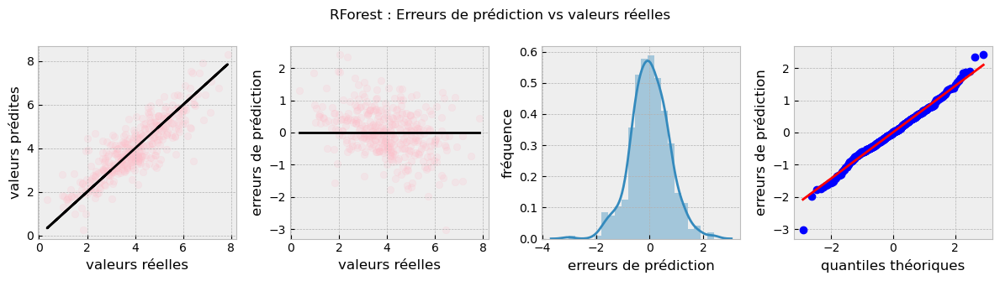

R2 : 0.712
Median absolute error : 0.45
Root mean squarred error : 0.72
Shapiro-Wilk test : 0.99  p-value : 0.02


## TotalGHGEmissions Modèle Ridge itération n 5  



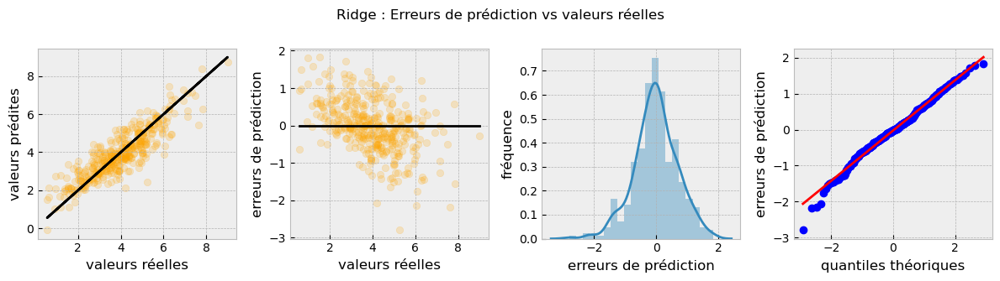

R2 : 0.76
Median absolute error : 0.42
Root mean squarred error : 0.7
Shapiro-Wilk test : 0.99  p-value : 0.01


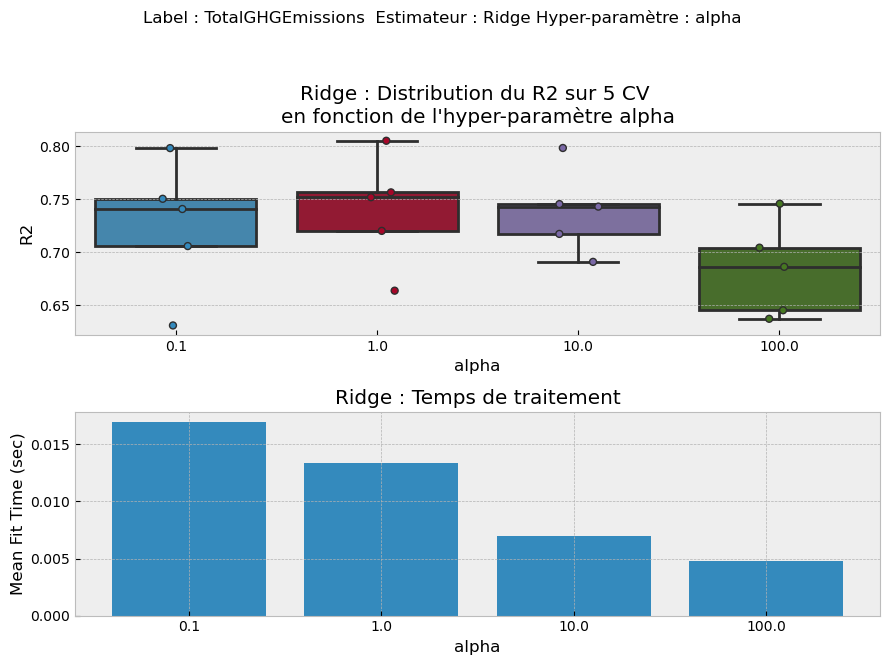

Meilleur(s) hyper-parametre(s) : {'alpha': 1.0}


## TotalGHGEmissions Modèle Lasso itération n 5  



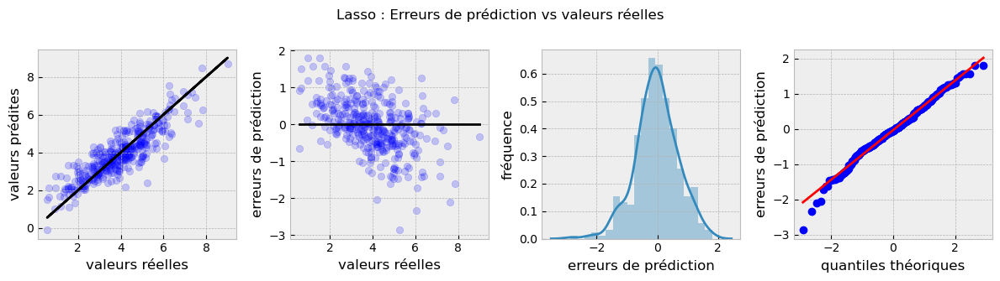

R2 : 0.758
Median absolute error : 0.45
Root mean squarred error : 0.7
Shapiro-Wilk test : 0.99  p-value : 0.01


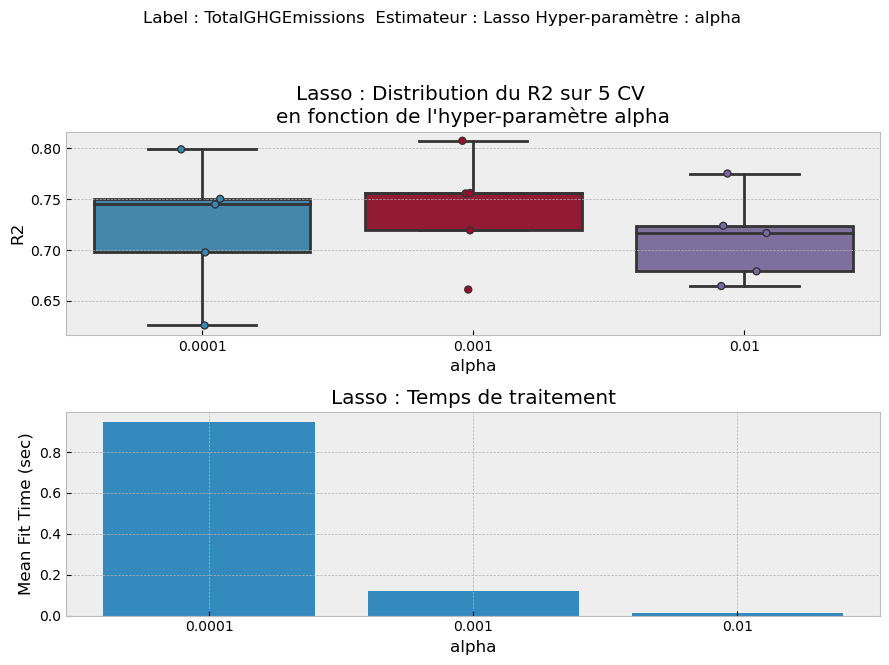

Meilleur(s) hyper-parametre(s) : {'alpha': 0.001}


## TotalGHGEmissions Modèle KNN itération n 5  



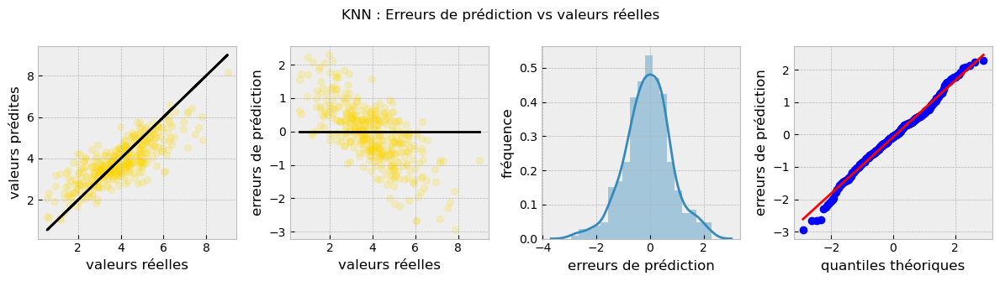

R2 : 0.627
Median absolute error : 0.52
Root mean squarred error : 0.87
Shapiro-Wilk test : 0.99  p-value : 0.02


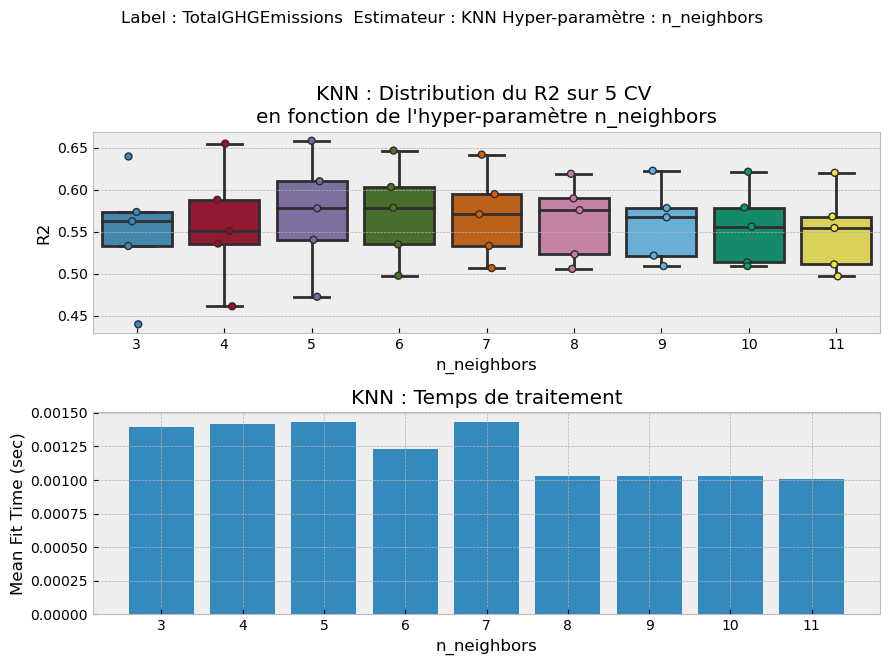

Meilleur(s) hyper-parametre(s) : {'n_neighbors': 6}


## TotalGHGEmissions Modèle SVR itération n 5  



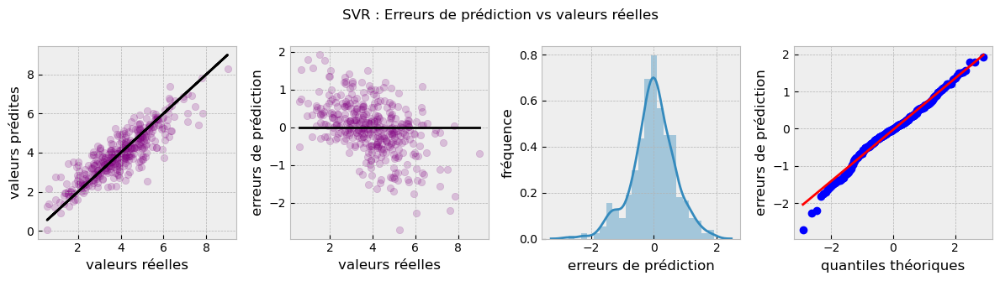

R2 : 0.765
Median absolute error : 0.38
Root mean squarred error : 0.69
Shapiro-Wilk test : 0.98  p-value : 0.0


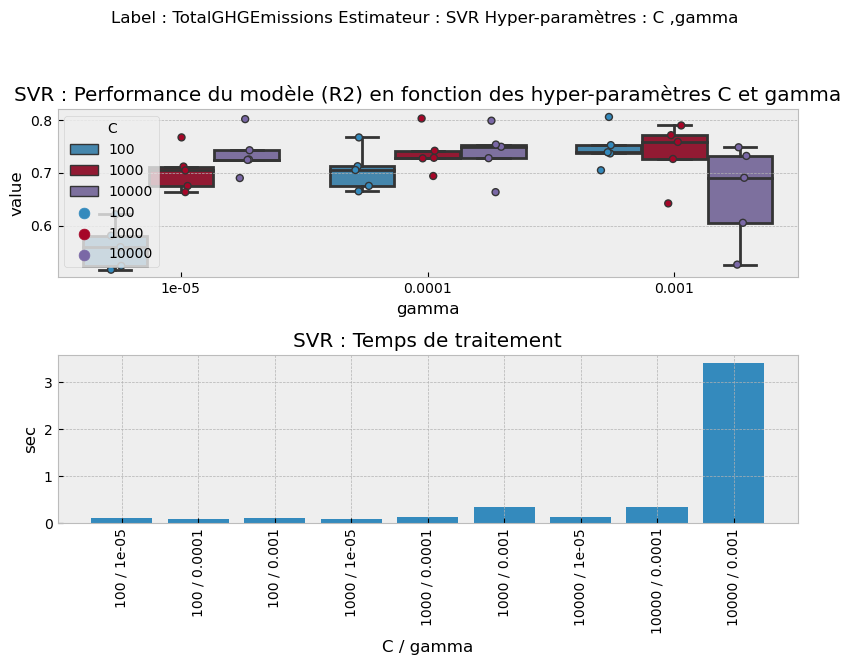

Meilleur(s) hyper-parametre(s) : {'C': 100, 'gamma': 0.001}


## TotalGHGEmissions Modèle RForest itération n 5  



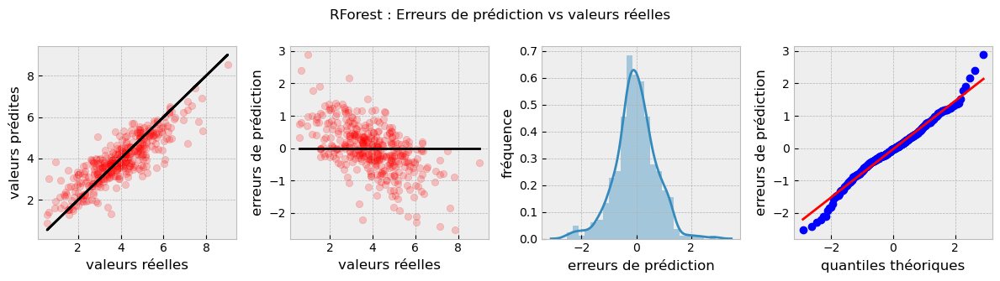

R2 : 0.727
Median absolute error : 0.41
Root mean squarred error : 0.75
Shapiro-Wilk test : 0.98  p-value : 0.0


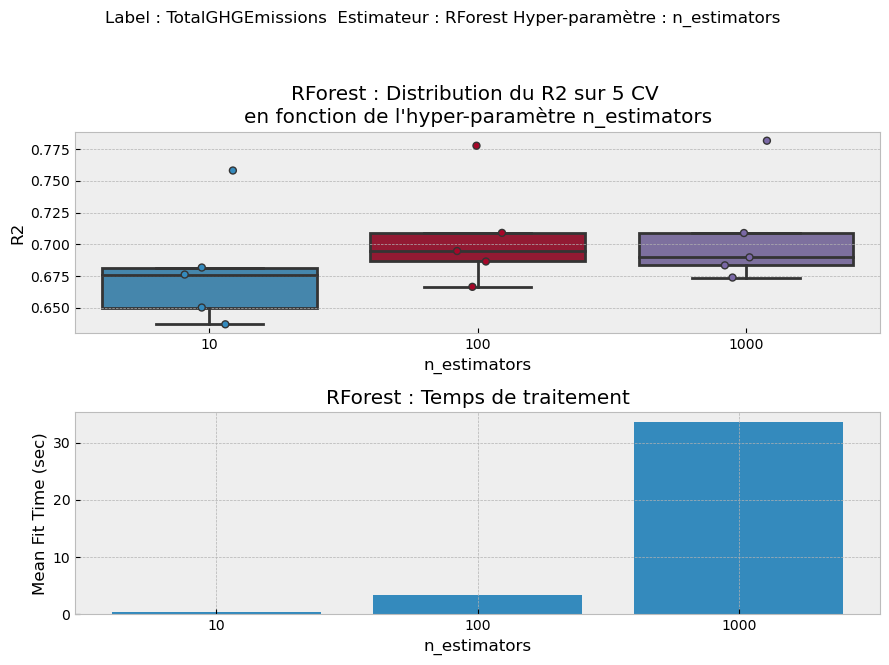

Meilleur(s) hyper-parametre(s) : {'n_estimators': 1000}


## TotalGHGEmissions Modèle Linear Regression itération n 5  



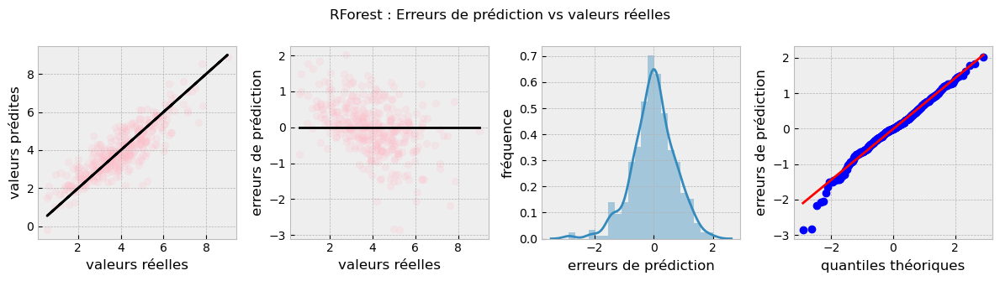

R2 : 0.746
Median absolute error : 0.42
Root mean squarred error : 0.72
Shapiro-Wilk test : 0.98  p-value : 0.0


## TotalGHGEmissions Modèle Ridge itération n 6  



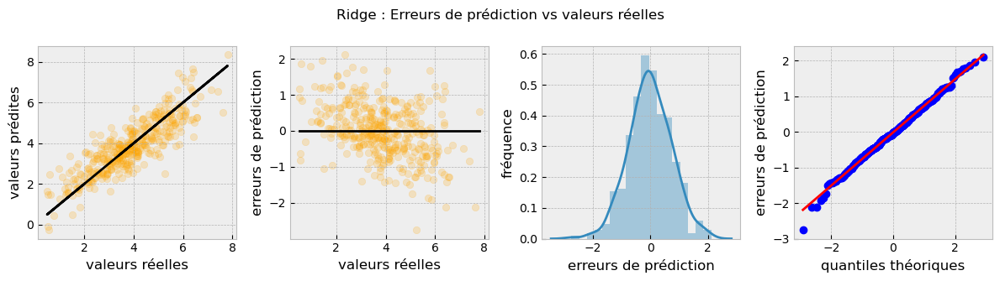

R2 : 0.724
Median absolute error : 0.49
Root mean squarred error : 0.74
Shapiro-Wilk test : 1.0  p-value : 0.61


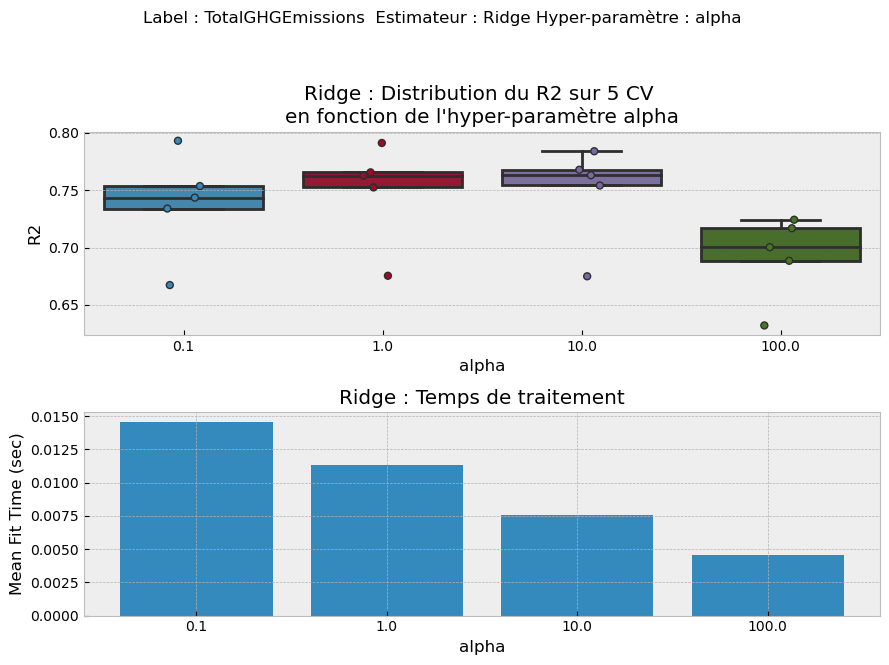

Meilleur(s) hyper-parametre(s) : {'alpha': 1.0}


## TotalGHGEmissions Modèle Lasso itération n 6  



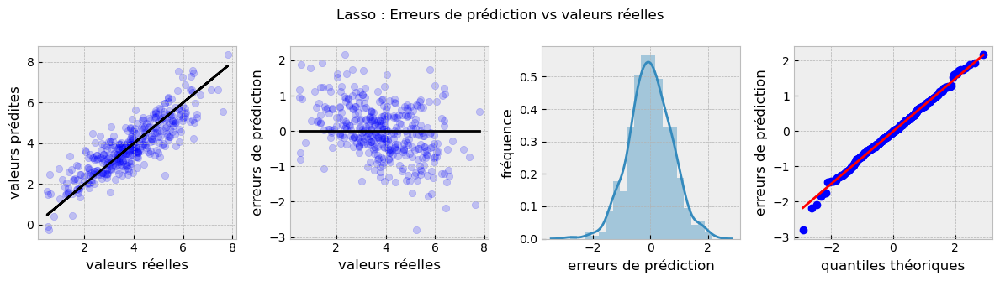

R2 : 0.727
Median absolute error : 0.47
Root mean squarred error : 0.74
Shapiro-Wilk test : 1.0  p-value : 0.45


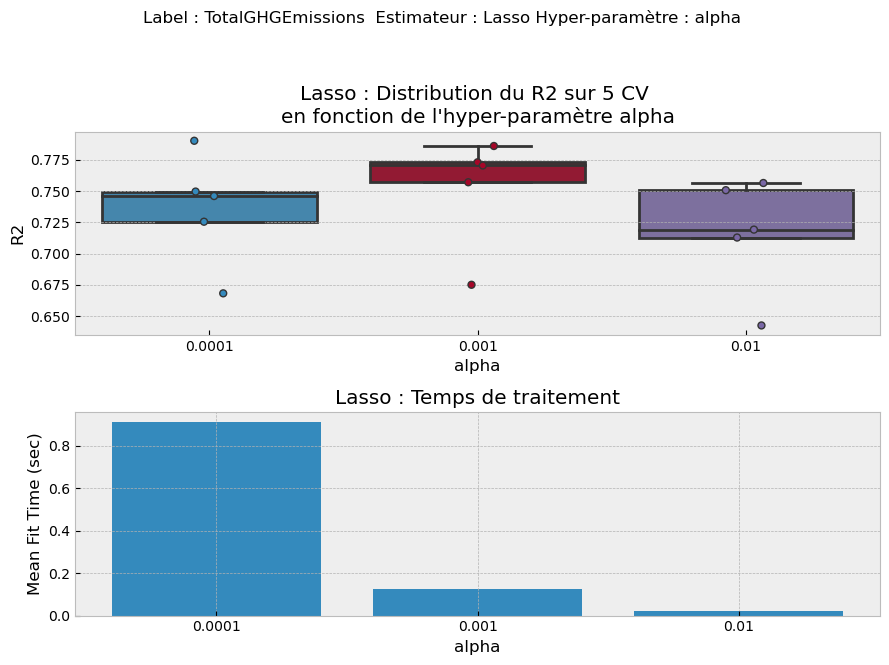

Meilleur(s) hyper-parametre(s) : {'alpha': 0.001}


## TotalGHGEmissions Modèle KNN itération n 6  



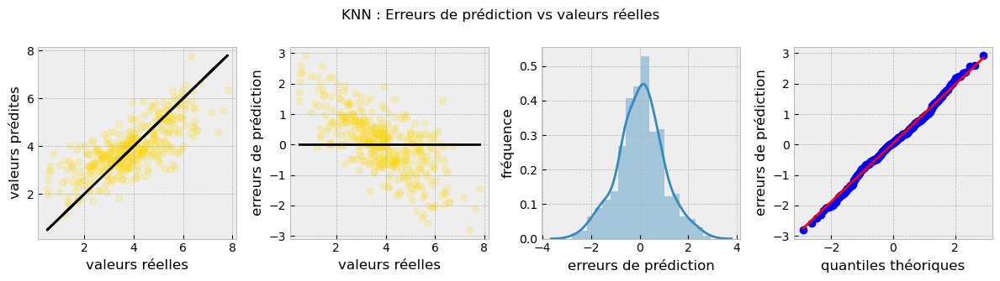

R2 : 0.54
Median absolute error : 0.57
Root mean squarred error : 0.96
Shapiro-Wilk test : 0.99  p-value : 0.19


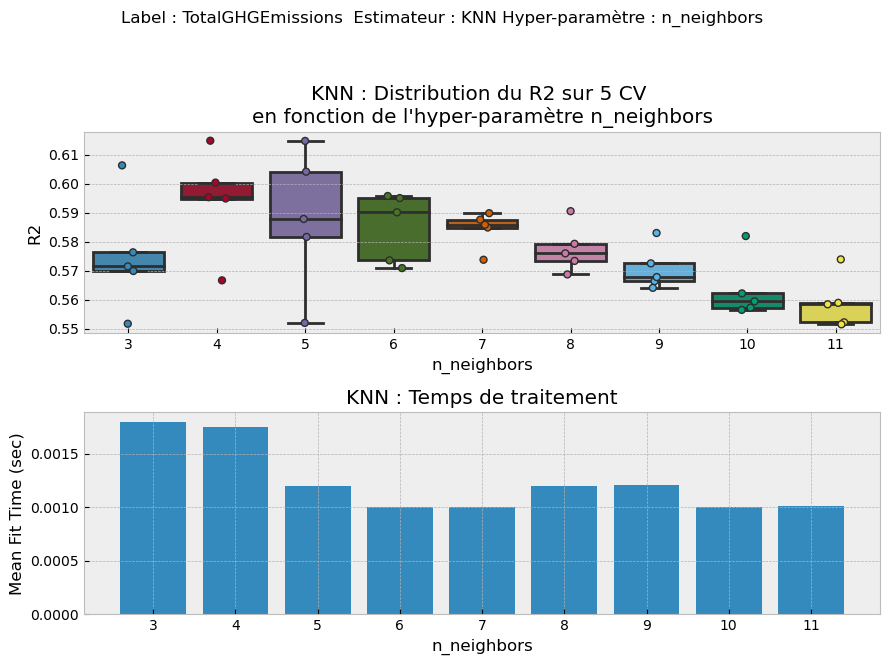

Meilleur(s) hyper-parametre(s) : {'n_neighbors': 4}


## TotalGHGEmissions Modèle SVR itération n 6  



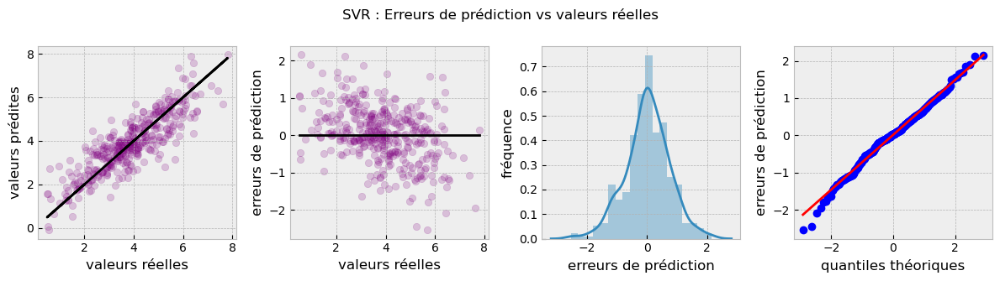

R2 : 0.73
Median absolute error : 0.46
Root mean squarred error : 0.74
Shapiro-Wilk test : 0.99  p-value : 0.02


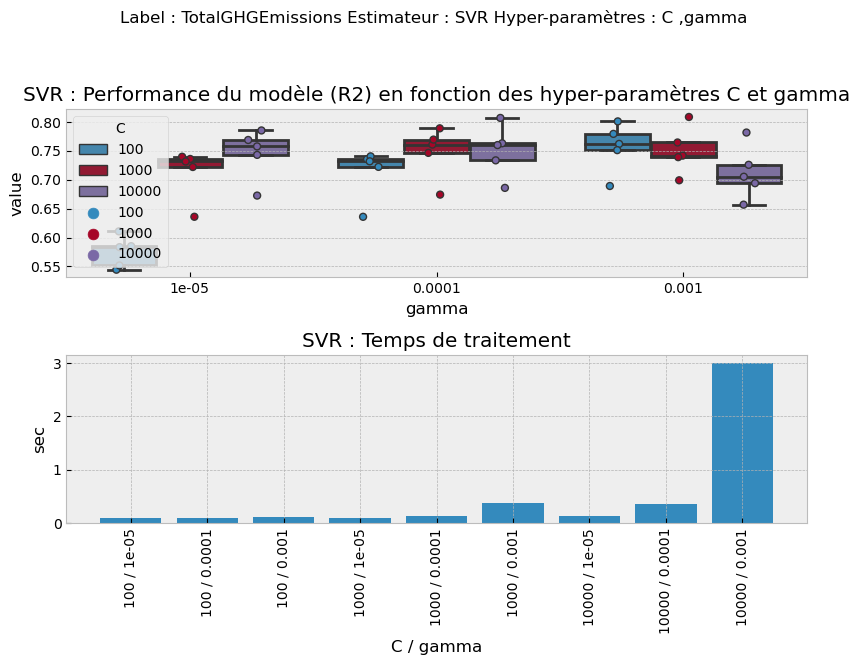

Meilleur(s) hyper-parametre(s) : {'C': 100, 'gamma': 0.001}


## TotalGHGEmissions Modèle RForest itération n 6  



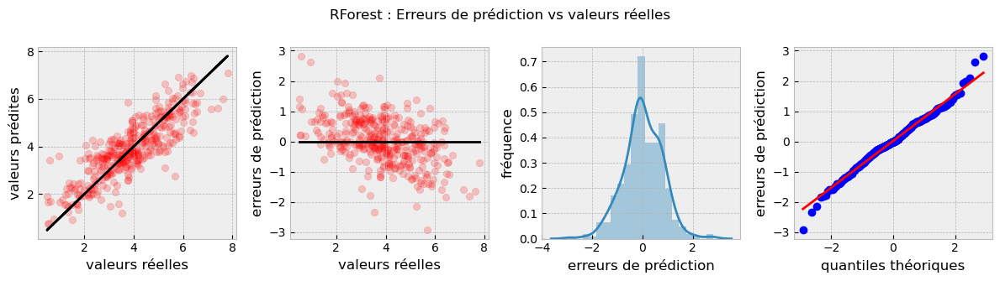

R2 : 0.703
Median absolute error : 0.5
Root mean squarred error : 0.77
Shapiro-Wilk test : 0.99  p-value : 0.02


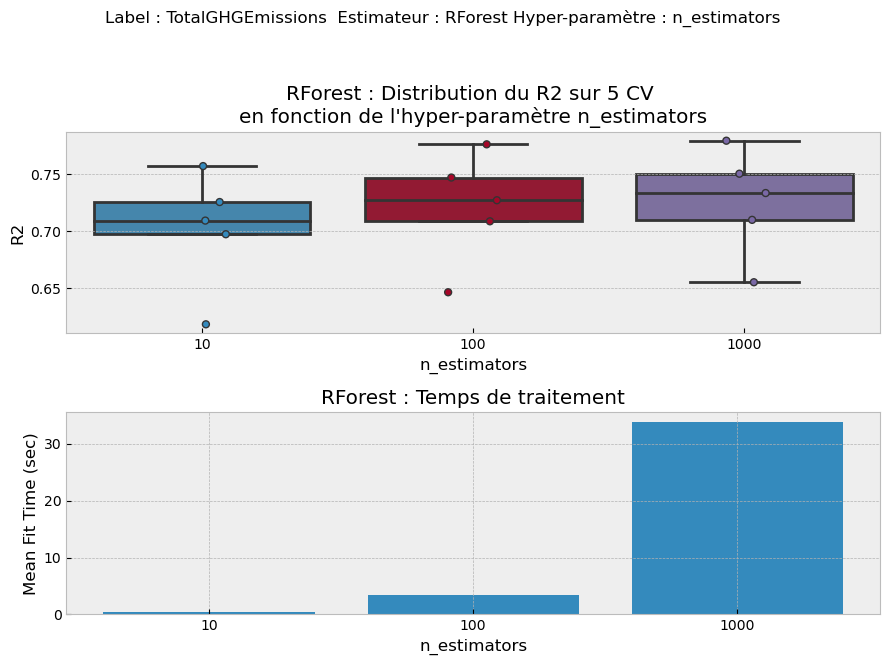

Meilleur(s) hyper-parametre(s) : {'n_estimators': 1000}


## TotalGHGEmissions Modèle Linear Regression itération n 6  



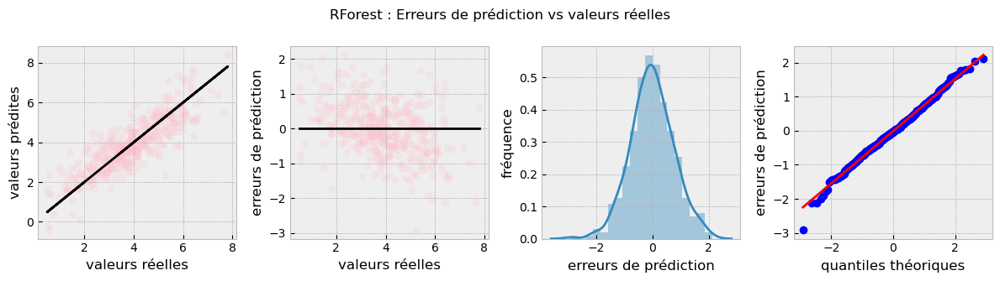

R2 : 0.709
Median absolute error : 0.49
Root mean squarred error : 0.76
Shapiro-Wilk test : 1.0  p-value : 0.43


## TotalGHGEmissions Modèle Ridge itération n 7  



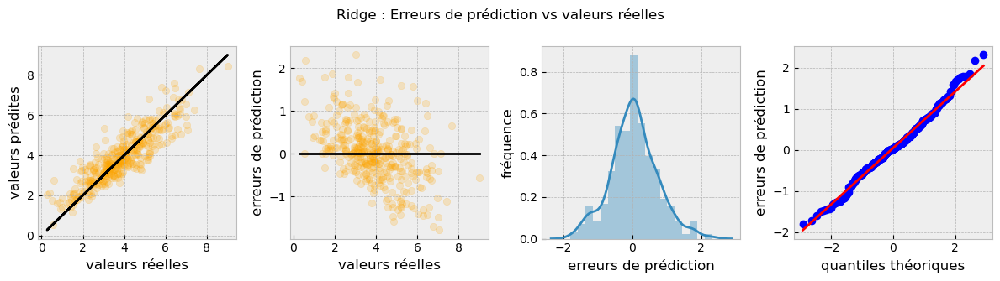

R2 : 0.777
Median absolute error : 0.41
Root mean squarred error : 0.69
Shapiro-Wilk test : 0.99  p-value : 0.02


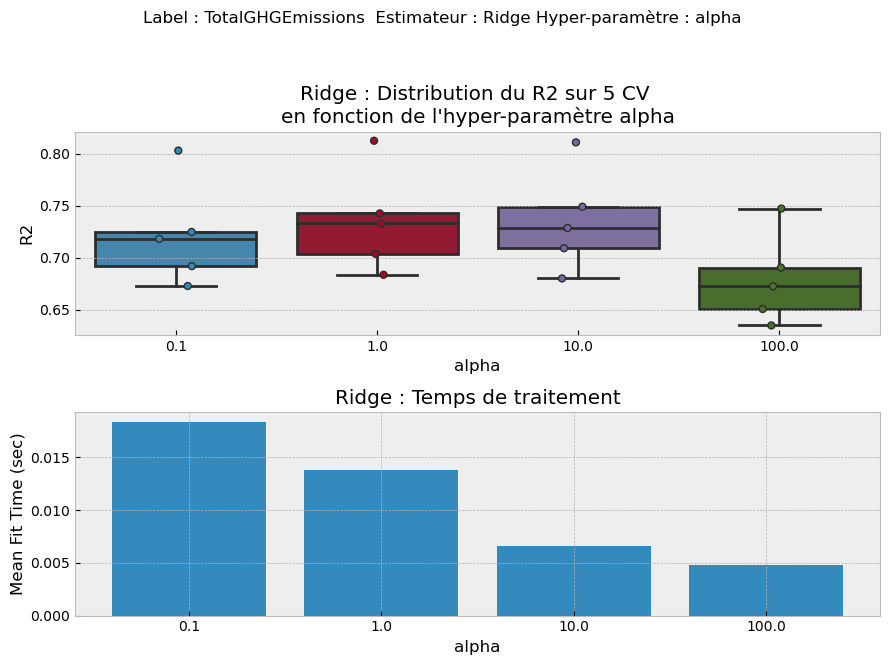

Meilleur(s) hyper-parametre(s) : {'alpha': 10.0}


## TotalGHGEmissions Modèle Lasso itération n 7  



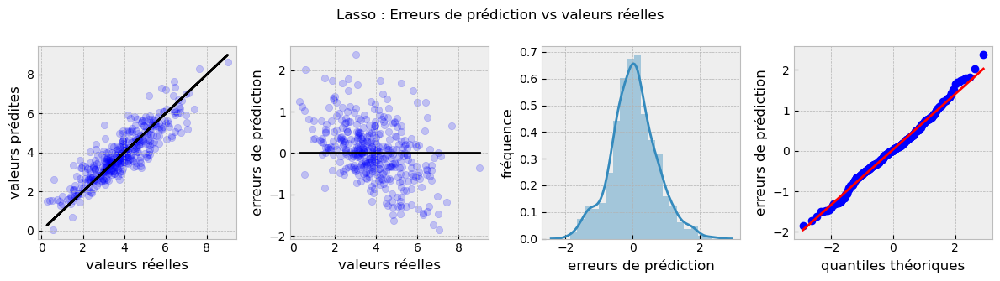

R2 : 0.778
Median absolute error : 0.4
Root mean squarred error : 0.68
Shapiro-Wilk test : 0.99  p-value : 0.03


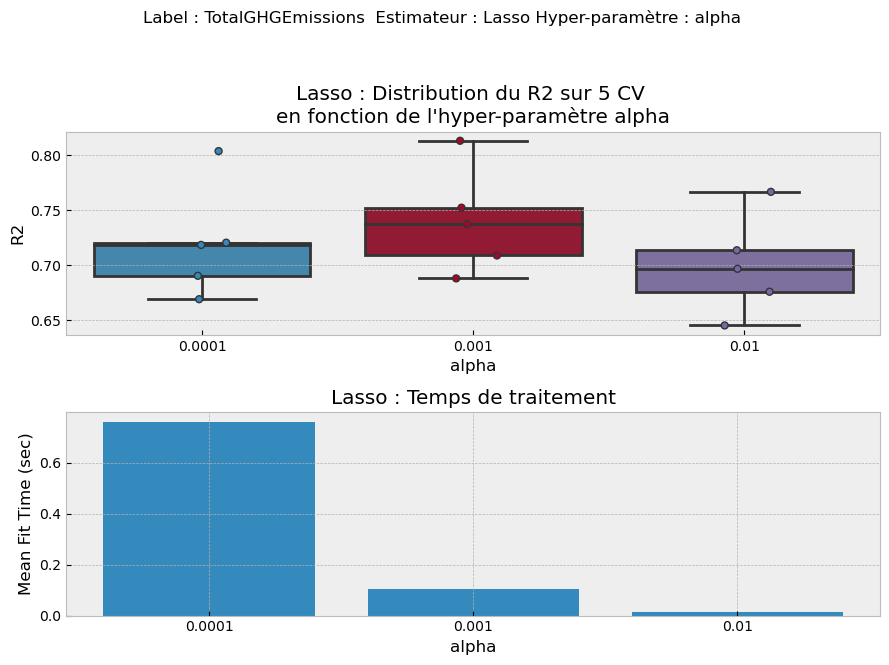

Meilleur(s) hyper-parametre(s) : {'alpha': 0.001}


## TotalGHGEmissions Modèle KNN itération n 7  



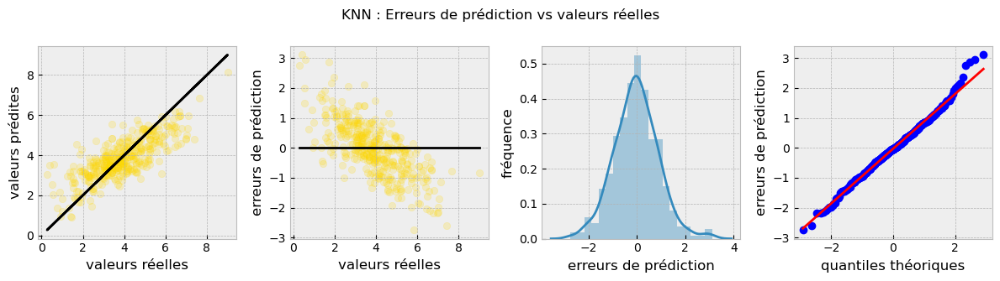

R2 : 0.603
Median absolute error : 0.57
Root mean squarred error : 0.91
Shapiro-Wilk test : 0.99  p-value : 0.06


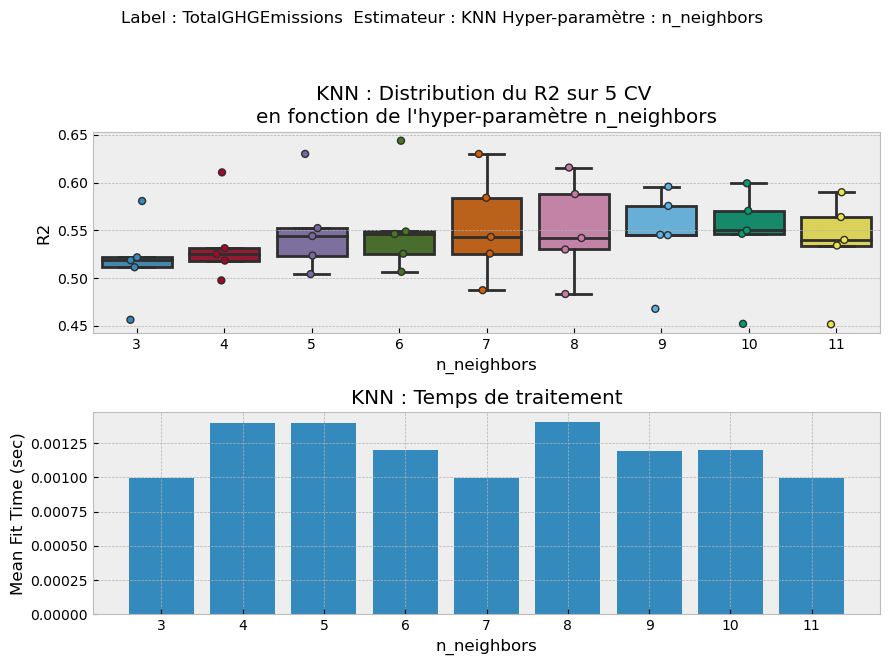

Meilleur(s) hyper-parametre(s) : {'n_neighbors': 6}


## TotalGHGEmissions Modèle SVR itération n 7  



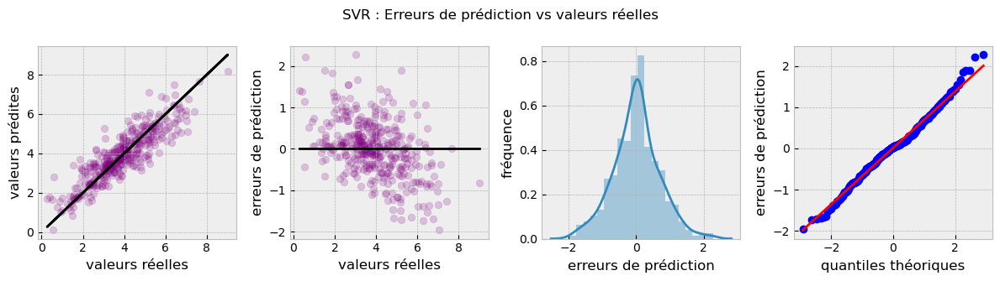

R2 : 0.778
Median absolute error : 0.4
Root mean squarred error : 0.68
Shapiro-Wilk test : 0.99  p-value : 0.02


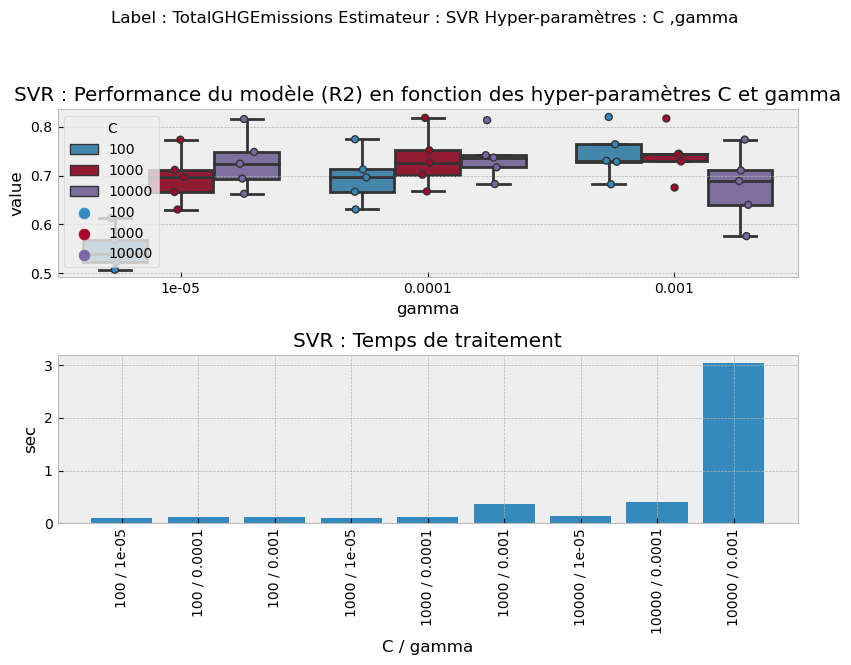

Meilleur(s) hyper-parametre(s) : {'C': 100, 'gamma': 0.001}


## TotalGHGEmissions Modèle RForest itération n 7  



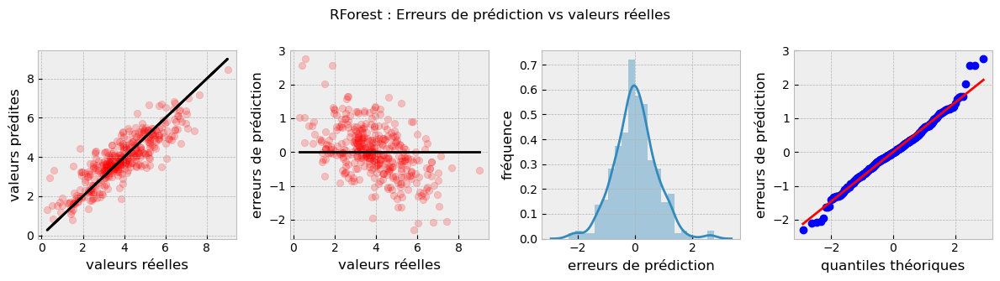

R2 : 0.745
Median absolute error : 0.43
Root mean squarred error : 0.73
Shapiro-Wilk test : 0.99  p-value : 0.0


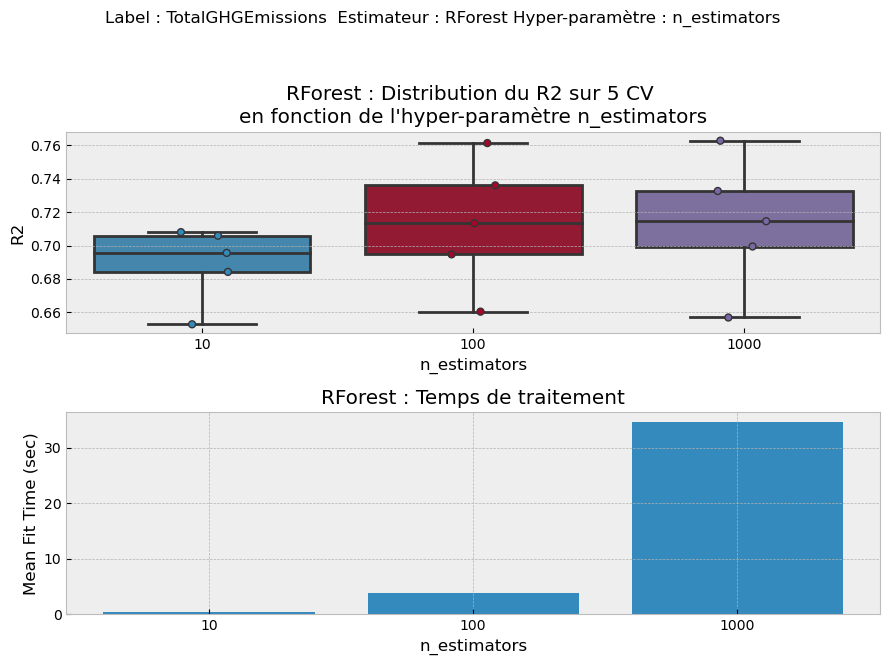

Meilleur(s) hyper-parametre(s) : {'n_estimators': 1000}


## TotalGHGEmissions Modèle Linear Regression itération n 7  



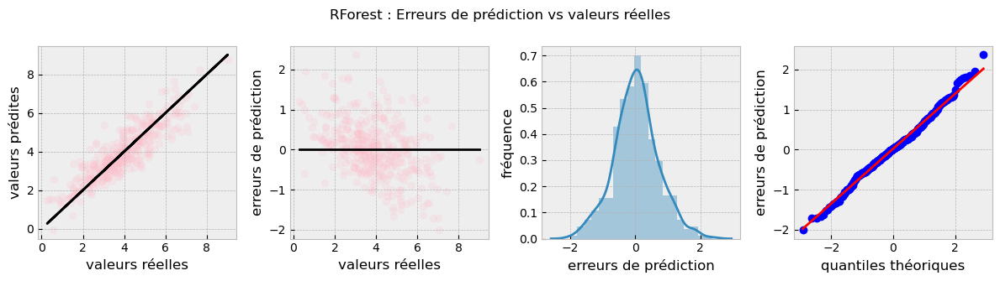

R2 : 0.777
Median absolute error : 0.41
Root mean squarred error : 0.68
Shapiro-Wilk test : 0.99  p-value : 0.08


## TotalGHGEmissions Modèle Ridge itération n 8  



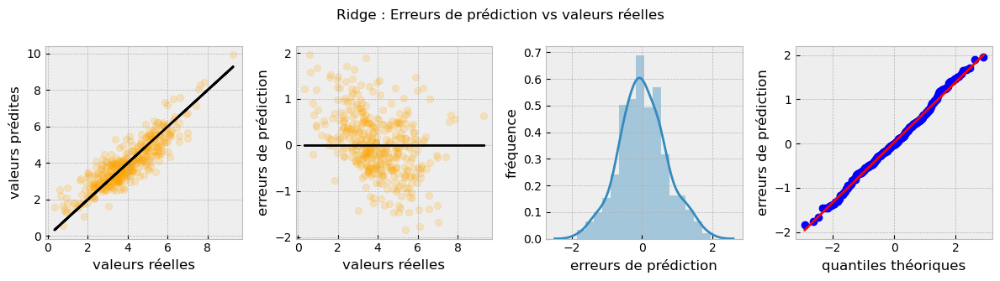

R2 : 0.77
Median absolute error : 0.45
Root mean squarred error : 0.68
Shapiro-Wilk test : 0.99  p-value : 0.19


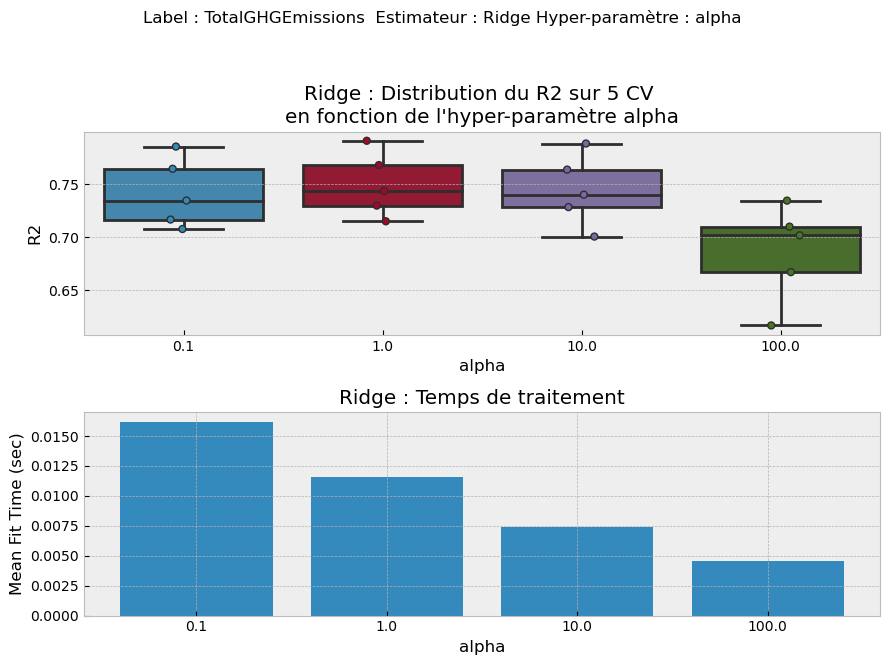

Meilleur(s) hyper-parametre(s) : {'alpha': 1.0}


## TotalGHGEmissions Modèle Lasso itération n 8  



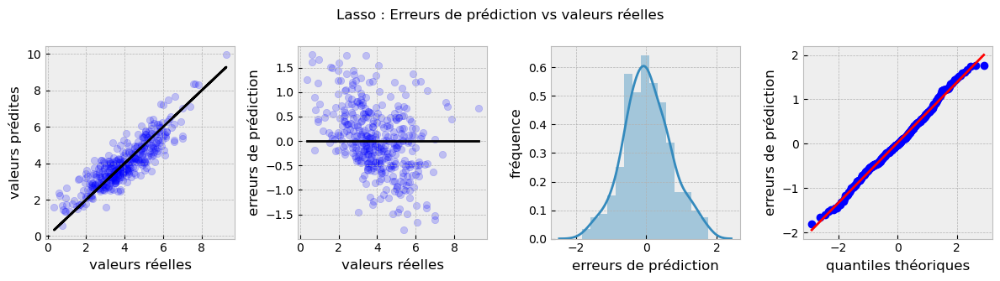

R2 : 0.772
Median absolute error : 0.45
Root mean squarred error : 0.68
Shapiro-Wilk test : 0.99  p-value : 0.15


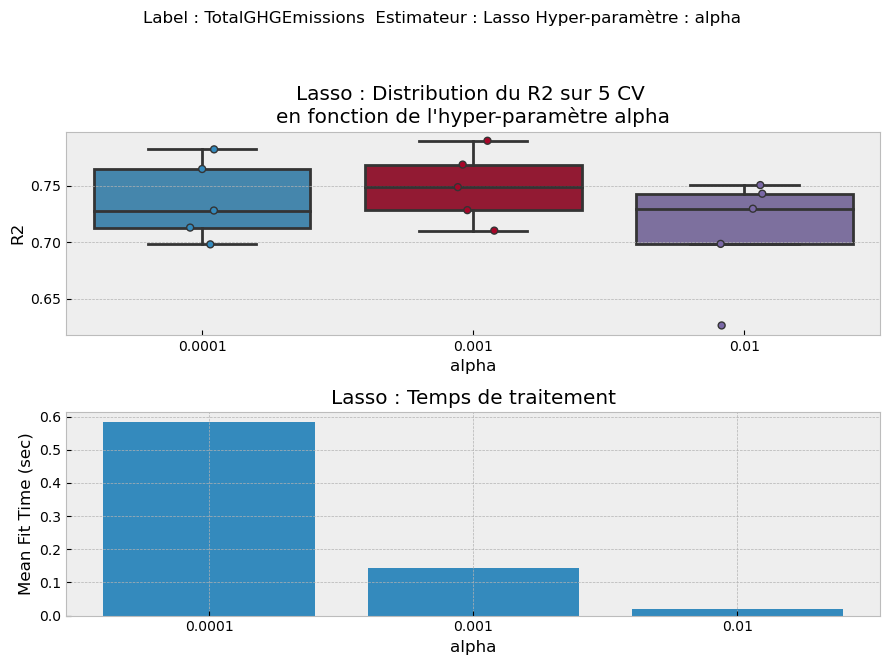

Meilleur(s) hyper-parametre(s) : {'alpha': 0.001}


## TotalGHGEmissions Modèle KNN itération n 8  



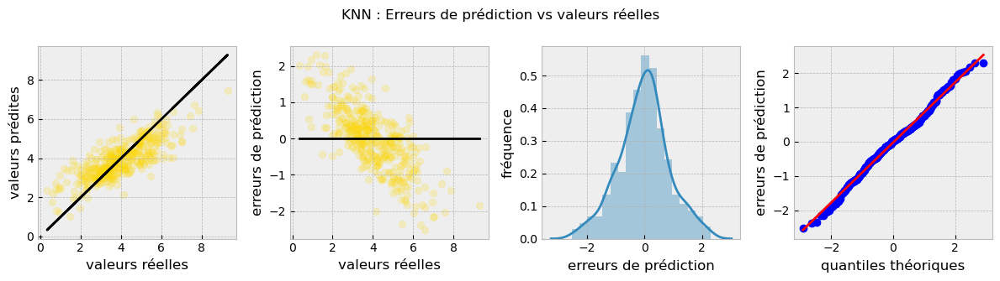

R2 : 0.616
Median absolute error : 0.51
Root mean squarred error : 0.88
Shapiro-Wilk test : 0.99  p-value : 0.07


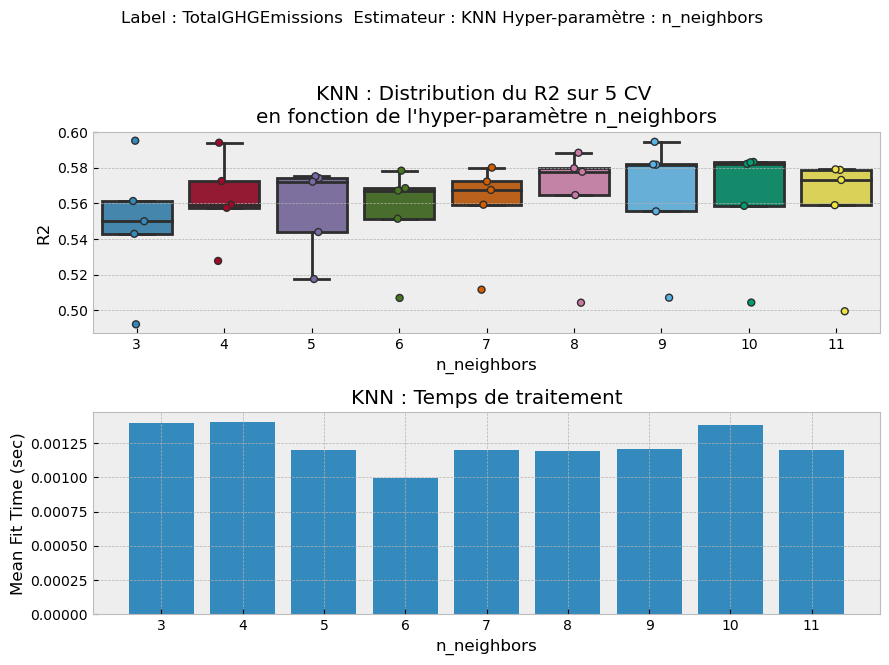

Meilleur(s) hyper-parametre(s) : {'n_neighbors': 9}


## TotalGHGEmissions Modèle SVR itération n 8  



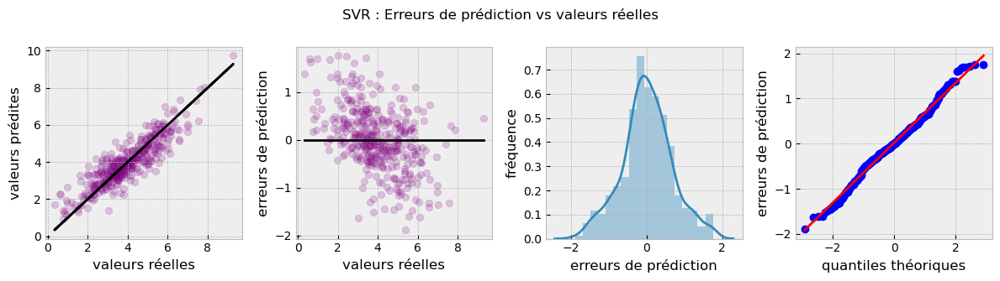

R2 : 0.781
Median absolute error : 0.38
Root mean squarred error : 0.66
Shapiro-Wilk test : 0.99  p-value : 0.02


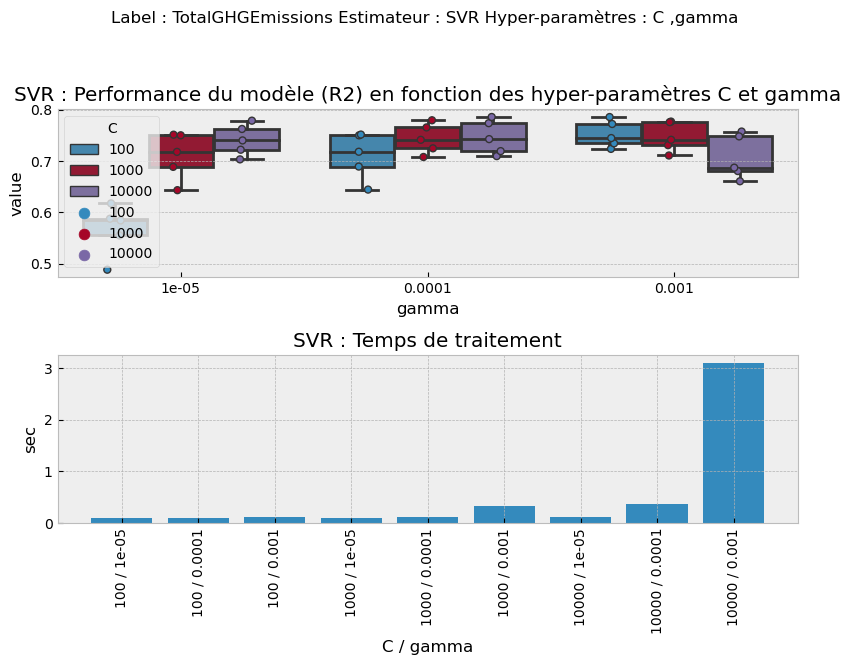

Meilleur(s) hyper-parametre(s) : {'C': 100, 'gamma': 0.001}


## TotalGHGEmissions Modèle RForest itération n 8  



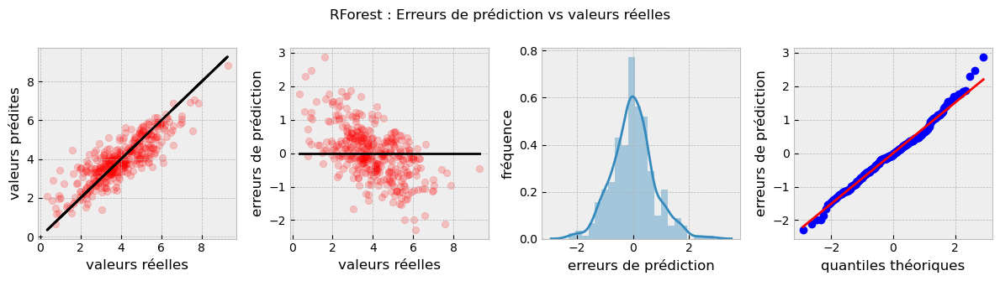

R2 : 0.714
Median absolute error : 0.45
Root mean squarred error : 0.76
Shapiro-Wilk test : 0.99  p-value : 0.0


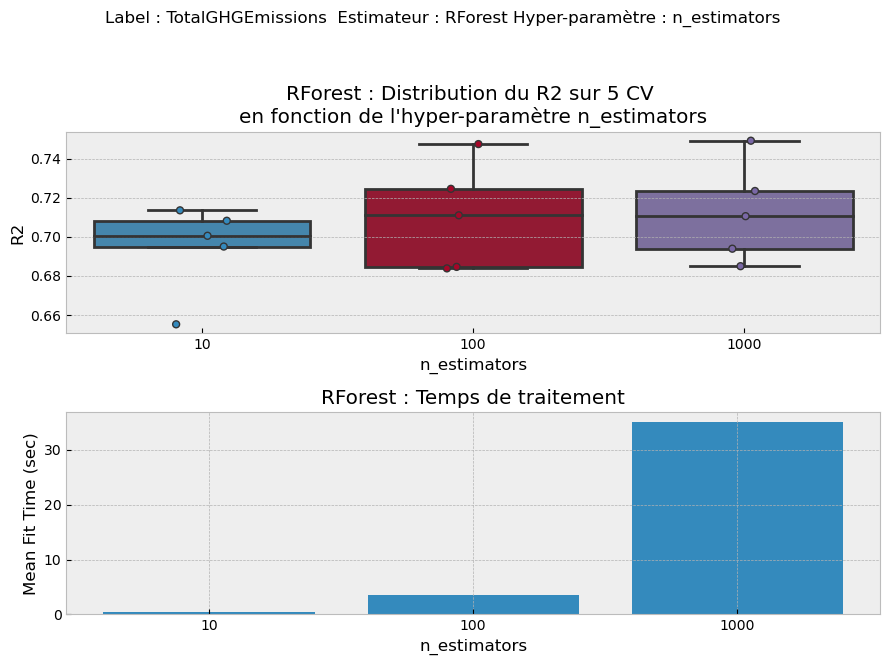

Meilleur(s) hyper-parametre(s) : {'n_estimators': 1000}


## TotalGHGEmissions Modèle Linear Regression itération n 8  



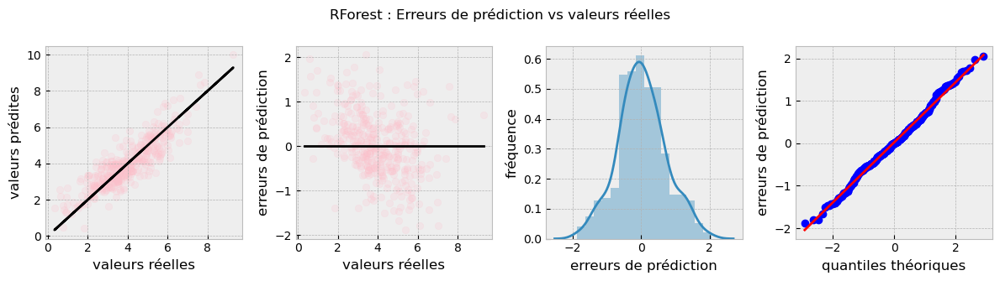

R2 : 0.751
Median absolute error : 0.45
Root mean squarred error : 0.71
Shapiro-Wilk test : 0.99  p-value : 0.13


## TotalGHGEmissions Modèle Ridge itération n 9  



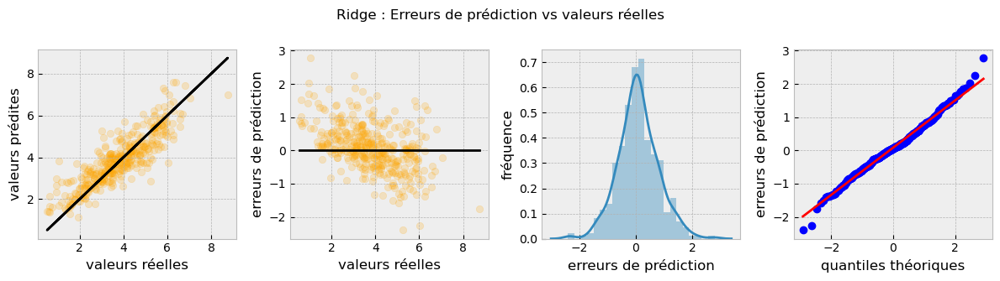

R2 : 0.743
Median absolute error : 0.45
Root mean squarred error : 0.72
Shapiro-Wilk test : 0.99  p-value : 0.02


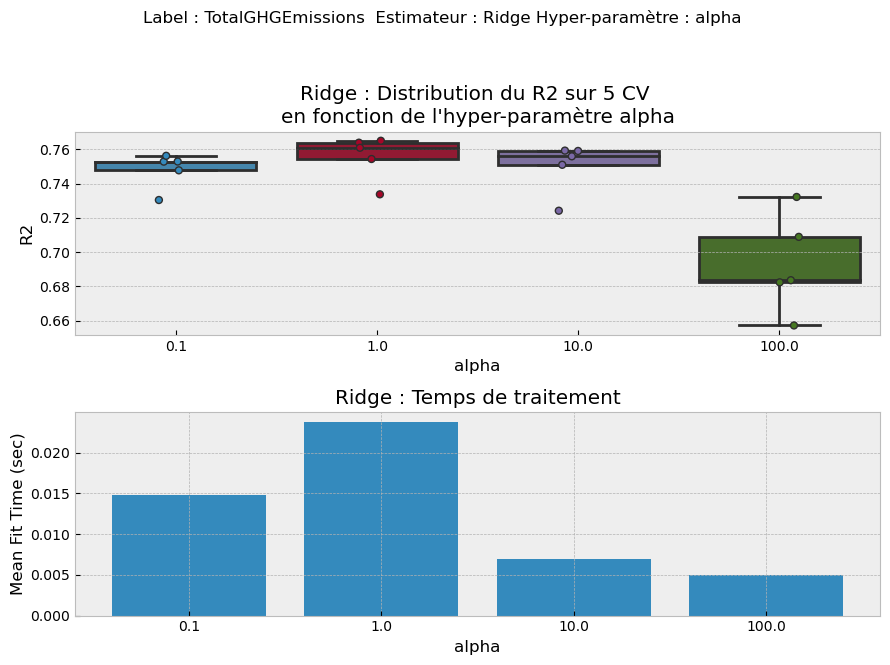

Meilleur(s) hyper-parametre(s) : {'alpha': 1.0}


## TotalGHGEmissions Modèle Lasso itération n 9  



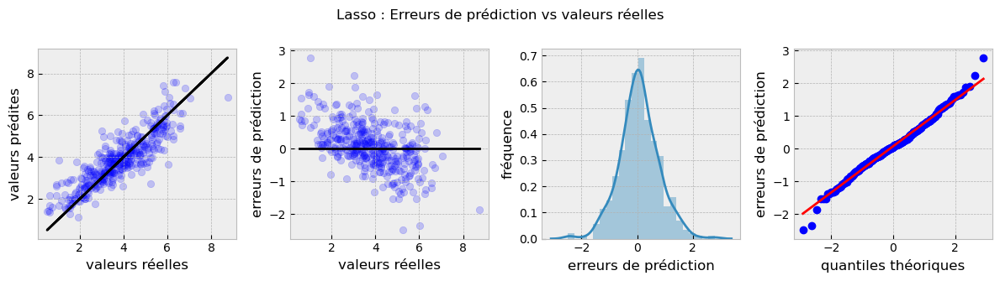

R2 : 0.746
Median absolute error : 0.43
Root mean squarred error : 0.71
Shapiro-Wilk test : 0.99  p-value : 0.01


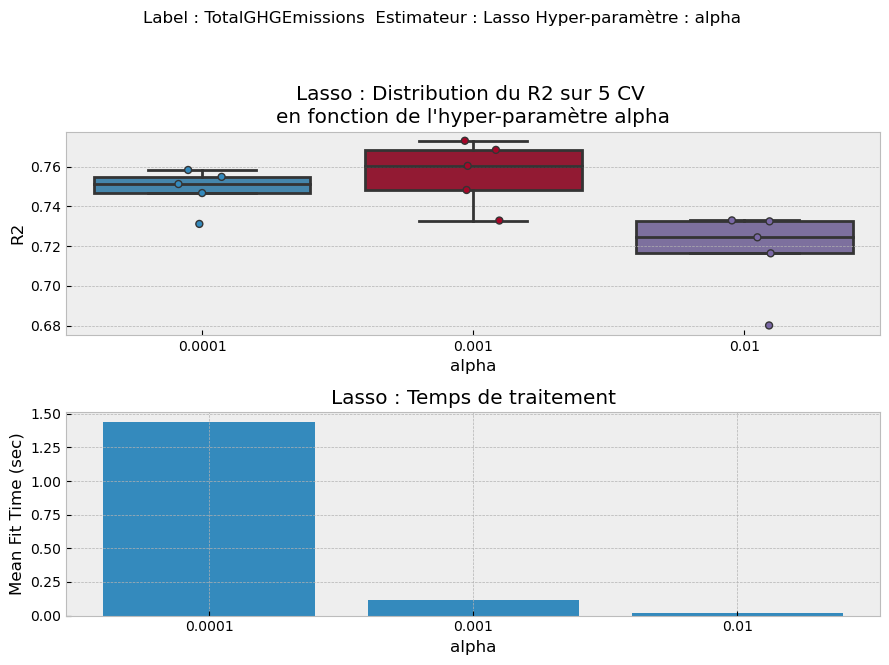

Meilleur(s) hyper-parametre(s) : {'alpha': 0.001}


## TotalGHGEmissions Modèle KNN itération n 9  



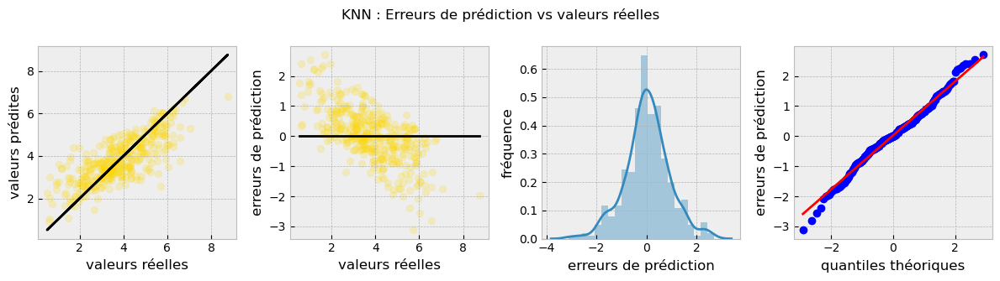

R2 : 0.595
Median absolute error : 0.48
Root mean squarred error : 0.9
Shapiro-Wilk test : 0.99  p-value : 0.0


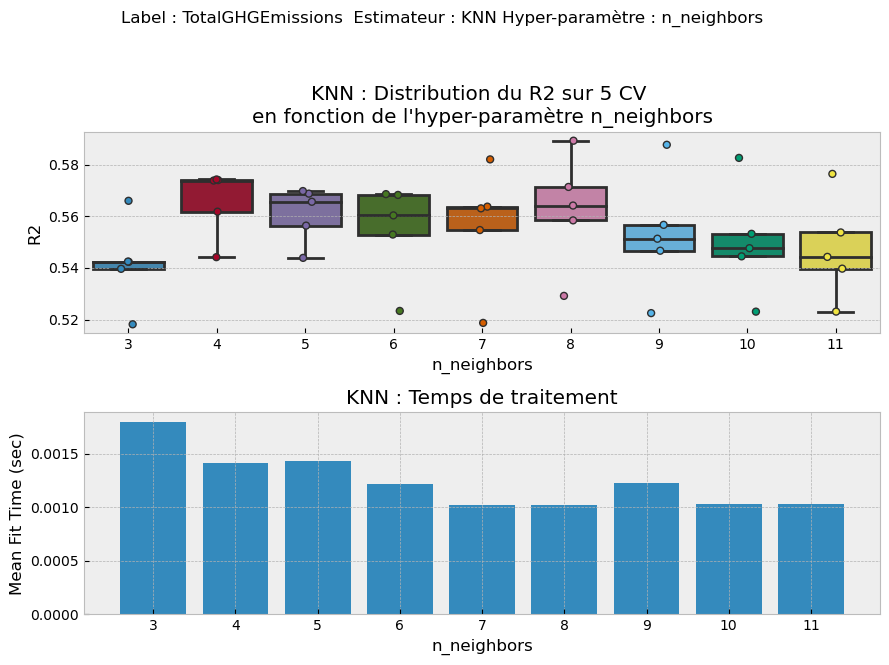

Meilleur(s) hyper-parametre(s) : {'n_neighbors': 4}


## TotalGHGEmissions Modèle SVR itération n 9  



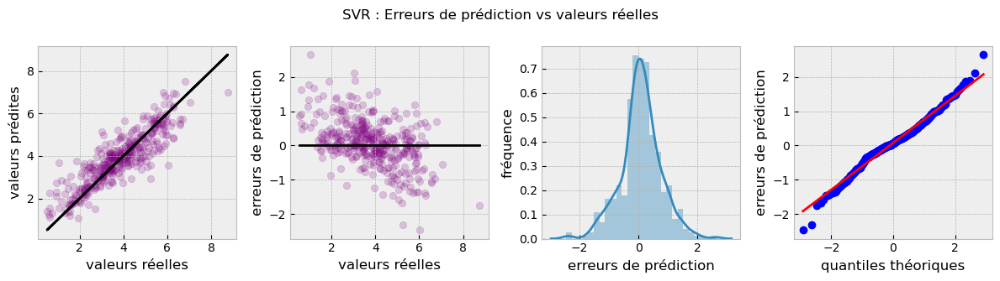

R2 : 0.759
Median absolute error : 0.35
Root mean squarred error : 0.69
Shapiro-Wilk test : 0.98  p-value : 0.0


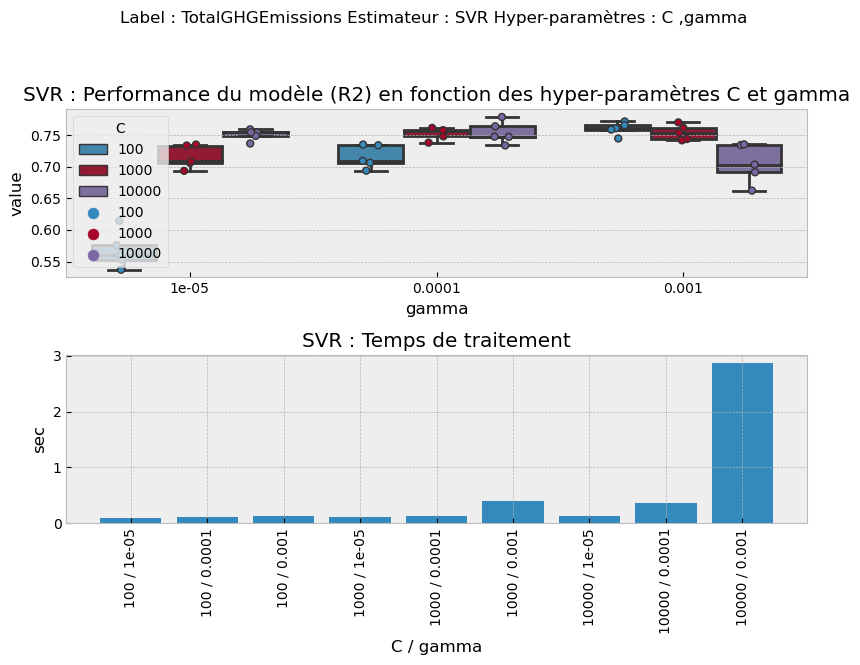

Meilleur(s) hyper-parametre(s) : {'C': 100, 'gamma': 0.001}


## TotalGHGEmissions Modèle RForest itération n 9  



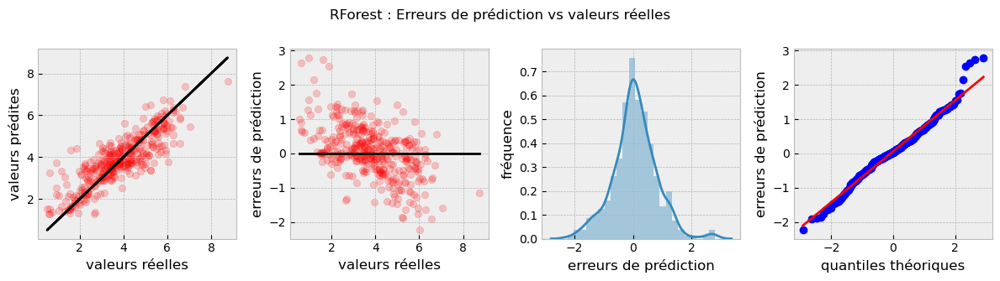

R2 : 0.718
Median absolute error : 0.43
Root mean squarred error : 0.75
Shapiro-Wilk test : 0.98  p-value : 0.0


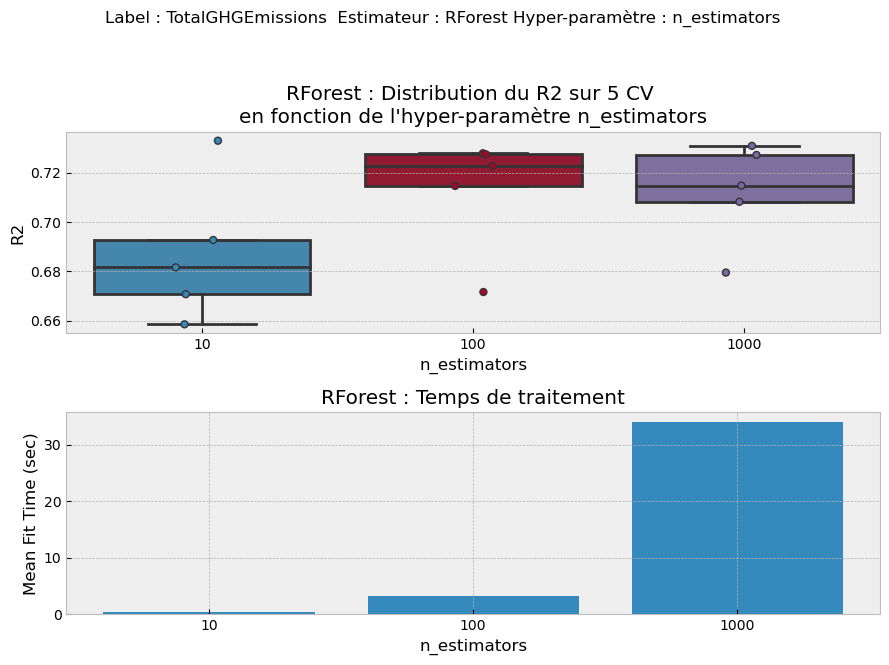

Meilleur(s) hyper-parametre(s) : {'n_estimators': 100}


## TotalGHGEmissions Modèle Linear Regression itération n 9  



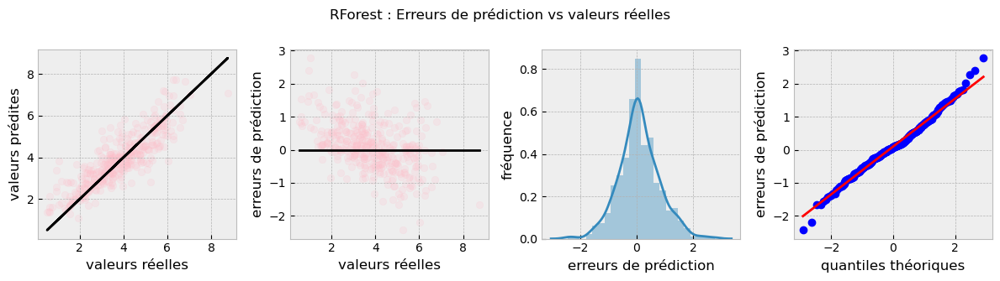

R2 : 0.732
Median absolute error : 0.44
Root mean squarred error : 0.73
Shapiro-Wilk test : 0.99  p-value : 0.01


## TotalGHGEmissions Modèle Ridge itération n 10  



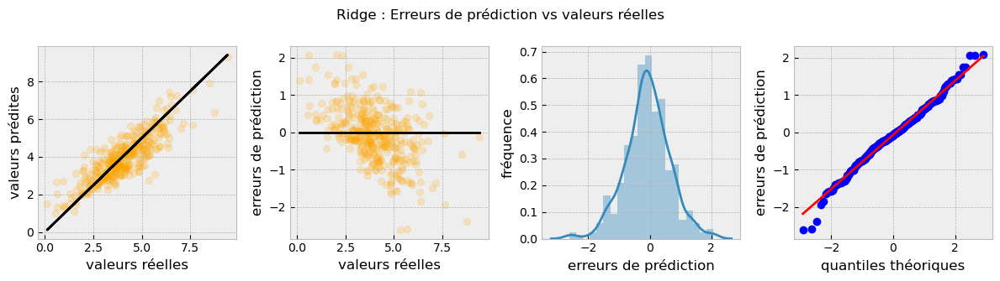

R2 : 0.723
Median absolute error : 0.41
Root mean squarred error : 0.73
Shapiro-Wilk test : 0.99  p-value : 0.01


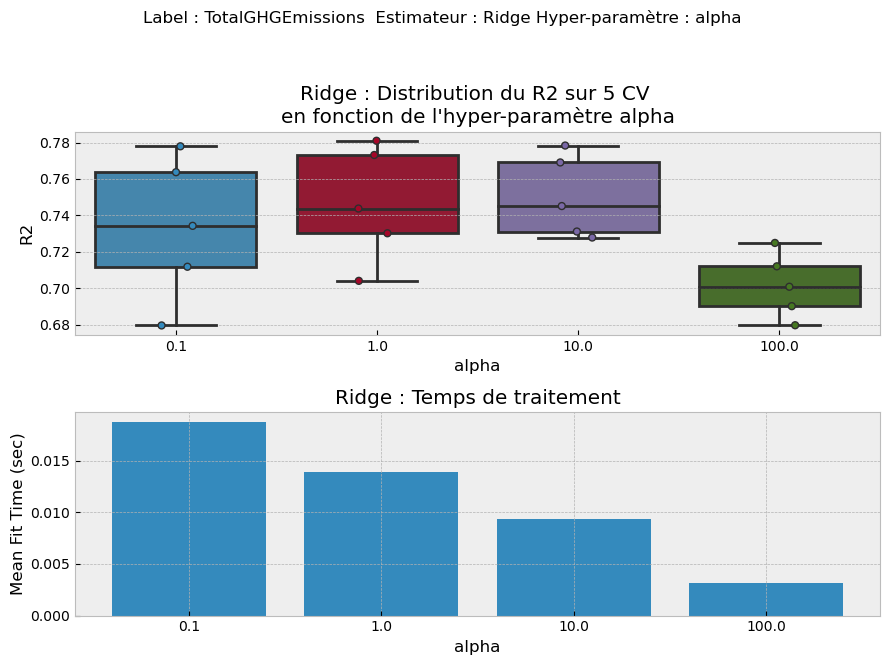

Meilleur(s) hyper-parametre(s) : {'alpha': 10.0}


## TotalGHGEmissions Modèle Lasso itération n 10  



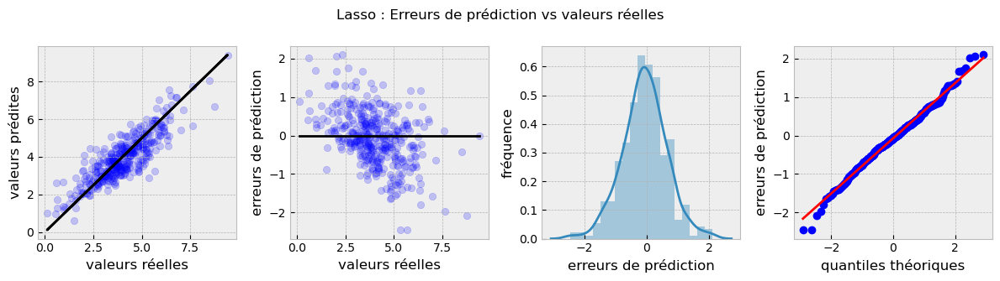

R2 : 0.73
Median absolute error : 0.42
Root mean squarred error : 0.72
Shapiro-Wilk test : 0.99  p-value : 0.09


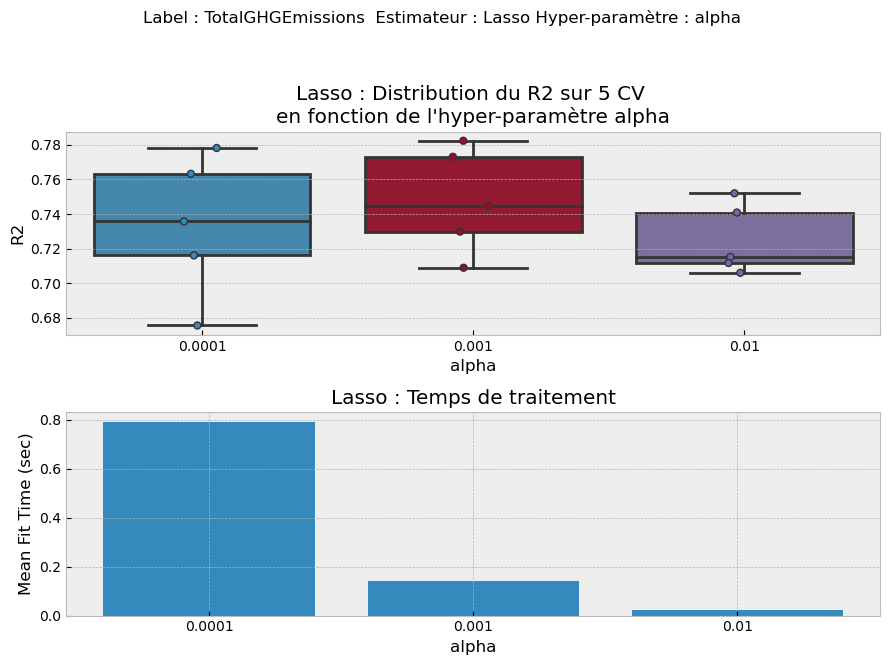

Meilleur(s) hyper-parametre(s) : {'alpha': 0.001}


## TotalGHGEmissions Modèle KNN itération n 10  



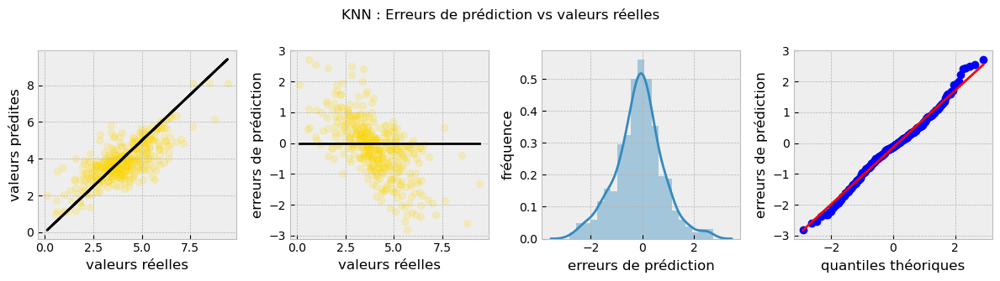

R2 : 0.547
Median absolute error : 0.51
Root mean squarred error : 0.93
Shapiro-Wilk test : 0.99  p-value : 0.01


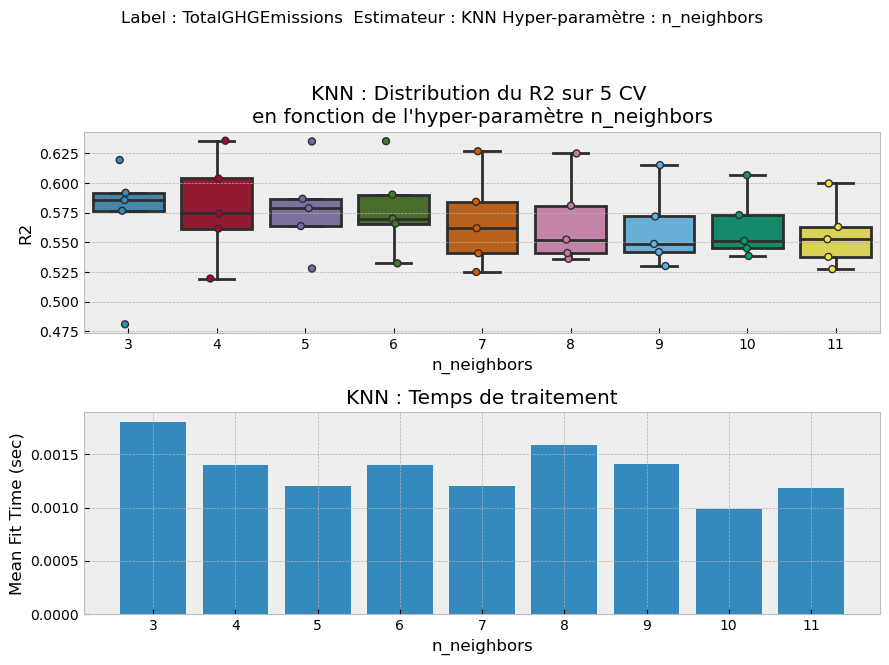

Meilleur(s) hyper-parametre(s) : {'n_neighbors': 4}


## TotalGHGEmissions Modèle SVR itération n 10  



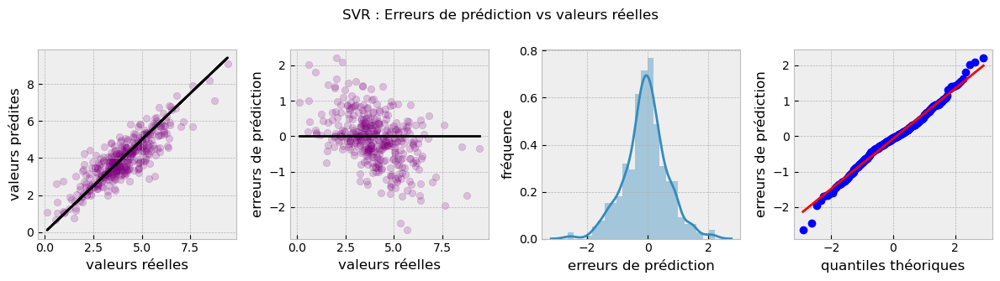

R2 : 0.736
Median absolute error : 0.37
Root mean squarred error : 0.71
Shapiro-Wilk test : 0.99  p-value : 0.0


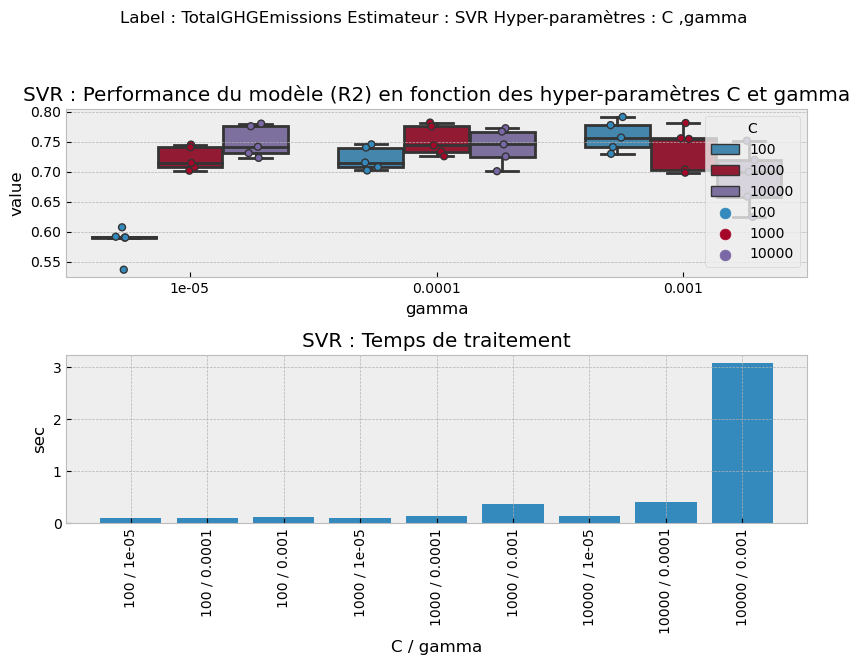

Meilleur(s) hyper-parametre(s) : {'C': 100, 'gamma': 0.001}


## TotalGHGEmissions Modèle RForest itération n 10  



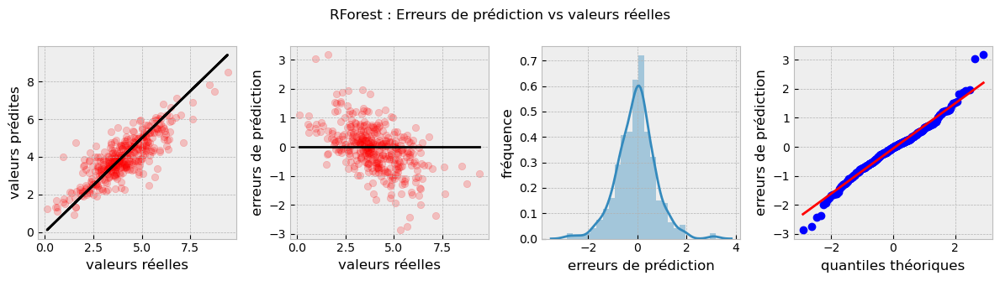

R2 : 0.679
Median absolute error : 0.45
Root mean squarred error : 0.78
Shapiro-Wilk test : 0.98  p-value : 0.0


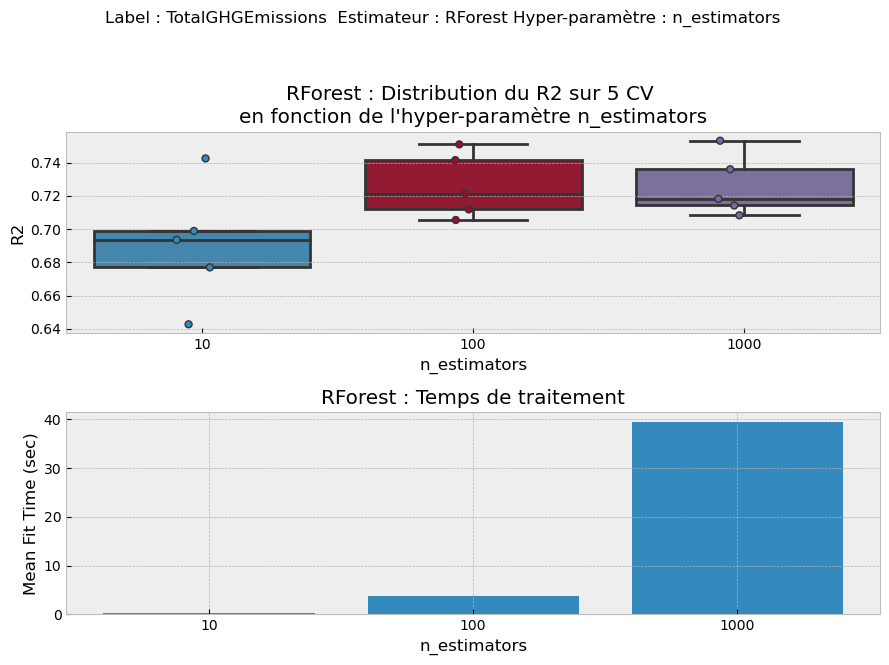

Meilleur(s) hyper-parametre(s) : {'n_estimators': 100}


## TotalGHGEmissions Modèle Linear Regression itération n 10  



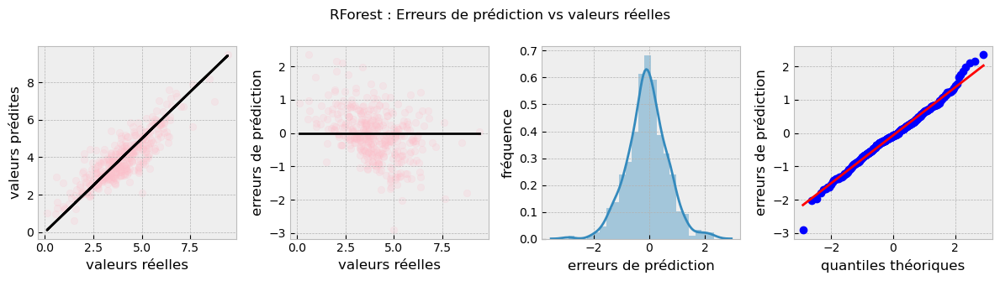

R2 : 0.729
Median absolute error : 0.43
Root mean squarred error : 0.72
Shapiro-Wilk test : 0.99  p-value : 0.02


In [24]:
Srestests=[] #tableau des meilleurs résultats moyens sur X cv, pour chaque combinaison d'hyper parmètres, 
#pour chaque modèle
Sbestpar=[] #tableau des meilleurs hyper-paramètres
Sbestscore=[] #tableau final de Mean cross-validated score of the best_estimator
Stout=[] #tableau où est récupéré l'intégralité des pipelines
StestHP=[] #résultats des hyper-paramètres par CV
Sprm=[] # tableau des paramètres testés
restestsLin=[] # pour les résultats de la régression linéaire, dissociés des autres modèles car pas de GridSearchCV
NomL='Linear Regression'
for i in range(NbTests):    #Nombre d'iterations
    restests=[] 
    bestpar=[]
    bestscore=[] 
    tout=[]
    GtestHP=[]
    prm=[]
    X=datafinal.loc[:,datafinal.columns[np.isin(datafinal.columns,ColTot)]]
    Y=datafinal[label]
    X_train, X_test, y_train, y_test=model_selection.train_test_split(X,Y, test_size=0.25)
    PipeCat=pipeline.make_pipeline(preprocessing.OneHotEncoder(handle_unknown='ignore'))
    PipeNum=pipeline.make_pipeline(impute.KNNImputer(), preprocessing.StandardScaler())
    PipeAll=compose.ColumnTransformer(transformers=[('cat',PipeCat, CCat),('num', PipeNum,CNum)])    
    for j in range(len(Modeles)):  #une boucle par modèle 
        co=Couleur[j]
        Algo=Modeles[j]
        Nom=NomMod[j]
        Pipe=pipeline.make_pipeline(PipeAll, Algo)
        Pipe.fit(X_train, y_train)
        y_pred=Pipe.predict(X_test)
        display(Markdown('## {} Modèle {} itération n {}  \n\n'.format(label,Nom, i+1)))
        evaluation(y_test,y_pred, Nom,co)
        shap=stats.shapiro(y_pred-y_test) #test de normalité
        print("R2 : {}".format(round(metrics.r2_score(y_test,y_pred),3)))
        print("Median absolute error : {}".format(round(metrics.median_absolute_error(y_test,y_pred),2)))
        print("Root mean squarred error : {}".format(round(np.sqrt(metrics.mean_squared_error(y_test,y_pred)),2)))
        print("Shapiro-Wilk test : {}  p-value : {}".\
              format (round(shap[0],2),round(shap[1],2)))
        testHP=[]  # resultats de R2 de chaque hyperparamètre pour chaque CV
        for cv in range (CrVa):
            nom ='split{}_test_score'.format(cv)
            testHP.append(Pipe[1].cv_results_[nom])
        GtestHP.append(np.swapaxes(testHP,0,1))
        HyperP(Nom, Pipe) #affichage des graphs
        restests.append(Pipe[1].cv_results_['mean_test_score'])
        bestpar.append(Pipe[1].best_params_)
        bestscore.append(Pipe[1].best_score_)
        tout.append(Pipe)
        prm.append(Pipe[1].cv_results_['params'])
    Srestests.append(restests)
    Sbestpar.append(bestpar)
    Sbestscore.append(bestscore)
    Stout.append(tout)
    StestHP.append(GtestHP)
    Sprm.append(prm)    
    #partie pour la regression linéaire, traitée à part
    co='pink'
    Pipe=pipeline.make_pipeline(PipeAll, Lin)
    Pipe.fit(X_train, y_train)
    y_pred=Pipe.predict(X_test)
    display(Markdown('## {} Modèle {} itération n {}  \n\n'.format(label,NomL, i+1)))
    evaluation(y_test,y_pred, Nom,co)
    shap=stats.shapiro(y_pred-y_test)
    print("R2 : {}".format(round(metrics.r2_score(y_test,y_pred),3)))
    print("Median absolute error : {}".format(round(metrics.median_absolute_error(y_test,y_pred),2)))
    print("Root mean squarred error : {}".format(round(np.sqrt(metrics.mean_squared_error(y_test,y_pred)),2)))
    print("Shapiro-Wilk test : {}  p-value : {}".format (round(shap[0],2),round(shap[1],2)))
    restestsLin.append(round(metrics.r2_score(y_test,y_pred),3))

### Evaluation des hyper-paramètres

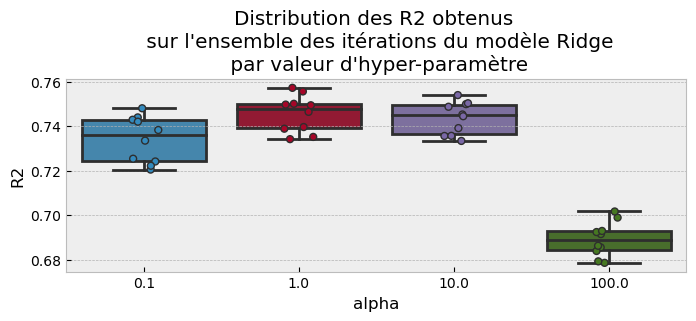

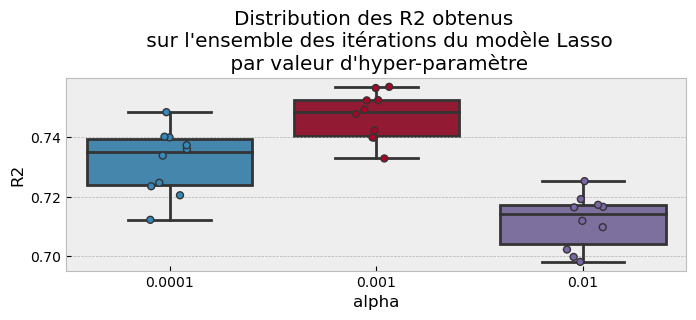

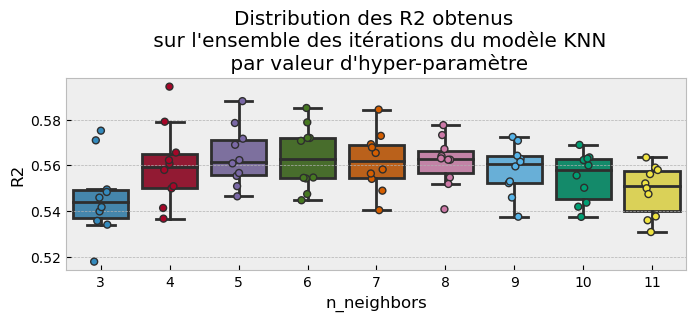

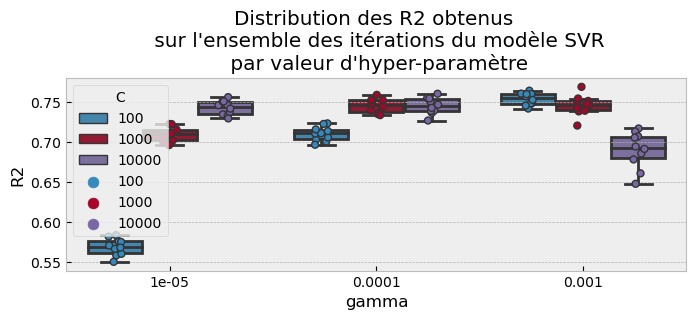

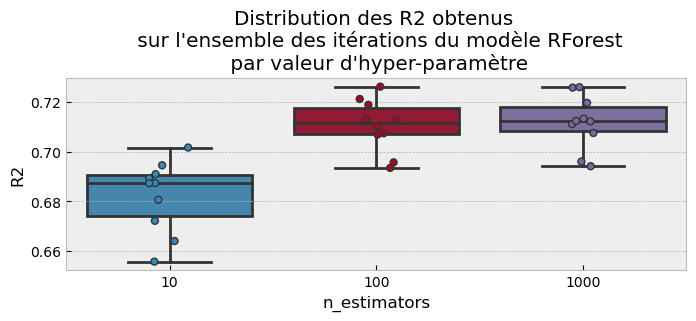

In [25]:
for n in range(len(Modeles)):
    plt.figure(figsize=[8,2.5])
    ValTests=pd.DataFrame(np.swapaxes(Srestests,0,1)[n].tolist()).T #tableau des R2 moyens par hyperparamètre
    ValHP=pd.DataFrame(Sprm[0][n])   #tableau des hyper-paramètres
    if ValHP.shape[1]==1:   # pour les modèles à 1 hyper-paramètre
        ValT=ValHP.join(ValTests)
        ValT2=pd.melt(ValT, id_vars=ValT.columns[0])
        sns.boxplot(data=ValT2, y='value', x=ValT.columns[0], fliersize=0)
        sns.stripplot(data=ValT2, y='value', x=ValT.columns[0], linewidth=1)
    elif ValHP.shape[1]==2: # modèles à 2 hyper-paramètres
        ValTests[pd.DataFrame(np.swapaxes(Sprm,0,1)[n][0]).columns[:2]]=ValHP.iloc[:,:2]
        VMelt=pd.melt(ValTests, id_vars=[ValTests.columns[-1],ValTests.columns[-2]])
        #plt.figure(figsize=[15,6])
        sns.boxplot(data=VMelt, y='value', x=VMelt.columns[0], hue=VMelt.columns[1], fliersize=0)
        sns.stripplot(data=VMelt, y='value', x=VMelt.columns[0], hue=VMelt.columns[1], dodge=True, linewidth=1)
    plt.ylabel('R2')
    plt.title("Distribution des R2 obtenus \n sur l'ensemble des itérations du modèle {}\n par valeur d'hyper-paramètre".\
              format(NomMod[n]))
    plt.show()

### Graphiques d'évaluation finale

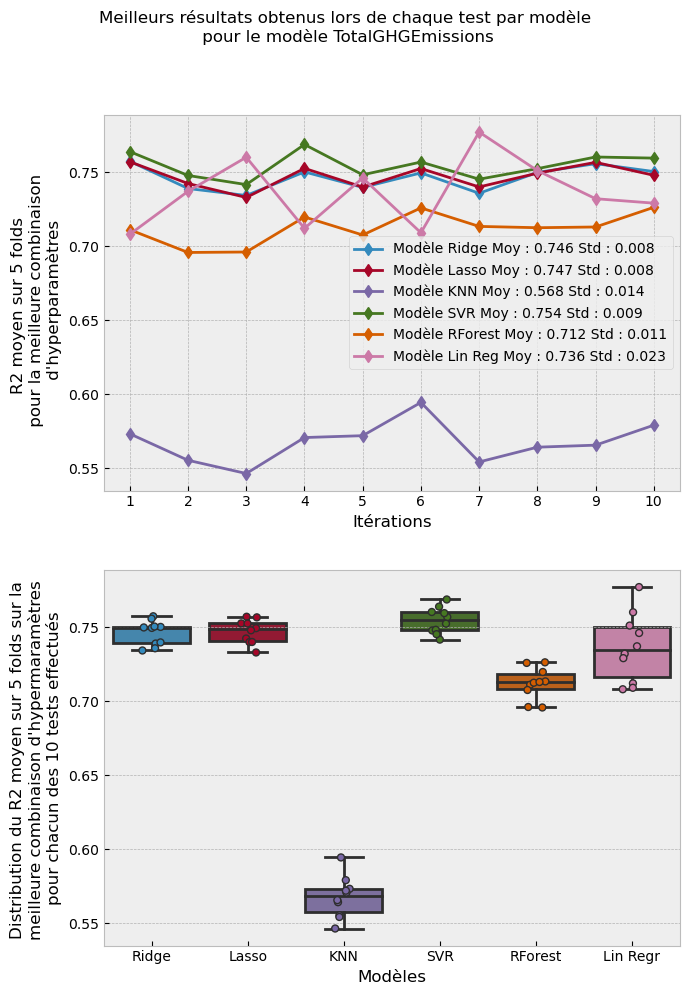

Colonnes numériques : ['OSEBuildingID', 'YearBuilt', 'NumberofBuildings', 'NumberofFloors', 'PropertyGFATotal', 'PropertyGFAParking', 'PropertyGFABuilding(s)', 'LargestPropertyUseTypeGFA', 'SecondLargestPropertyUseTypeGFA', 'ThirdLargestPropertyUseTypeGFA', 'ENERGYSTARScore', 'NumberofMainUseType', 'NumberofAllUseType', 'SurfEtaMoy', 'SurfBatMoy', 'SumLarSecThiGFA', 'PropBuildingsGFA']

Colonnes catégorielles : ['BuildingType', 'PrimaryPropertyType', 'LargestPropertyUseType', 'SecondLargestPropertyUseType', 'ThirdLargestPropertyUseType', 'Outlier', 'IndicSteamUse', 'IndicNaturalGas', 'IndicParking', 'typeThi', 'PrimEqualLarg']


In [26]:
NomMod2=NomMod.copy()
NomMod2.append('Lin Regr')
plt.subplots(1,2,figsize=[7,9])
plt.suptitle('Meilleurs résultats obtenus lors de chaque test par modèle\n pour le modèle {}'.format(label), y=1.1)
plt.subplot(211) #format avec courbe
zzz=pd.DataFrame(Sbestscore)
zzz.columns=NomMod
zzz['Lin Reg']=restestsLin
zzzT=zzz.T
lb=[]
for i in range(len(zzzT)):
    lb.append('Modèle {} Moy : {} Std : {}'.\
              format(zzzT.index[i], round(zzzT.mean(axis=1)[i],3),round(zzzT.std(axis=1)[i],3)))
plt.plot(zzz, marker='d')
plt.legend(NomMod)
plt.xticks(np.arange(0,NbTests,1),np.arange(1,NbTests+1,1))
plt.xlabel('Itérations')
plt.ylabel("R2 moyen sur {} folds \n pour la meilleure combinaison\n d'hyperparamètres".format(CrVa))
plt.legend(lb)
plt.subplot(212) # format avec boxplot
sns.boxplot(data=zzzT.T, fliersize=0)
sns.stripplot(data=zzzT.T, linewidth=1)
plt.xlabel('Modèles')
plt.ylabel("Distribution du R2 moyen sur {} folds sur la \nmeilleure \
combinaison d'hypermaramètres \npour chacun des {} tests effectués".format(CrVa,NbTests))
plt.xticks(np.arange(0, len(Modeles)+1,1),NomMod2)
plt.tight_layout()
plt.show()
print('Colonnes numériques : {}\n'.format(CNum))
print('Colonnes catégorielles : {}'.format(CCat))

### Etude des résidus et des coefficients

In [27]:
Las=linear_model.Lasso(max_iter=100000,alpha=0.001) #nouveau modèle sans gridsearchcv pour pouvoir récuperer les coefs
Rid= linear_model.Ridge(alpha=1)
Mo=[Las, Rid]
N=['Lasso','Ridge']
alph=[0,0]
alphas=[alphasLas, alphasRid]
lab=labels

## Modèle Lasso Label :SiteEnergyUse(kBtu)


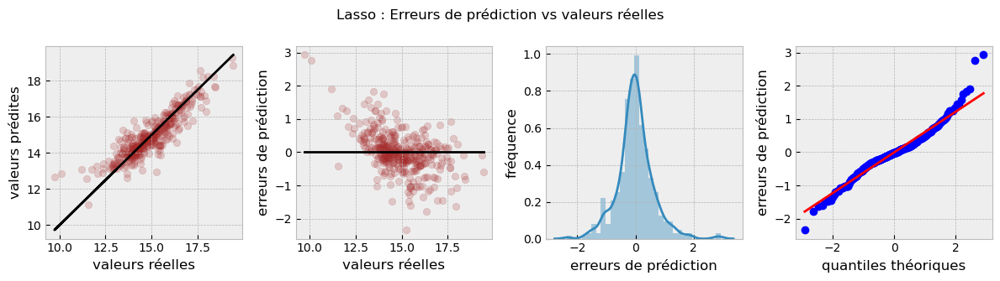

R2 : 0.8
Median absolute error : 0.3
Root mean squarred error : 0.62
Shapiro-Wilk test : 0.96  p-value : 0.0


## Modèle Lasso Label :TotalGHGEmissions


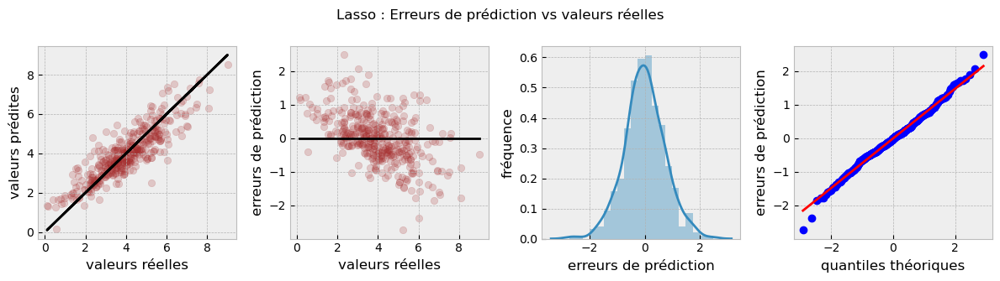

R2 : 0.76
Median absolute error : 0.46
Root mean squarred error : 0.74
Shapiro-Wilk test : 0.99  p-value : 0.16


## Modèle Ridge Label :SiteEnergyUse(kBtu)


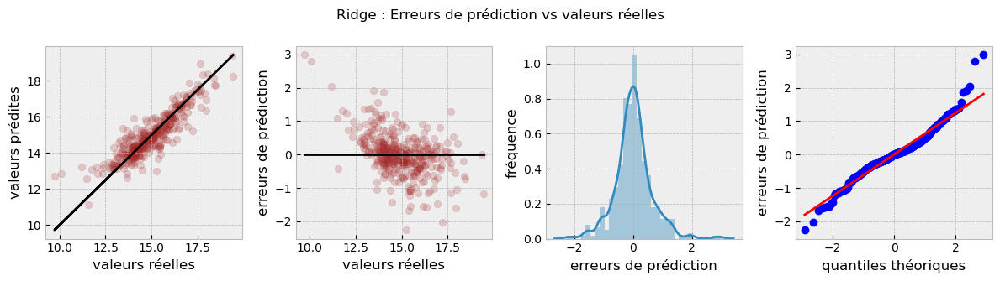

R2 : 0.79
Median absolute error : 0.3
Root mean squarred error : 0.63
Shapiro-Wilk test : 0.96  p-value : 0.0


## Modèle Ridge Label :TotalGHGEmissions


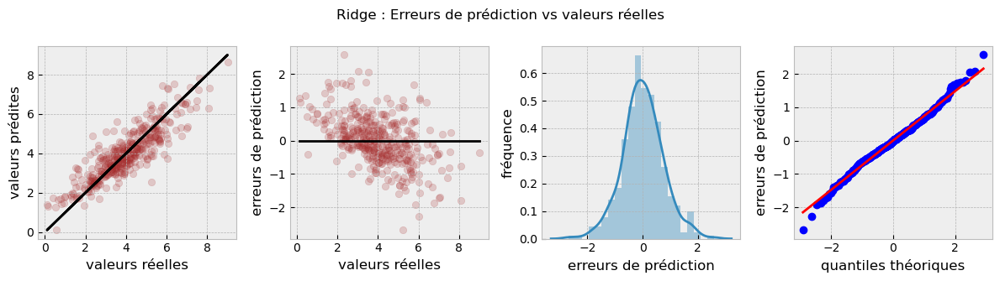

R2 : 0.76
Median absolute error : 0.45
Root mean squarred error : 0.74
Shapiro-Wilk test : 0.99  p-value : 0.06


In [28]:
X2=datafinal.loc[:,datafinal.columns[np.isin(datafinal.columns,ColTot)]]
Y2=datafinal[lab]
X_train2, X_test2, y_train2, y_test2=model_selection.train_test_split(X2,Y2, test_size=0.25)
PipeCat=pipeline.make_pipeline(preprocessing.OneHotEncoder(handle_unknown='ignore'))
PipeNum=pipeline.make_pipeline(impute.KNNImputer(), preprocessing.StandardScaler())
PipeOrd=pipeline.make_pipeline(impute.KNNImputer(),preprocessing.StandardScaler())
PipeAll=compose.ColumnTransformer(transformers=[('cat',PipeCat, CCat),('num', PipeNum,CNum),])
tab_ypred=[]
coefs2=[]
for i in range(2): #modele
    for j in range(2): #label
        Pipe2=pipeline.make_pipeline(PipeAll, Mo[i])
        Pipe2.fit(X_train2, y_train2.iloc[:,j])
        coefs2.append(Pipe2[1].coef_)
        y_pred2=Pipe2.predict(X_test2)        
        tab_ypred.append(y_pred2)
        display(Markdown('## Modèle {} Label :{}\n'.format(N[i],lab[j])))
        evaluation(y_test2.iloc[:,j],y_pred2, N[i],'brown')
        shap=stats.shapiro(y_pred2-y_test2.iloc[:,j])
        print("R2 : {}".format(round(metrics.r2_score(y_test2.iloc[:,j],y_pred2),2)))
        print("Median absolute error : {}".format(round(metrics.median_absolute_error(y_test2.iloc[:,j],y_pred2),2)))
        print("Root mean squarred error : {}".format\
              (round(np.sqrt(metrics.mean_squared_error(y_test2.iloc[:,j],y_pred2)),2)))
        print("Shapiro-Wilk test : {}  p-value : {}".format (round(shap[0],2),round(shap[1],2)))
TabFeat=[] # récupération du nom des features
a=0
for colonne in Pipe2[0].transformers_[0][1][0].categories_: #acces au OneHotEncoder pour récupérer les catégories
    for categorie in colonne :
        TabFeat.append('{}_{}'.format(CCat[a], categorie)) #création du nom des features au format variable_categorie
    a=a+1
FinFeat=TabFeat+CNum
DfCoefs=pd.DataFrame({'Variables':FinFeat, 'LassoEU':coefs2[0],\
                      'LassoGHG':coefs2[1],'RidgeEU':coefs2[2],'RidgeGHG':coefs2[3]})
DfCoefs=DfCoefs.set_index('Variables')
DfCoefs['LassoEU_Abs']=DfCoefs['LassoEU'].abs() #on prend la valeur absolue des coefficients pour les classer ensuite
DfCoefs['LassoGHG_Abs']=DfCoefs['LassoGHG'].abs()
DfCoefs['RidgeEU_Abs']=DfCoefs['RidgeEU'].abs()
DfCoefs['RidgeGHG_Abs']=DfCoefs['RidgeGHG'].abs()

### Création d'un df avec les colonnes de y_pred

In [29]:
DfResid=X_test2.copy()
DfResid=DfResid.join(y_test2)
DfResid['y_pred_EU_Lasso']=tab_ypred[0]
DfResid['y_pred_GHG_Lasso']=tab_ypred[1]
DfResid['y_pred_EU_Ridge']=tab_ypred[2]
DfResid['y_pred_GHG_Ridge']=tab_ypred[3]
DfResid['ecart_EU_Lasso']=DfResid['y_pred_EU_Lasso']-DfResid['SiteEnergyUse(kBtu)']
DfResid['ecart_GHG_Lasso']=DfResid['y_pred_GHG_Lasso']-DfResid['TotalGHGEmissions']
DfResid['ecart_EU_Ridge']=DfResid['y_pred_EU_Ridge']-DfResid['SiteEnergyUse(kBtu)']
DfResid['ecart_GHG_Ridge']=DfResid['y_pred_GHG_Ridge']-DfResid['TotalGHGEmissions']

### Graphs d'analyse des résidus par variables

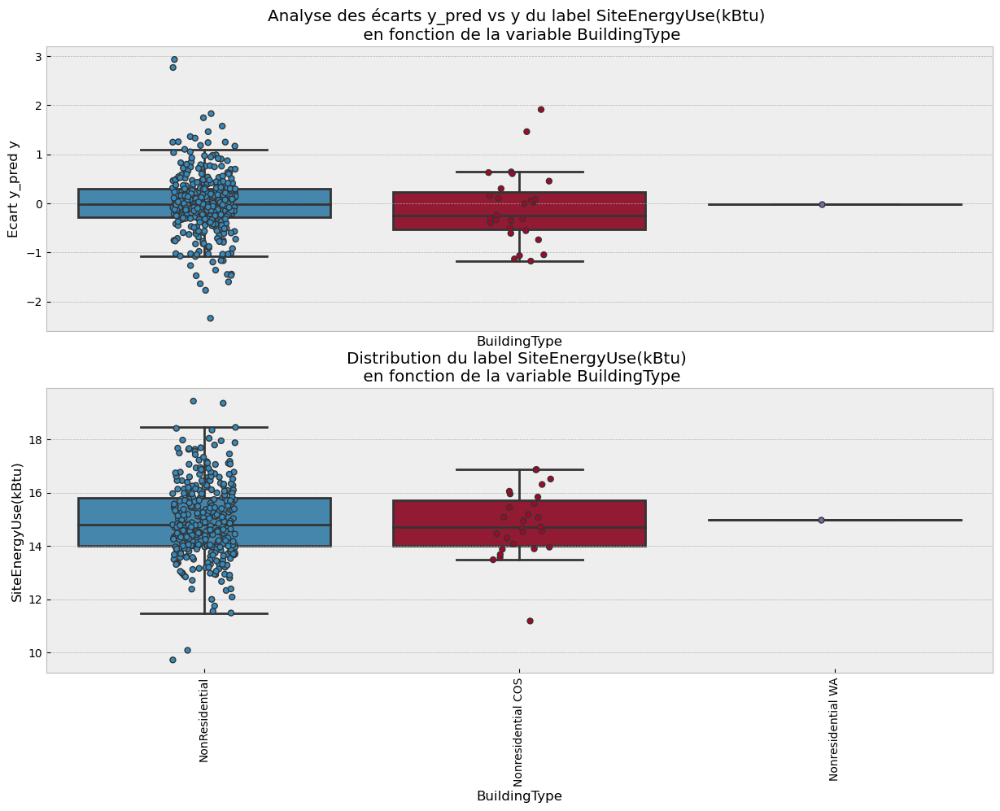

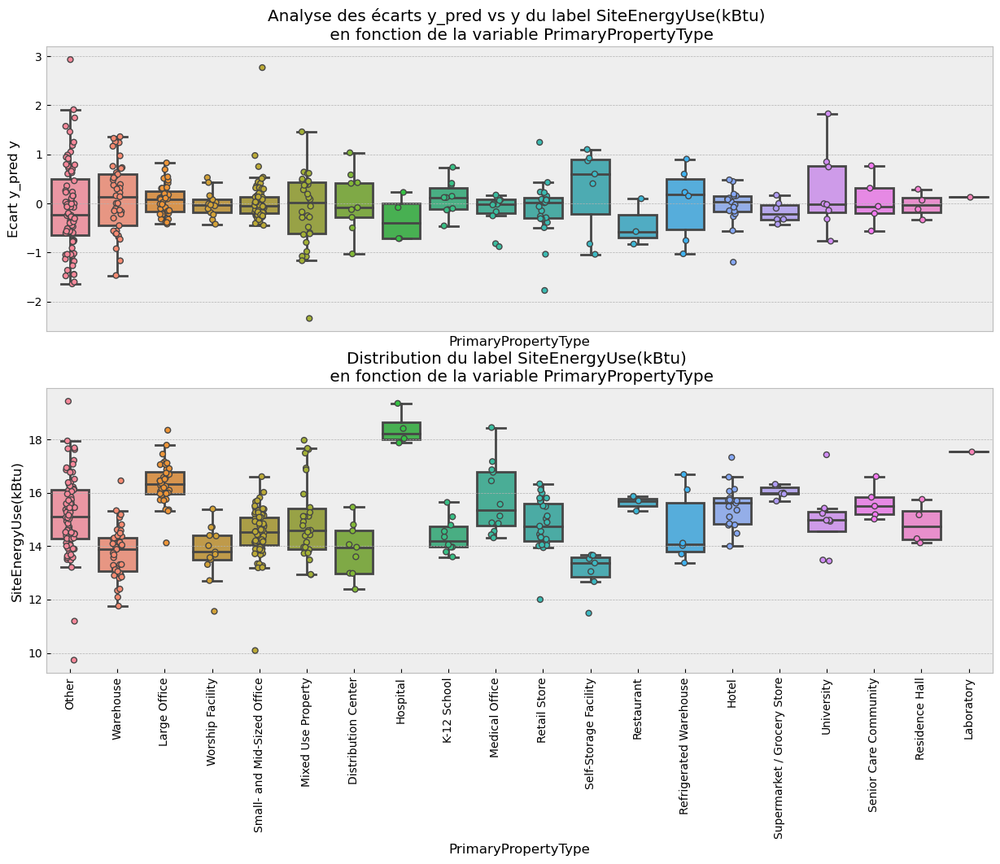

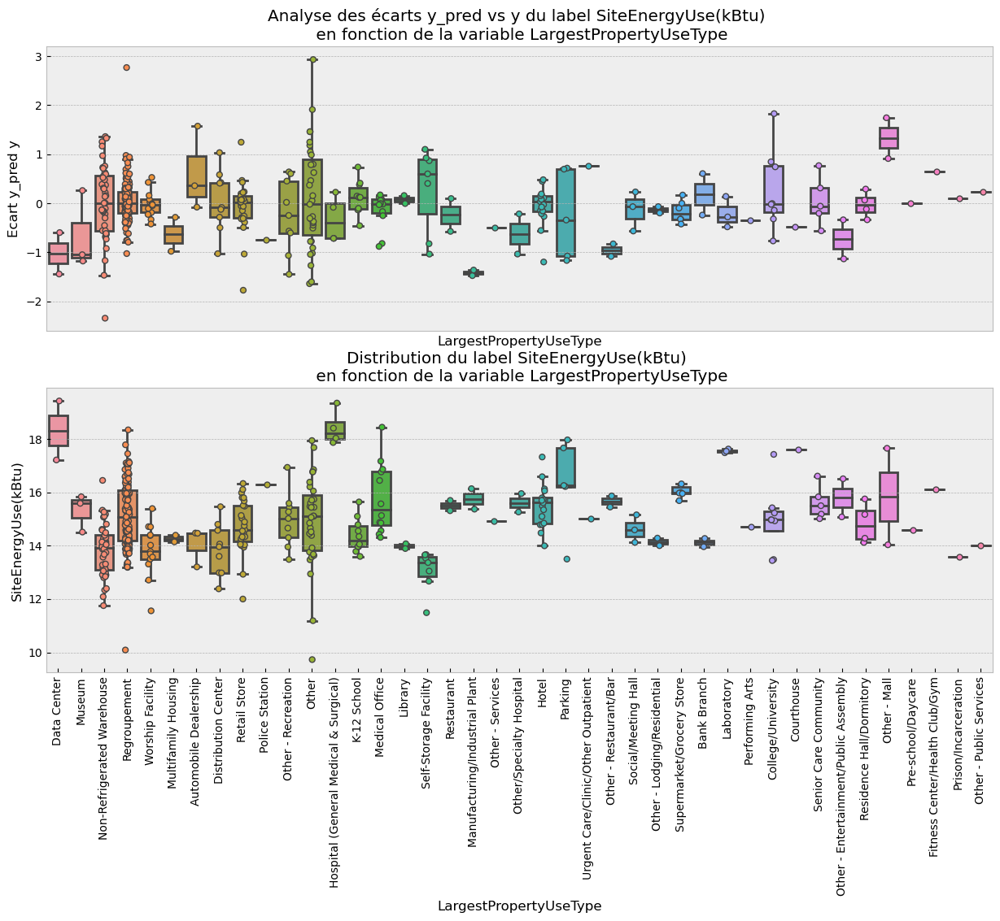

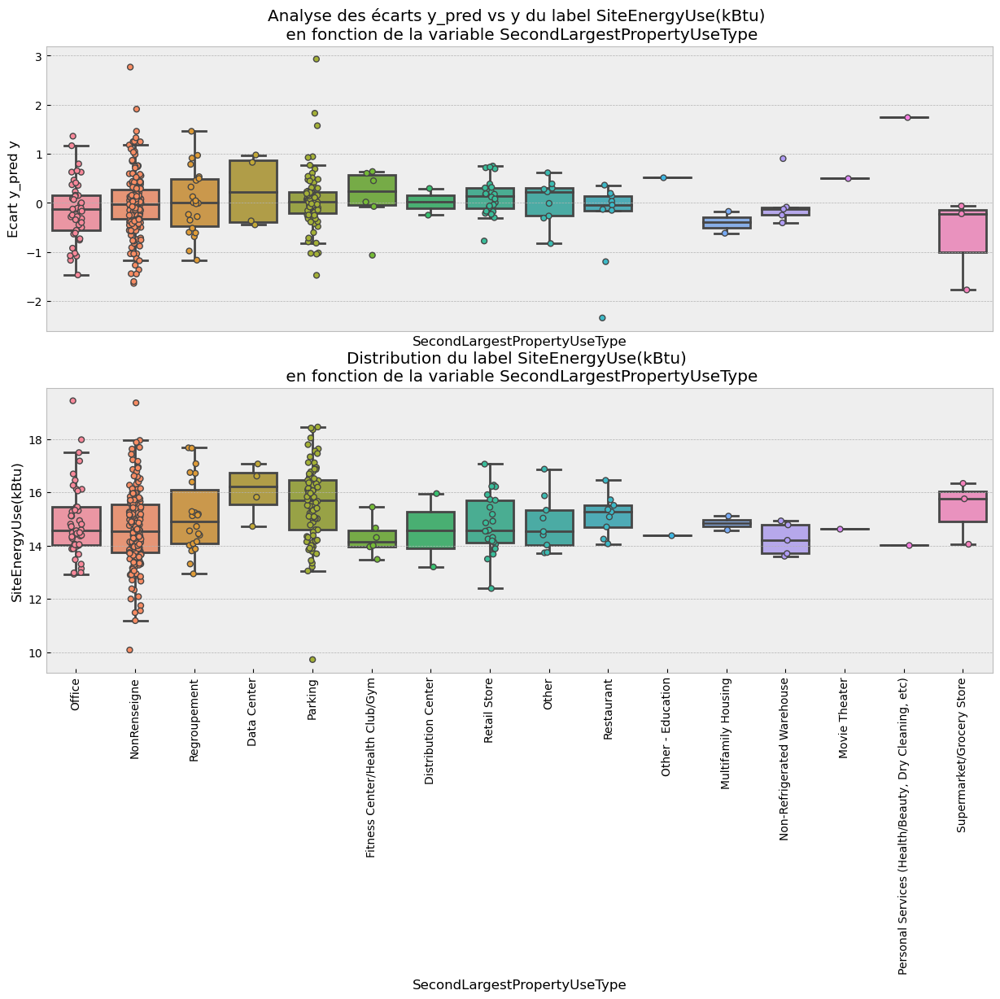

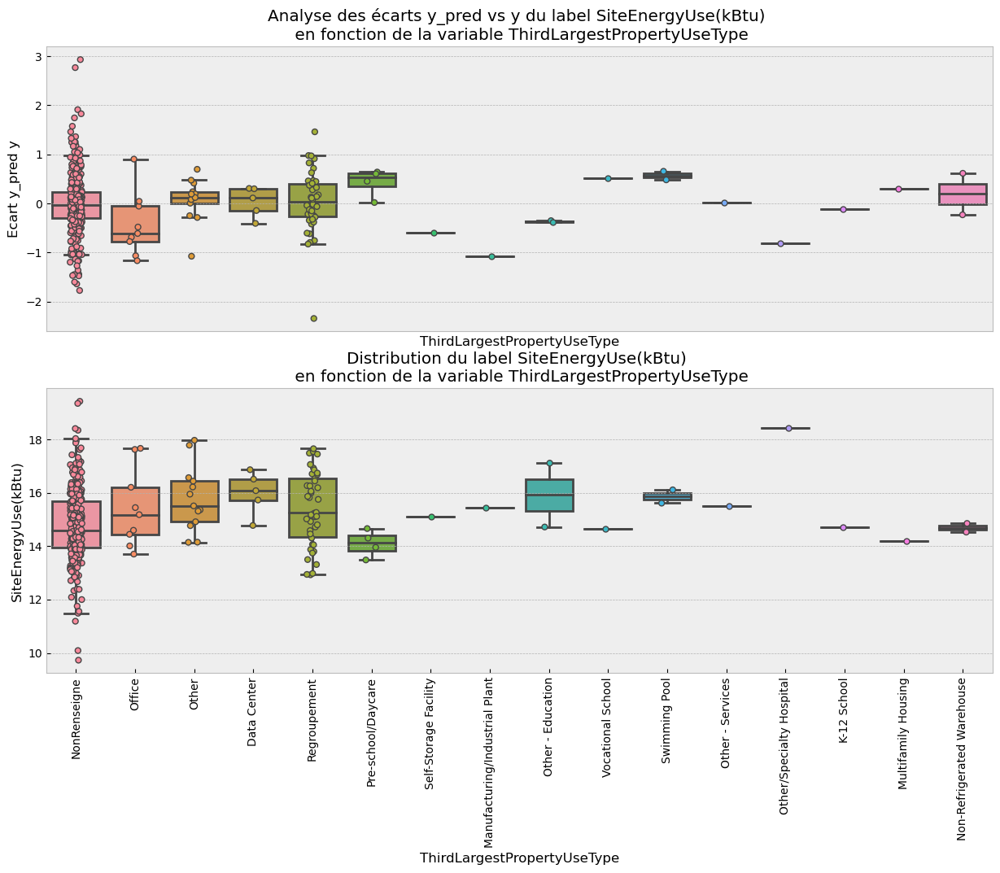

...

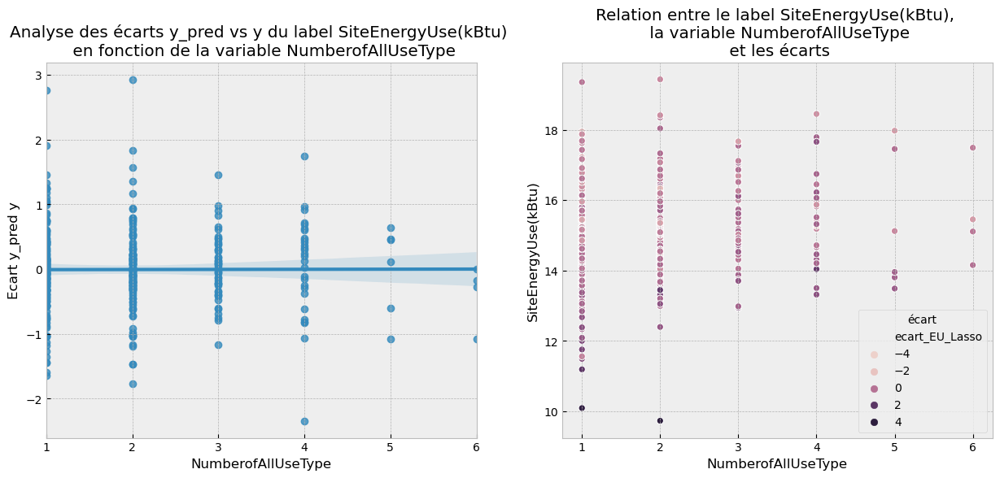

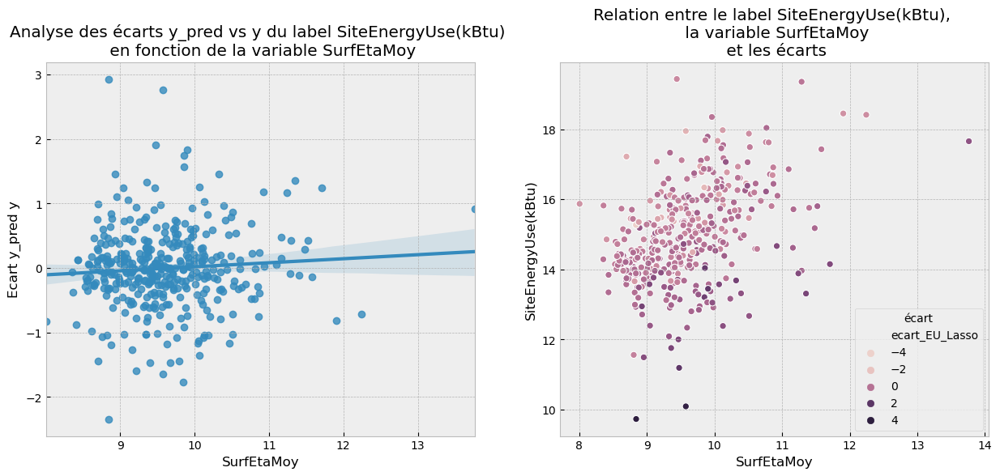

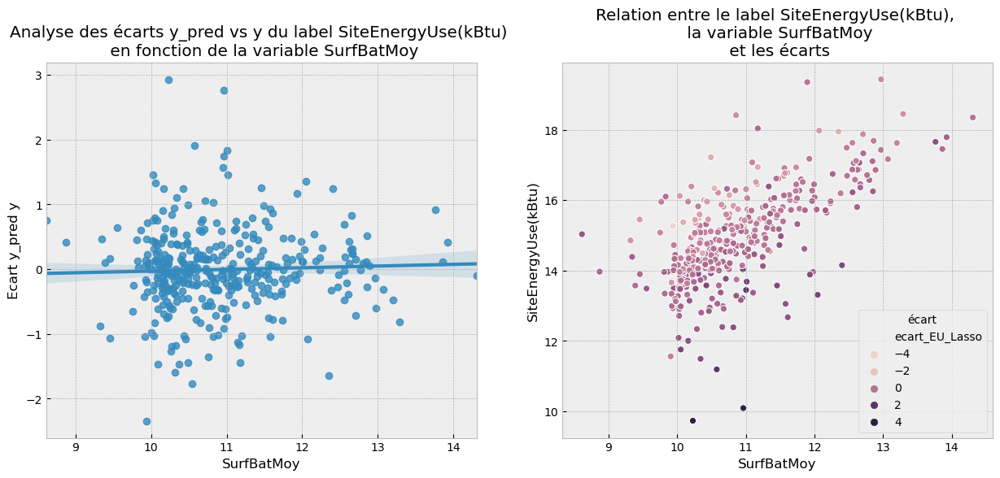

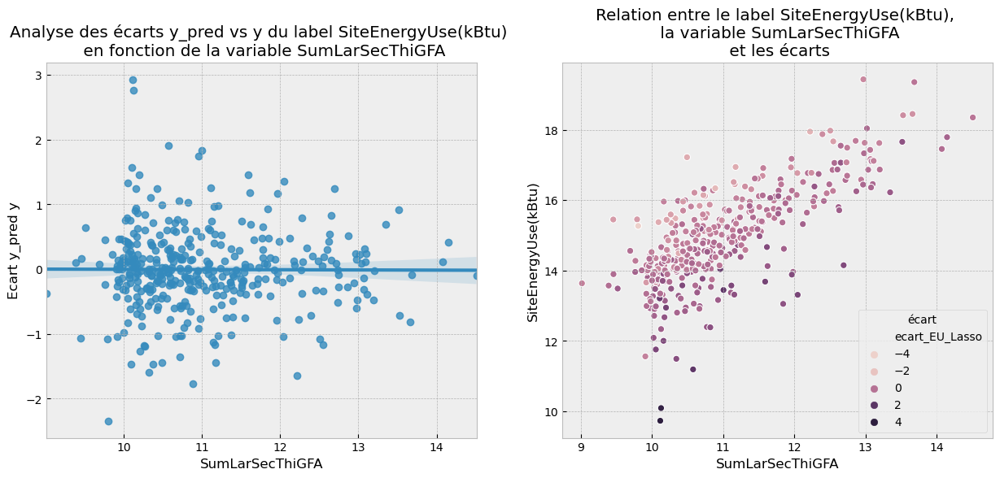

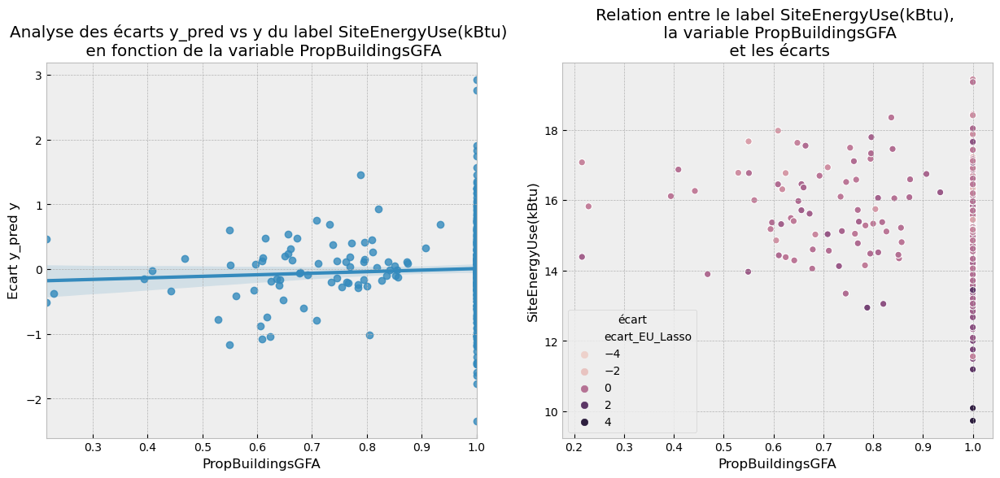

In [30]:
ResEval='ecart_EU_Lasso'
labe='SiteEnergyUse(kBtu)'
for i in DfResid.iloc[:,:-10].select_dtypes(exclude='number').columns :#variables catégorielles
    plt.subplots(2,1,figsize=[15,10])
    plt.subplot(211)
    sns.boxplot(data=DfResid, x=i, y=ResEval, fliersize=0)
    sns.stripplot(data=DfResid, x=i, y=ResEval, linewidth=1)
    plt.xticks([])
    plt.title('Analyse des écarts y_pred vs y du label {} \n en fonction de la variable {}'.format(labe, i))
    plt.ylabel('Ecart y_pred y')
    plt.subplot(212)
    sns.boxplot(data=DfResid, x=i, y=labe, fliersize=0)
    sns.stripplot(data=DfResid, x=i, y=labe, linewidth=1)
    plt.xticks(rotation=90)
    plt.title('Distribution du label {} \n en fonction de la variable {}'.format(labe, i))
    plt.show()
for i in DfResid.iloc[:,:-10].select_dtypes('number').columns : #variables numériques
    plt.subplots(1,2,figsize=[15,6])
    plt.subplot(121)
    sns.regplot(data=DfResid, x=i, y=ResEval)
    plt.title('Analyse des écarts y_pred vs y du label {} \n en fonction de la variable {}'.format(labe, i))
    plt.ylabel('Ecart y_pred y')
    plt.subplot(122)
    sns.scatterplot(data=DfResid, x=i, y=labe, hue=ResEval)
    plt.legend(title='écart')
    plt.title('Relation entre le label {}, \n la variable {}\n et les écarts'.format(labe, i))
    plt.show()

### Barplots avec le classements des variables avec les coefficients les plus élevés/faibles

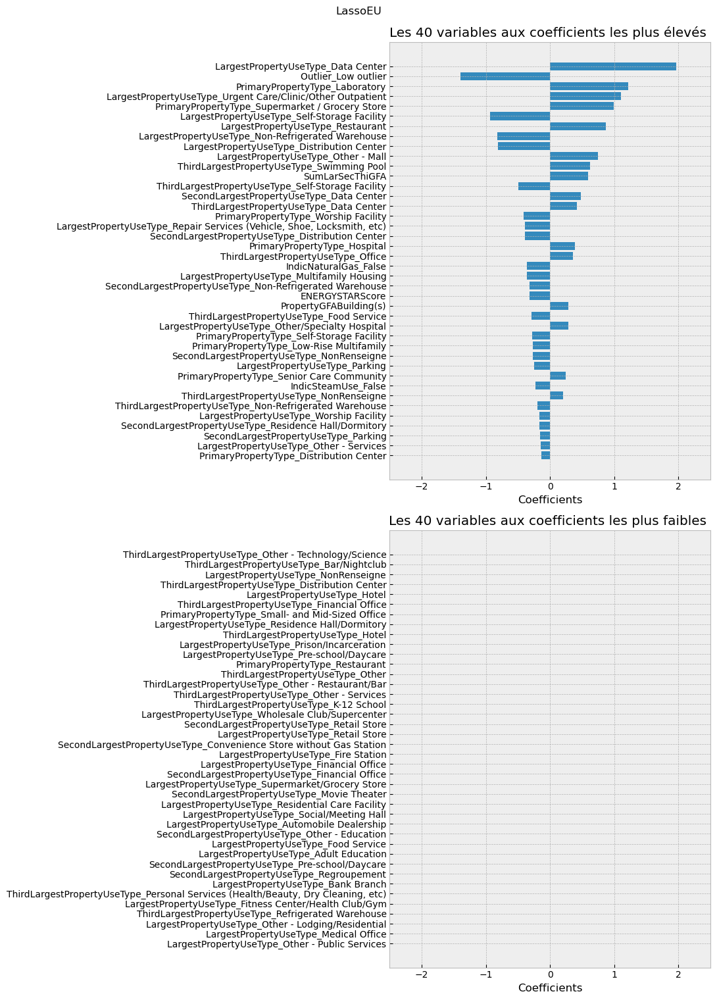

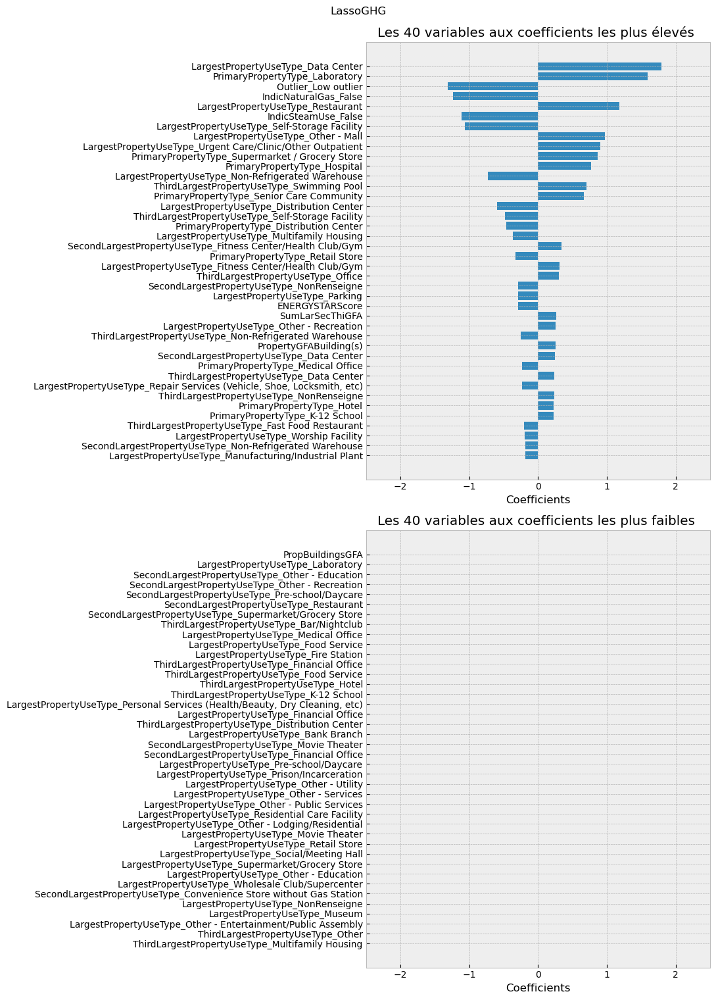

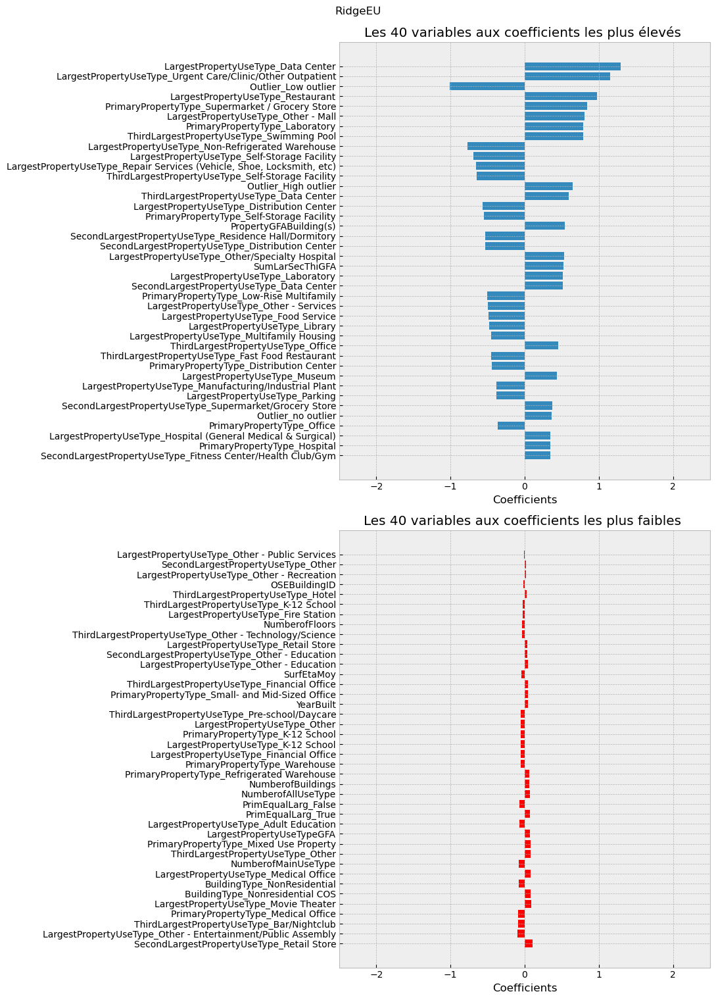

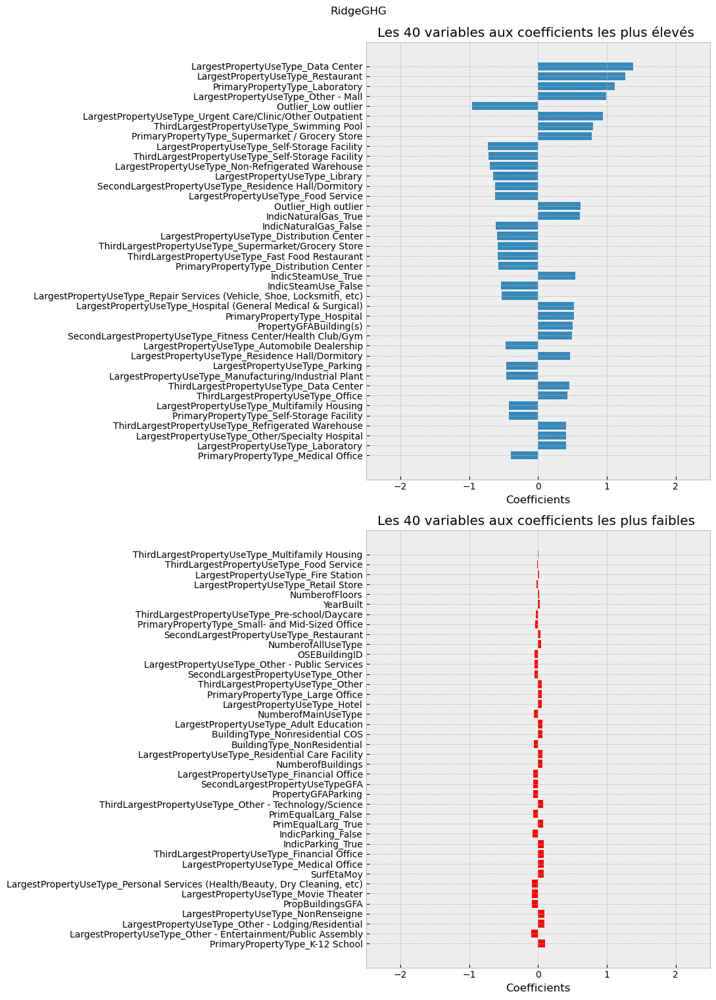

In [31]:
NbVar=40
for j in range(4): #2 tableaux pour chacun des 2 modèles
    DF2=DfCoefs.sort_values(DfCoefs.columns[j+4], ascending=False).head(NbVar)[::-1]
    DF3=DfCoefs.sort_values(DfCoefs.columns[j+4], ascending=False).tail(NbVar)
    plt.subplots(2,1,figsize=[11,15])
    plt.suptitle(DF2.columns[j], y=1.01)
    plt.subplot(211)
    plt.barh(np.arange(0,len(DF2),1),DF2.iloc[:,j])
    plt.yticks(np.arange(0,len(DF2),1), DF2.index)
    plt.xlabel('Coefficients')
    plt.title('Les {} variables aux coefficients les plus élevés '.format(NbVar))
    plt.xlim(-2.5,2.5)
    plt.subplot(212)
    plt.barh(np.arange(0,len(DF3),1),DF3.iloc[:,j], color='r')
    plt.yticks(np.arange(0,len(DF3),1), DF3.index)
    plt.xlim(-2.5,2.5)
    plt.xlabel('Coefficients')
    plt.title('Les {} variables aux coefficients les plus faibles '.format(NbVar))
    plt.tight_layout()
    plt.show()